# Predicting saving behavior with demographic characteristics, psychological characteristics, and situational factors using machine learning models

### ------------------------------------------------------------Thesis in progress------------------------------------------------------------

### Student: Vitali Tsentsiper
### Supervisor: Guy Hochman
### Institution: Reichman University (IDC), M.A Behavioral Economics

### <u>Import libraries</u>

In [6]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import miceforest as mf
import re

#EDA 
import sidetable
import missingno as msno
import shap
from yellowbrick.classifier import ROCAUC
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import precision_recall_curve
from sklearn.preprocessing import label_binarize
from sklearn.impute import KNNImputer

#ML
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier 
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier 
from sklearn import svm
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV
from imblearn.pipeline import Pipeline
from sklearn.tree import DecisionTreeClassifier
from imblearn.over_sampling import RandomOverSampler
from xgboost import XGBClassifier
import lightgbm as lgb
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression

#Metrics classification
from sklearn.metrics import f1_score, recall_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn import metrics

#Regression
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from lightgbm import LGBMRegressor

#Metrics regression
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import r2_score

#ELI5
# from eli5 import show_weights
# from eli5.sklearn import PermutationImportance
# from eli5 import show_prediction

# # Import the LimeTabularExplainer module
# from lime.lime_tabular import LimeTabularExplainer

#PDP
from sklearn.inspection import PartialDependenceDisplay

#Error ignore
import sys
import warnings
if not sys.warnoptions:
    warnings.simplefilter("ignore")

In [7]:
#Function that gets model, feature and target and plot precision recall curve
def pr_curve(model, features, target):
    y_pred_proba = model.predict_proba(features)
    
    Y = label_binarize(target, classes=[1, 2, 3, 4 ,5, 6, 7])
    
    n_classes = len(set(target))

    # precision recall curve
    precision = dict()
    recall = dict()
    plt.figure(figsize = (15,8))
    for i in range(n_classes):
        precision[i], recall[i], _ = precision_recall_curve(Y[:, i], y_pred_proba[:, i])
        plt.plot(recall[i], precision[i], lw=2, label='class {}'.format(i))

    plt.xlabel("recall", size=15)
    plt.ylabel("precision", size=15)
    plt.legend(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'], loc="best")
    plt.title("precision vs. recall curve", size=20)
    plt.show()

In [8]:
#Visualization function for ROC AUC
def plot_ROC_curve(model, xtrain, ytrain, xtest, ytest):

    # Creating visualization with the readable labels
    visualizer = ROCAUC(model, encoder={1: '$0', 
                                        2: '$1-99', 
                                        3: '$100-999',
                                        4: '$1,000-4,999',
                                        5: '$5,000-19,999',
                                        6: '$20,000-74,999',
                                        7: '$75,000 or more'})
    
                                        
    # Fitting to the training data first then scoring with the test data                                    
    visualizer.fit(xtrain, ytrain)
    visualizer.score(xtest, ytest)
    visualizer.show()
    
    return visualizer

In [9]:
#Visualization function for ROC AUC for 3 classes
def plot_ROC_curve_3(model, xtrain, ytrain, xtest, ytest):

    # Creating visualization with the readable labels
    visualizer = ROCAUC(model, encoder={1: 'Low', 
                                        2: 'Mid', 
                                        3: 'High'})
    
                                        
    # Fitting to the training data first then scoring with the test data                                    
    visualizer.fit(xtrain, ytrain)
    visualizer.score(xtest, ytest)
    visualizer.show()
    
    return visualizer

In [10]:
#Function that gets the pipeline, the parameters for pipeline and from GridSearcgCV, features train and target train
#and prints the best parameters, the best score and returns the best fitted model

def best_model(pipeline, parm, x_train, y_train):
    model_grid = GridSearchCV(pipeline, parm, cv=5, verbose=5, refit=True, scoring = 'f1_weighted',return_train_score=True)
    model_grid.fit(x_train, y_train)
    print()
    print('Best parameters:', model_grid.best_params_)
    print()
    print('Best score:', round(model_grid.best_score_,2))
    return model_grid

In [11]:
#Function that gets the pipeline, the parameters for pipeline and from GridSearcgCV, features train and target train
#and prints the best parameters, the best score and returns the best fitted model - bianry for each class

def best_model_binary(pipeline, parm, x_train, y_train):
    model_grid = GridSearchCV(pipeline, parm, cv=5, verbose=5, refit=True, scoring = 'f1',return_train_score=True)
    model_grid.fit(x_train, y_train)
    print()
    print('Best parameters:', model_grid.best_params_)
    print()
    print('Best score:', round(model_grid.best_score_,2))
    return model_grid

In [12]:
#Function that gets the pipeline, the parameters for pipeline and from GridSearcgCV, features train and target train
#and prints the best parameters, the best score and returns the best fitted model - regression

def best_model_regression(pipeline, parm, x_train, y_train):
    model_grid = GridSearchCV(pipeline, parm, cv=5, verbose=5, refit=True, scoring = 'neg_mean_absolute_error',return_train_score=True)
    model_grid.fit(x_train, y_train)
    print()
    print('Best parameters:', model_grid.best_params_)
    print()
    print('Best score:', abs(round(model_grid.best_score_,2)))
    return model_grid

## Part I - preprocessing the data

### <u>Plan</u>

1. Load the original data set
2. Keep only features without data leakedge and replace their names into meaningful names
4. Replace non answered questions with NaN
3. Remove unvalid target variables
6. Check for corerlations between features
3. Split the data into train and test sets
5. Impute missing values

In [13]:
original_data = pd.read_csv('C:/My files/Thesis/Data sets/1 - Financial survey/1 - NFWBS_PUF_2016_data.csv')

In [14]:
#See the data
original_data.head()

,PUF_ID,sample,fpl,SWB_1,SWB_2,SWB_3,FWBscore,FWB1_1,FWB1_2,FWB1_3,...,PPMSACAT,PPREG4,PPREG9,PPT01,PPT25,PPT612,PPT1317,PPT18OV,PCTLT200FPL,finalwt
0,10350,2,3,5,5,6,55,3,3,3,...,1,4,8,0,0,0,0,1,0,0.367292
1,7740,1,3,6,6,6,51,2,2,3,...,1,2,3,0,0,0,0,2,0,1.327561
2,13699,1,3,4,3,4,49,3,3,3,...,1,4,9,0,0,0,1,2,1,0.835156
3,7267,1,3,6,6,6,49,3,3,3,...,1,3,7,0,0,0,0,1,0,1.410871
4,7375,1,3,4,4,4,49,3,3,3,...,1,2,4,0,0,1,0,4,1,4.260668


In [15]:
#Data size
original_data.shape

(6394, 217)

In [16]:
#Upload file with the columns we want to keep and meaningful names 
col_names = pd.read_csv('C:/My files/Thesis/Data sets/1 - Financial survey/columns for ML.csv', encoding='cp1252')

In [17]:
col_names.head()

,Variable Name,Variables for ML
0,SWB_1,I am satisfied with my life
1,SWB_2,I am optimistic about my future
2,SWB_3,"If I work hard today, I will be more successfu..."
3,FWB2_4,My finances control my life
4,FS1_1,I know how to get myself to follow through on ...


In [18]:
#Make list of used variables - original names
variables = list(col_names['Variable Name'])

In [19]:
#Keep only wanted features, without data leakege
data_upd = original_data[variables]

In [20]:
data_upd.head()

,SWB_1,SWB_2,SWB_3,FWB2_4,FS1_1,FS1_2,FS1_3,FS1_4,FS1_5,FS1_6,...,PPHHSIZE,PPINCIMP,PPMARIT,PPREG4,PPREG9,PPT01,PPT25,PPT612,PPT1317,PPT18OV
0,5,5,6,4,3,3,4,3,3,3,...,1,7,3,4,8,0,0,0,0,1
1,6,6,6,3,3,3,3,3,4,3,...,2,6,3,2,3,0,0,0,0,2
2,4,3,4,3,3,3,3,3,3,3,...,3,6,3,4,9,0,0,0,1,2
3,6,6,6,3,3,3,3,3,3,3,...,1,8,3,3,7,0,0,0,0,1
4,4,4,4,3,3,3,3,3,3,3,...,5,7,1,2,4,0,0,1,0,4


We kept 161 columns

In [21]:
data_upd.shape

(6394, 161)

In [22]:
#Make list of used meaningful names
names = list(col_names['Variables for ML'])

In [23]:
#Create dictinary
col_rename_dict = {i:j for i,j in zip(variables,names)}

#Update names
data_upd = data_upd.rename(columns=col_rename_dict)

In [24]:
data_upd.head()

,I am satisfied with my life,I am optimistic about my future,"If I work hard today, I will be more successful in the future",My finances control my life,I know how to get myself to follow through on my financial intentions,I know where to find the advice I need to make decisions involving money,I know how to make complex financial decisions,I am able to make good financial decisions that are new to me,I am able to recognize a good financial investment,I know how to keep myself from spending too much,...,Household Size,Household Income,Marital Status,Census Region,Census Division,Presence of Household Members - Children 0-1,Presence of Household Members - Children 2-5,Presence of Household Members - Children 6-12,Presence of Household Members - Children 13-17,Presence of Household Members - Adults 18+
0,5,5,6,4,3,3,4,3,3,3,...,1,7,3,4,8,0,0,0,0,1
1,6,6,6,3,3,3,3,3,4,3,...,2,6,3,2,3,0,0,0,0,2
2,4,3,4,3,3,3,3,3,3,3,...,3,6,3,4,9,0,0,0,1,2
3,6,6,6,3,3,3,3,3,3,3,...,1,8,3,3,7,0,0,0,0,1
4,4,4,4,3,3,3,3,3,3,3,...,5,7,1,2,4,0,0,1,0,4


## EDA

EDA - Exploratory data analysis to recognize patterns and see trends. As we are not trying to find causality we won't be able to say whether change in savings is due to financial behavior, or larger amount of savings enables better financial behavior. We are relying on literature to understand this behavior.

In [25]:
# Change "How much money do you have in savings today...?" to "target"
data_upd.rename(columns={'How much money do you have in savings today...?': 'target'},inplace=True)

In [26]:
#See what values we see in the target variables
data_upd['target'].value_counts()

 5     1093
 99     988
 4      931
 6      845
 7      834
 3      682
 1      440
 2      385
 98     158
-1       38
Name: target, dtype: int64

99 Prefer not to say<br>
98 I don't know<br>
-1 Refused<br>
-2 Question not asked because respondent not in item base<br>
-3 Invalid response<br>
-4 Response not written to database<br>
-5 County not known<br>

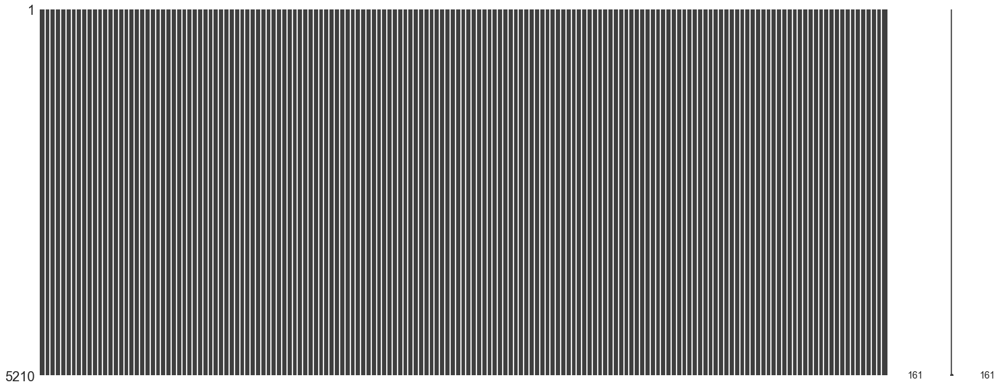

In [27]:
#Replace the unwanted answers with NaN
data_upd['target'] = data_upd['target'].replace([99,98,-1,-2, -3,-4,-5], np.nan)

#Drop NaN in target
data_final = data_upd.dropna(subset=['target'])


#See missing values
msno.matrix(data_final);

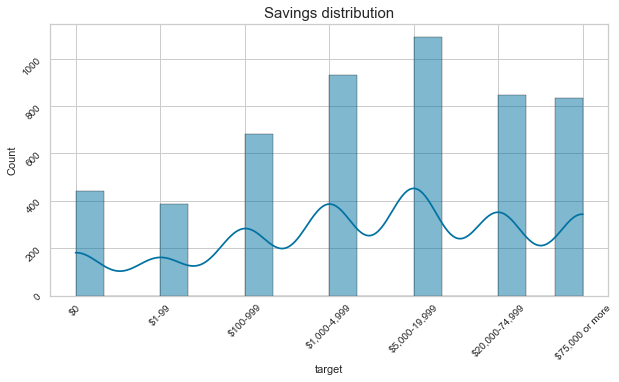

In [28]:
fig, ax = plt.subplots(figsize=(10, 5))
sns.histplot(data_upd['target'], kde=True, ax=ax)
ax.set_xticks(range(1,8))
ax.set_xticklabels(['$0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
ax.tick_params(rotation=45)
plt.title('Savings distribution', size=15)
plt.show()

### Income

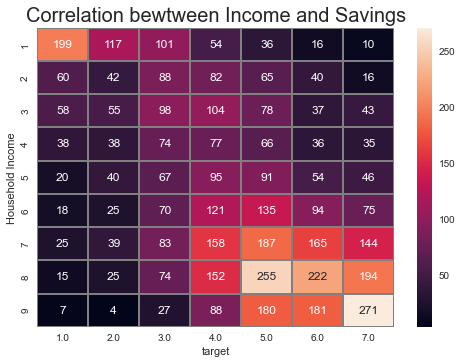

In [29]:
sns.heatmap(data_upd.groupby(['Household Income','target'])['target'].count().unstack(),
            linewidths=.01,linecolor='gray',annot=True,fmt='g')
           
plt.title('Correlation bewtween Income and Savings', size=20)
plt.show()

We see clear patternt between households income and savings amounts.

### Age

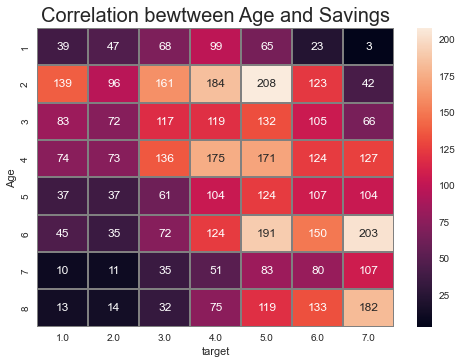

In [30]:
sns.heatmap(data_upd.groupby(['Age','target'])['target'].count().unstack(),
            linewidths=.01,linecolor='gray',annot=True,fmt='g')
           
plt.title('Correlation bewtween Age and Savings', size=20)
plt.show()

Age is much less correlated with savings, but we can see some wide trend.

In [31]:
#Look for column name with credit:
[col for col in data_upd.columns if 'credit' in col]

['Paid off credit card balance in full each month',
 'actual understanding of credit card minimum payments',
 'Checking or Savings Account at a bank or credit union',
 'Discussed how to establish a good credit rating']

## Purchase behavior

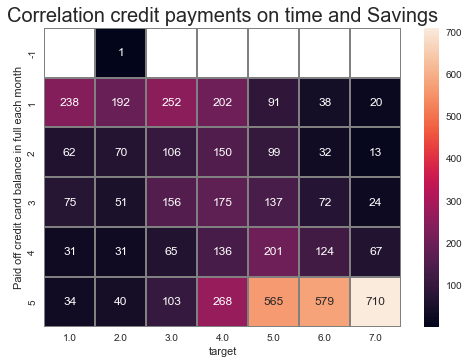

In [32]:
sns.heatmap(data_upd.groupby(['Paid off credit card balance in full each month','target'])['target'].count().unstack(),
            linewidths=.01,linecolor='gray',annot=True,fmt='g')
           
plt.title('Correlation credit payments on time and Savings', size=20)
plt.show()

We see strong patterns for edges - people never pay credit on time (1) typically have less savings, while poeple who always pay on time (5) typically have high savings.

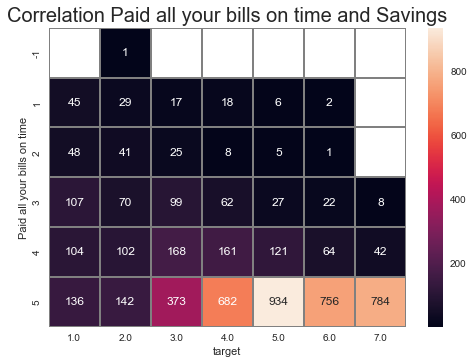

In [33]:
sns.heatmap(data_upd.groupby(['Paid all your bills on time','target'])['target'].count().unstack(),
            linewidths=.01,linecolor='gray',annot=True,fmt='g')
           
plt.title('Correlation Paid all your bills on time and Savings', size=20)
plt.show()

### Planning horizon

In [34]:
#Look for column name with credit:
[col for col in data_upd.columns if 'hori' in col]

['Financial planning time horizon']

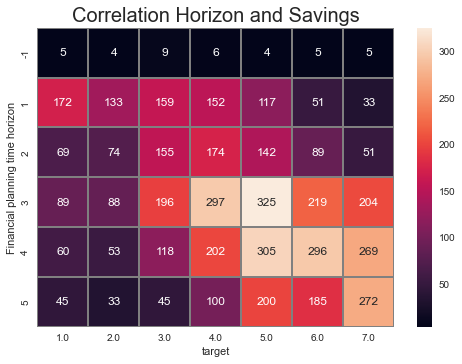

In [35]:
sns.heatmap(data_upd.groupby(['Financial planning time horizon','target'])['target'].count().unstack(),
            linewidths=.01,linecolor='gray',annot=True,fmt='g')
           
plt.title('Correlation Horizon and Savings', size=20)
plt.show()

Also here we see the paternt of higher horizon correlated with higher savings.

We see that people who paid all bills on time have more savings.

### Income volatility (uncertainity)

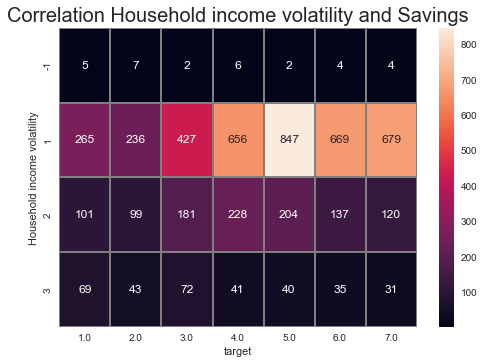

In [36]:
sns.heatmap(data_upd.groupby(['Household income volatility','target'])['target'].count().unstack(),
            linewidths=.01,linecolor='gray',annot=True,fmt='g')
           
plt.title('Correlation Household income volatility and Savings', size=20)
plt.show()

We see that most of the participents have low income volaitlity, but it seems that people with high income volatility have less savings.

### Materialism

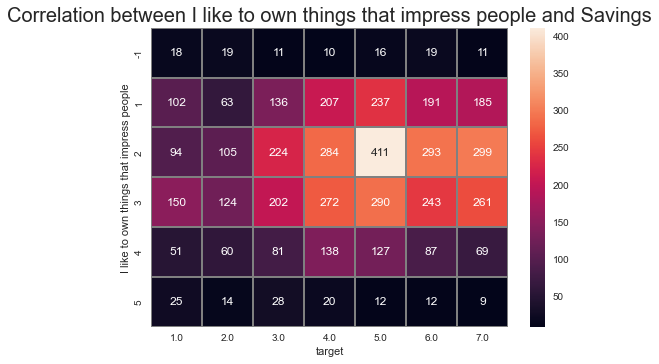

In [37]:
sns.heatmap(data_upd.groupby(['I like to own things that impress people','target'])['target'].count().unstack(),
            linewidths=.01,linecolor='gray',annot=True,fmt='g')
           
plt.title('Correlation between I like to own things that impress people and Savings', size=20)
plt.show()

We see that people who are strongly agree with this statment ("I like to own things that impress people") have less savings.

In [38]:
#Look for column name with credit:
[col for col in data_upd.columns if 'The things I own' in col]

['The things I own say a lot about how well I’m doing in life']

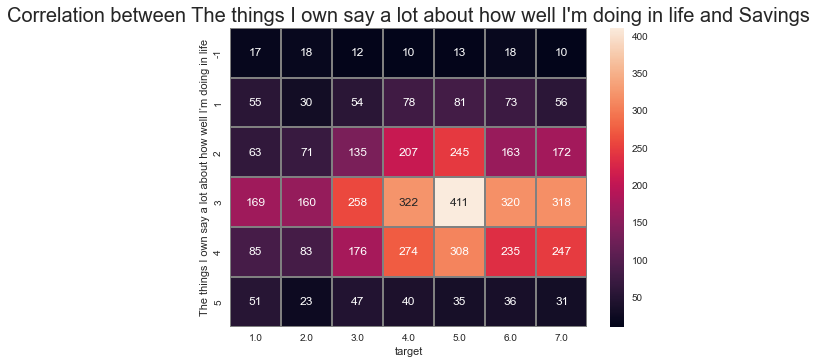

In [39]:
sns.heatmap(data_upd.groupby(["The things I own say a lot about how well I’m doing in life",'target'])['target'].count().unstack(),
            linewidths=.01,linecolor='gray',annot=True,fmt='g')
           
plt.title("Correlation between The things I own say a lot about how well I'm doing in life and Savings", size=20)
plt.show()

Also here, people who strongly agree with materialism have less savings, althog seems that people who agree, tend to have more savings. This statment might be just a reasonable statement and not how people live the statement above.

### Locus of control

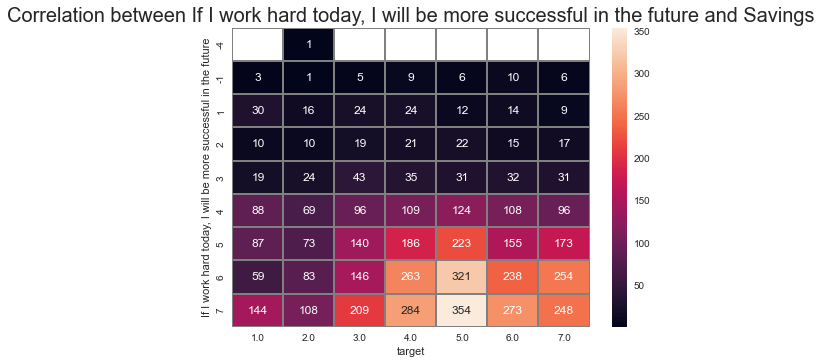

In [40]:
sns.heatmap(data_upd.groupby(["If I work hard today, I will be more successful in the future",'target'])['target'].count().unstack(),
            linewidths=.01,linecolor='gray',annot=True,fmt='g')
           
plt.title("Correlation between If I work hard today, I will be more successful in the future and Savings", size=20)
plt.show()

We see high correlation between people who belive in their hard work and savings amount.

### Unemployment situation

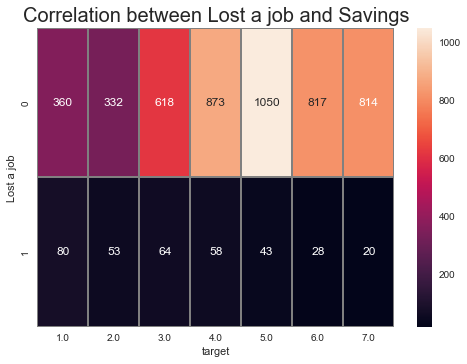

In [41]:
sns.heatmap(data_upd.groupby(["Lost a job",'target'])['target'].count().unstack(),
            linewidths=.01,linecolor='gray',annot=True,fmt='g')
           
plt.title("Correlation between Lost a job and Savings", size=20)
plt.show()

We see that people who had unemployment shock in the last year have less savings, altough they are small portion of the sample.

### Psychological connectedness

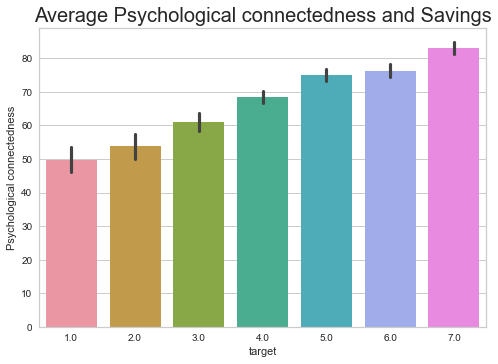

In [42]:
sns.barplot(data = data_upd, x = 'target', y = 'Psychological connectedness')

plt.title("Average Psychological connectedness and Savings", size=20)
plt.show()

**The question:** Please think about the important characteristics that make you the person you are now – your personality, temperament, major likes and dislikes, beliefs, values, ambitions, life goals, and ideals – and please rate the degree of connectedness between the person you expect to be in 5 years compared to the person you are now, where 0 means “I will be completely different in the future” and 100 means “I will be exactly the same in the future.”

**Conclusion:** We see connection between the savings amount to the extent people believe they will stay the same. At the situation is better people belive it will lest, as the situation is worst, people believe they will change.

# Initial model experiment

First we will try to predict the target with the unwanted valuse, as they are represented in very specific coding:<br>
    
99 Prefer not to say<br>
98 I don't know<br>
-1 Refused<br>
-2 Question not asked because respondent not in item base<br>
-3 Invalid response<br>
-4 Response not written to database<br>
-5 County not known<br>

In [43]:
data_final.shape

(5210, 161)

In [44]:
print('We droped',len(original_data) - len(data_final),'observations with unvalid answers')

We droped 1184 observations with unvalid answers


### Check correlations

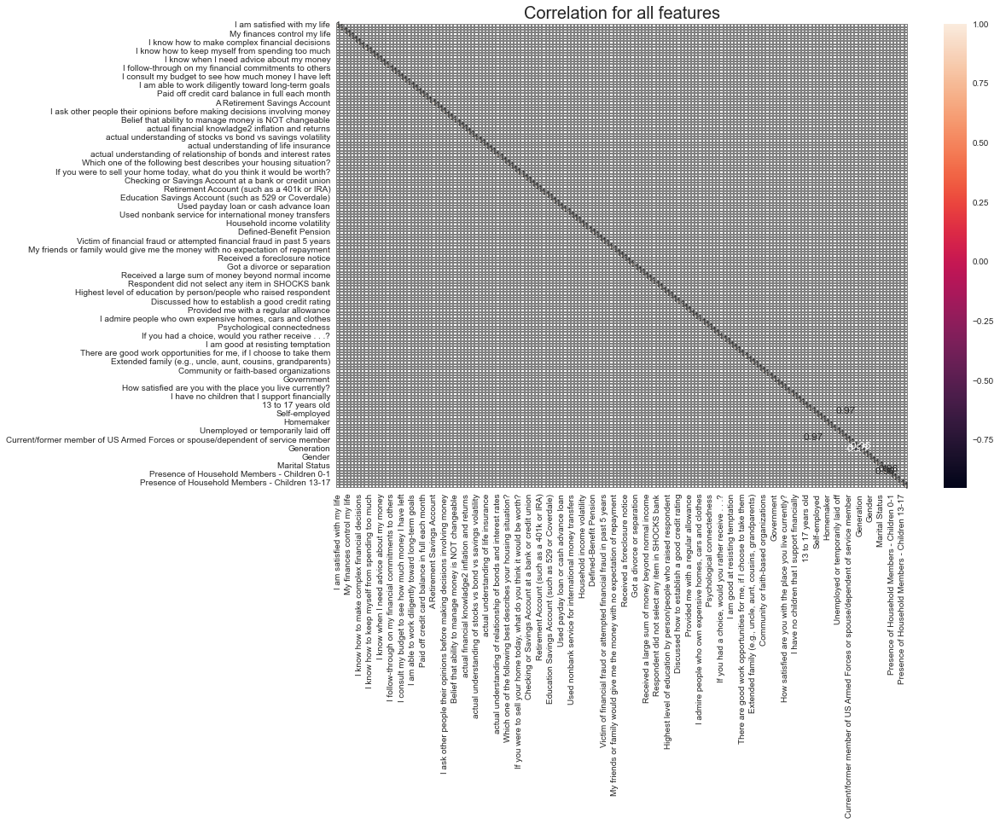

In [45]:
fig, ax = plt.subplots(figsize=(15,10))
sns.heatmap(data_final.corr()[(data_final.corr()>0.9) | (data_final.corr()<-0.9)], ax=ax, 
            linewidths=.01,linecolor='gray',annot=True)
plt.title('Correlation for all features', size=20)
plt.show()

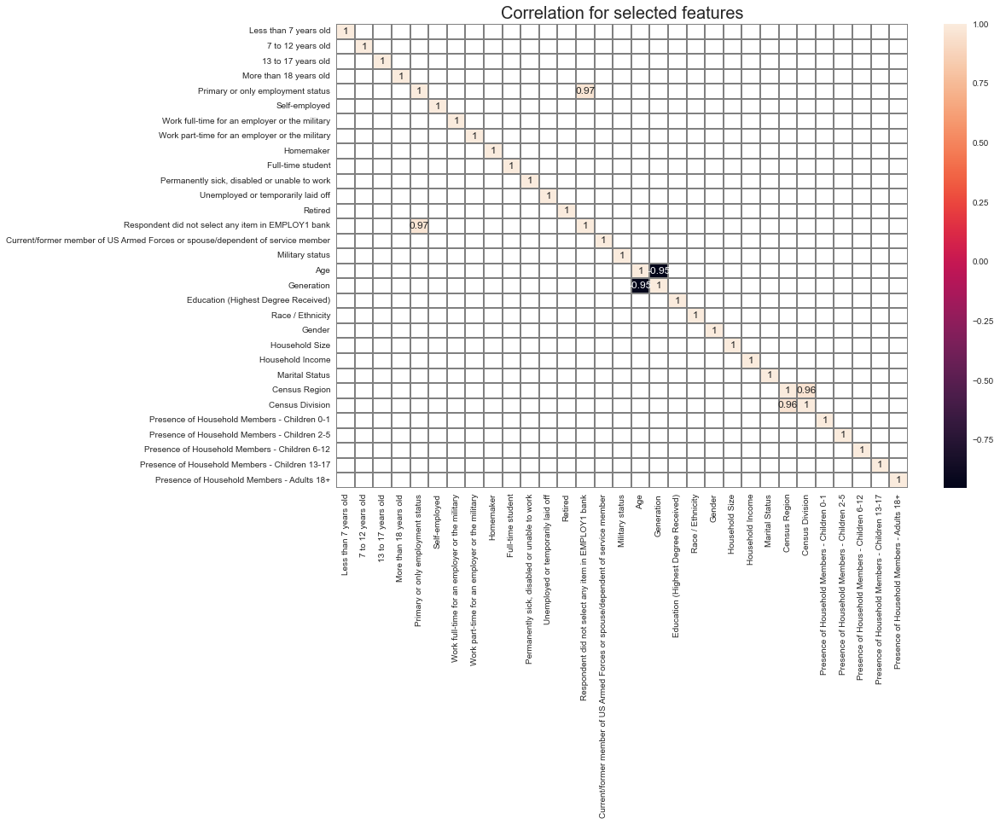

In [46]:
#Zoom in
fig, ax = plt.subplots(figsize=(15,10))
sns.heatmap(data_final[data_final.columns[130:162]].corr()[(data_final[data_final.columns[130:162]].corr()>0.9) | (data_final[data_final.columns[130:162]].corr()<-0.9)], ax=ax, 
            linewidths=.01,linecolor='gray',annot=True)
plt.title('Correlation for selected features', size=20)
plt.show()

We see high correlation between:<br>
1. Work status not reported and Primary or only employment status: 97%. Work status are question asked and recorded as dummy variables which are later converted into new columns - Primary or only employment status. Work status questions should be removed.
2. Age and Generation: -95%. Age categories are represented by generation. We can remove this column without loosing any new infornation.
3. Census region and census division 96%. Division is more elaborated variable. Census region should be removed.

In [47]:
#Remove correlated file
data_final.drop(['Primary or only employment status','Self-employed','Work full-time for an employer or the military',
                 'Work part-time for an employer or the military','Homemaker','Full-time student',
                'Permanently sick, disabled or unable to work','Unemployed or temporarily laid off',
                'Retired','Respondent did not select any item in EMPLOY1 bank','Generation', 'Census Region'], axis=1, inplace=True)

### Split the data

We will split the data into train (80%) and test (20%) sets and run cross validation on the train set.

In [48]:
target_all = data_final['target']
features_all = data_final.drop(['target'], axis=1)

#split into 80% (will be used with cross validation) train and 20% test
features_train_all, features_test_all, target_train_all, target_test_all = train_test_split(features_all, target_all, test_size=0.2, random_state=42)

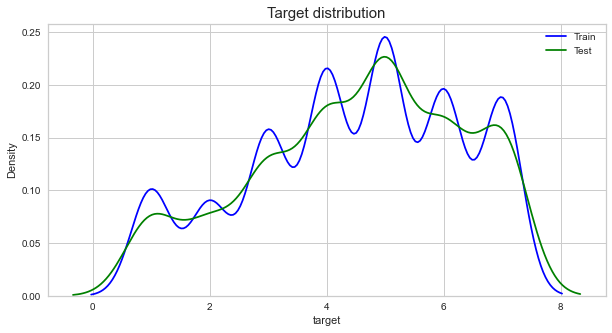

In [49]:
#See target distribution between groups

fig, axs = plt.subplots(figsize=(10, 5))
sns.kdeplot(data=target_train_all, ax=axs, color='blue', label='Train')
sns.kdeplot(data=target_test_all, ax=axs, color='green', label='Test')
plt.title('Target distribution', size=15)
plt.legend()
plt.show()

Our data is not balanced but normaly distributed, there is no clear majority/minority group.

### Random Forest

In [50]:
rf = RandomForestClassifier(random_state=42)
rf.fit(features_train_all, target_train_all)

RandomForestClassifier(random_state=42)

In [51]:
y_pred_full = rf.predict(features_test_all)

In [52]:
print(classification_report(target_test_all, y_pred_full, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.42      0.48      0.45        83
          $1-99       0.15      0.05      0.08        74
       $100-999       0.28      0.26      0.27       133
   $1,000-4,999       0.34      0.42      0.38       180
  $5,000-19,999       0.35      0.41      0.38       236
 $20,000-74,999       0.31      0.20      0.24       165
$75,000 or more       0.46      0.54      0.50       171

       accuracy                           0.36      1042
      macro avg       0.33      0.34      0.33      1042
   weighted avg       0.34      0.36      0.35      1042



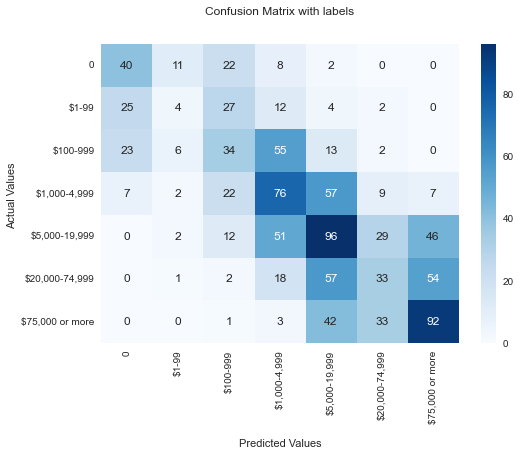

In [53]:
#confusion_matrix
conf= confusion_matrix(target_test_all, y_pred_full)

ax = sns.heatmap(conf, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.set_xticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
ax.set_yticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

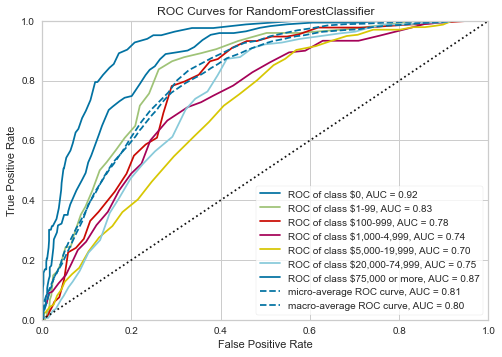

In [54]:
visual_1 = plot_ROC_curve(rf, features_train_all, target_train_all, features_test_all, target_test_all)

Separability of the classes by all possible thresholds - how good the classes can be separated using their predicted probabilities. If most of my 1 classes have the probability of 95%, and all 0 classes have 100-95%=5%, the AUC will be very high. If on the other hand we have large range of probabilities to 1 and 0, the AUC will be low.

**TPR (True Positive Rate) / Recall /Sensitivity**: TP/(TP+FN) <br>
What is the rate of true positive of all actual positive. If we class all into 1, we will have 100% TPR, because we will have no FN, we won't class anything to negative. But we will have many false positive.<br>

**FPR (False Positive Rate)**: FP/(FP+TN)<br>
What is the rate of false positive of all negatives.<br>

**Precision**: TP/(TP+FP). Predicted correctly true positive out of all predictions of true positive.<br>

OVR - One vs Rest methodology: When AUC is 0.92, it means there is a 92% chance that the model will be able to distinguish between a class vs all others.<br>

The ROC AUC exemines what would happened if I change the treshold to all possible probabilities.

We use it when we want to rank predictions.

**Can't be used when the data is imbalanced as false positive will be pulled down due to large number of true negative - mosre data will be labled as negative and because it is imbalanced it will be correct. In our case One vs Rest is highly imbalanced what makes the results seem to be better than they are. The curve shows us how good the clasiffier would work if it was binary in different tresholds.**

### Precision Recall Curve

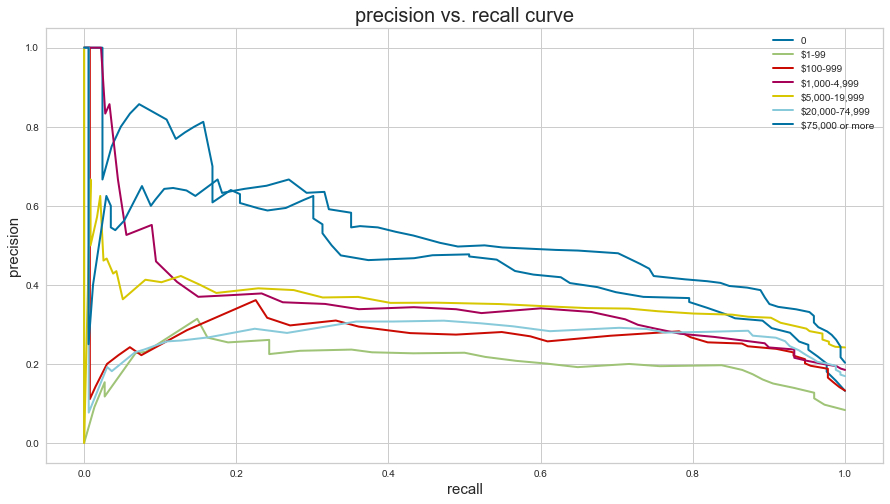

In [55]:
y_pred_full_proba = rf.predict_proba(features_test_all)

Y = label_binarize(target_test_all, classes=[1, 2, 3, 4 ,5, 6, 7])

n_classes = len(set(target_test_all))

# precision recall curve
precision = dict()
recall = dict()
plt.figure(figsize = (15,8))
for i in range(n_classes):
    precision[i], recall[i], _ = precision_recall_curve(Y[:, i], y_pred_full_proba[:, i])
    plt.plot(recall[i], precision[i], lw=2, label='class {}'.format(i))
    
plt.xlabel("recall", size=15)
plt.ylabel("precision", size=15)
plt.legend(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'], loc="best")
plt.title("precision vs. recall curve", size=20)
plt.show()

Here we see that the results are more reliable. We can get high precision (to recognize the correct class, but miss many), or recognize the class but have many mistakes.

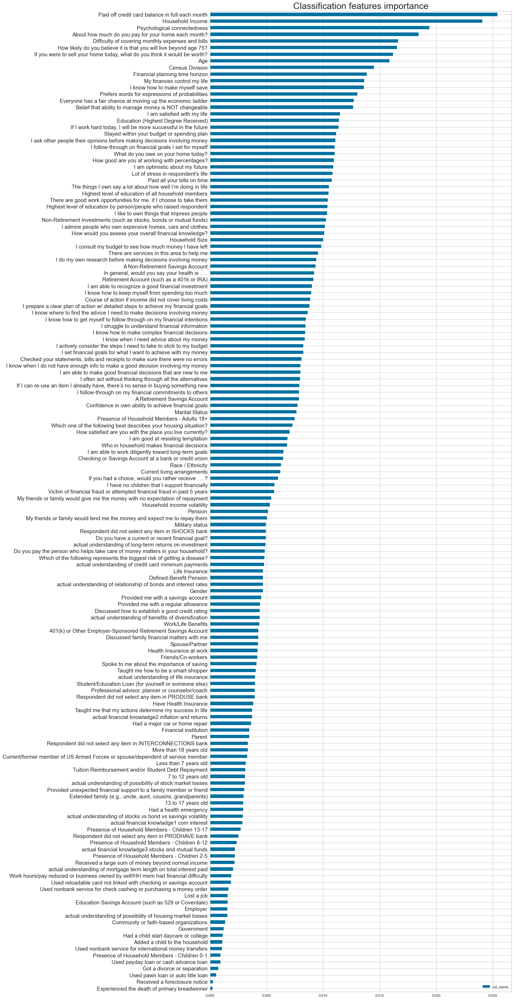

In [56]:
feature_importance_model_full = pd.DataFrame({'col_name': rf.feature_importances_}, index=features_train_all.columns).sort_values(by='col_name', ascending=False)

fig, ax = plt.subplots(figsize =(15, 50))
feature_importance_model_full.sort_values(by='col_name',ascending=True).plot(kind='barh', ax=ax)
plt.title('Classification features importance', size=25)
ax.tick_params(axis='y', labelsize=15)
plt.show()

## Run model on feature with filled values

### Replace unanswered values with NaN

In [57]:
#Replace answers with None values:

#99 Prefer not to say
#98 I don't know
#-1 Refused
#-2 Question not asked because respondent not in item base
#-3 Invalid response
#-4 Response not written to database
#-5 County not known
data_final = data_final.replace([99,98,-1,-2, -3,-4,-5], np.nan)

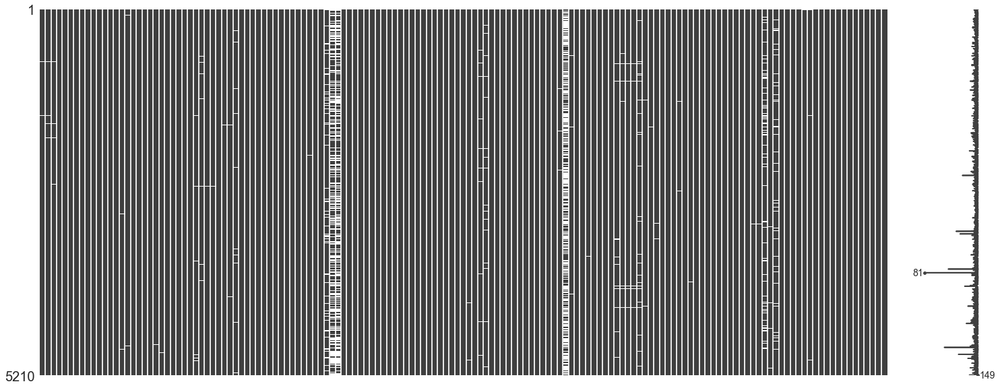

In [58]:
#See missing values
msno.matrix(data_final);

In [59]:
data_final.shape

(5210, 149)

In [60]:
print('We droped',len(original_data) - len(data_final),'observations with unvalid answers')

We droped 1184 observations with unvalid answers


### Check for missing values in the features

In [63]:
#Check for missing values
data_final.stb.missing(style=True)

ImportError: Missing optional dependency 'Jinja2'. DataFrame.style requires jinja2. Use pip or conda to install Jinja2.

As we have many missing values and many columns, we will zoom into the main columns to understand how to complete them.

**Missing completely at Random (MCAR):** The probability for missing observation is the same for all.<br><br>
**Missing not at random (MNAR):** There is a reason for the missing values which is related to other observation in the data or any missing value. <br><br>
**Missing at random (MAR):** there is a reason for the missing data which is related to other missing data.

### consulting

In [64]:
data_upd['Do you pay the person who helps take care of money matters in your household?'].value_counts(normalize=True)

-2    0.517673
 0    0.447764
 1    0.033782
-1    0.000782
Name: Do you pay the person who helps take care of money matters in your household?, dtype: float64

For consulting, we see this question wasn't asked for people who answered that they are the one who are managing their own finances, and not somebody else. This means they are of cource not paying for consulting. We will complete this data with 0: Do you pay the person who helps take care of money matters in your household? No.

In [65]:
#Consulting - fill missing values with 0
data_final['Do you pay the person who helps take care of money matters in your household?'].fillna(0, inplace=True)

### mortgage amount

In [66]:
data_upd['What do you owe on your home today?'].value_counts(normalize=True)

-2     0.348764
 1     0.236472
 2     0.212856
 3     0.097279
 99    0.077886
 98    0.017986
-1     0.008758
Name: What do you owe on your home today?, dtype: float64

For mortgage amount, we see this question wasn't asked for most of the participants when wasn't relevant, but some didn't know or prefered not to asnwer. For these people we will complete the missing value with 1.<br>
What do you owe on your home today? 1. Less than $50,000. because this also means 0, no mortgage.

In [67]:
#Mortgage - fill missing values with 1
data_final['What do you owe on your home today?'].fillna(1, inplace=True)

### home value

In [68]:
data_upd['If you were to sell your home today, what do you think it would be worth?'].value_counts(normalize=True)

-2     0.348764
 2     0.164686
 1     0.161871
 3     0.154989
 4     0.125743
 99    0.024867
 98    0.017986
-1     0.001095
Name: If you were to sell your home today, what do you think it would be worth?, dtype: float64

For home value, we see this question wasn't asked for most of the participants when wasn't relevant, but some didn't know or prefered not to asnwer. <br>
For this question we will use the imputer as the value of the house people live in, regardless of owning the house, will indicate about their financial capabilities.

## Check missing values after manual completion

In [69]:
#Check for missing values
data_final.stb.missing(style=True)

ImportError: Missing optional dependency 'Jinja2'. DataFrame.style requires jinja2. Use pip or conda to install Jinja2.

## Check correlations

In [70]:
data_final.shape

(5210, 149)

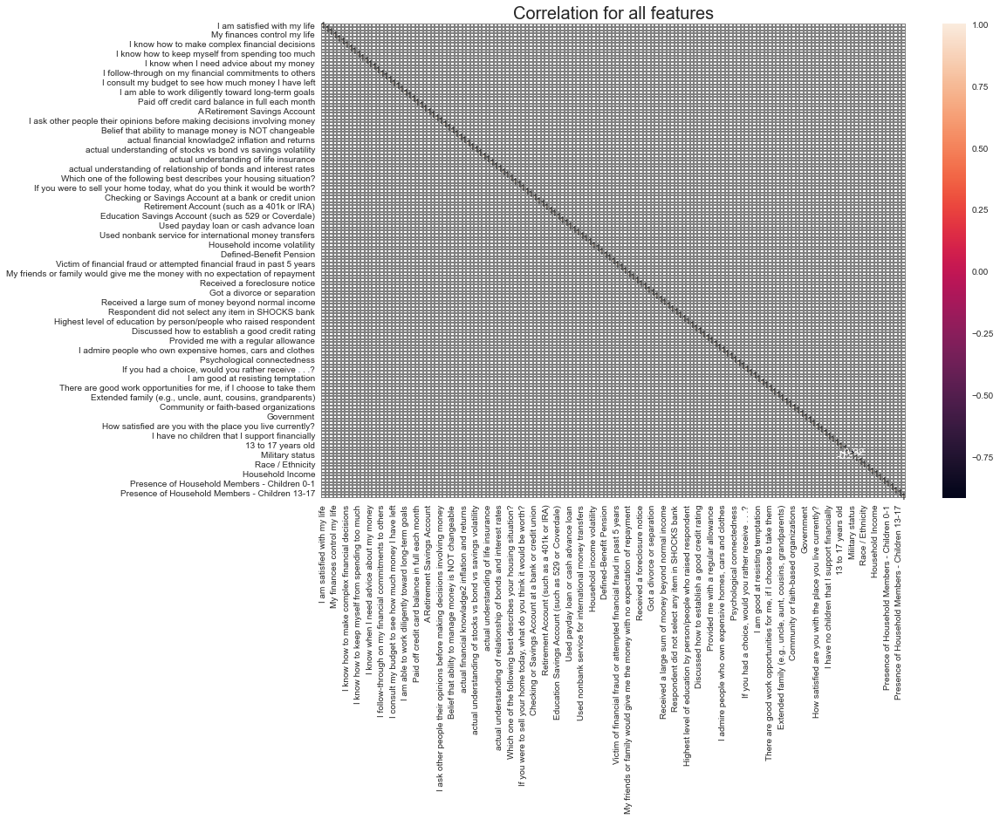

In [71]:
fig, ax = plt.subplots(figsize=(15,10))
sns.heatmap(data_final.corr()[(data_final.corr()>0.9) | (data_final.corr()<-0.9)], ax=ax, 
            linewidths=.01,linecolor='gray',annot=True)
plt.title('Correlation for all features', size=20)
plt.show()

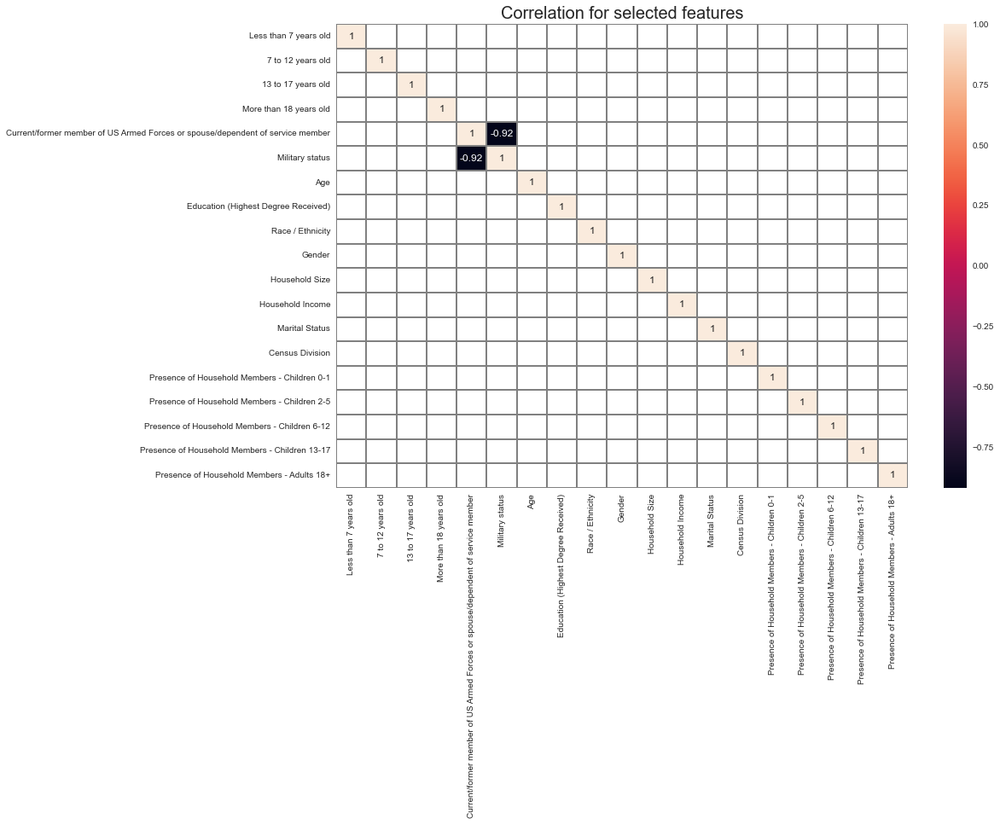

In [72]:
fig, ax = plt.subplots(figsize=(15,10))
sns.heatmap(data_final[data_final.columns[130:162]].corr()[(data_final[data_final.columns[130:162]].corr()>0.9) | (data_final[data_final.columns[130:162]].corr()<-0.9)], ax=ax, 
            linewidths=.01,linecolor='gray',annot=True)
plt.title('Correlation for selected features', size=20)
plt.show()

We see high correlation between:<br>
1. Military status and Current/former member of US Armed Forces or spouse/dependent of service member: 92%. Military Feature is constructed using Current/former member of US Armed Forces or spouse/dependent of service member and age. We will keep them both.

## Split the data

We will split the data into train (80%) and test (20%) sets and run cross validation on the train set.

In [73]:
target = data_final['target']
features = data_final.drop(['target'], axis=1)

#split into 80% (will be used with cross validation) train and 20% test
features_train, features_test, target_train, target_test = train_test_split(features, target, test_size=0.2, random_state=42)

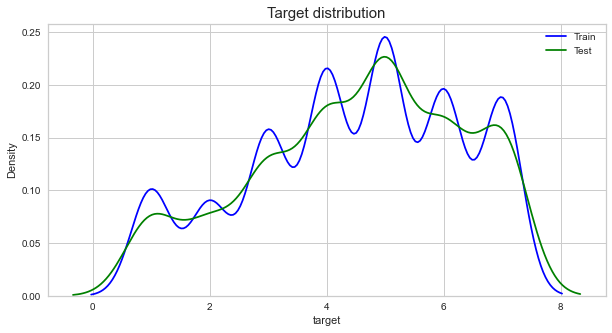

In [74]:
#See target distribution between groups

fig, axs = plt.subplots(figsize=(10, 5))
sns.kdeplot(data=target_train, ax=axs, color='blue', label='Train')
sns.kdeplot(data=target_test, ax=axs, color='green', label='Test')
plt.title('Target distribution', size=15)
plt.legend()
plt.show()

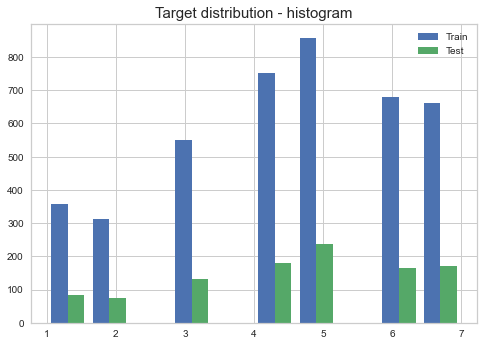

In [75]:
plt.style.use('seaborn-deep')
plt.hist([target_train, target_test], label=['Train', 'Test'])
plt.legend(loc='upper right')
plt.title('Target distribution - histogram', size=15)
plt.show()

Our data is not balanced - we will upsample it later.

In [76]:
#Remove all spaces and signs in the column names to be able process the data
features_train_full = features_train.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '_', x))

In [77]:
#Remove all spaces and signs in the column names to be able process the data - test set
features_test_full = features_test.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '_', x))

In [78]:
features_train_full.head()

,I_am_satisfied_with_my_life,I_am_optimistic_about_my_future,If_I_work_hard_today_I_will_be_more_successful_in_the_future,My_finances_control_my_life,I_know_how_to_get_myself_to_follow_through_on_my_financial_intentions,I_know_where_to_find_the_advice_I_need_to_make_decisions_involving_money,I_know_how_to_make_complex_financial_decisions,I_am_able_to_make_good_financial_decisions_that_are_new_to_me,I_am_able_to_recognize_a_good_financial_investment,I_know_how_to_keep_myself_from_spending_too_much,...,Gender,Household_Size,Household_Income,Marital_Status,Census_Division,Presence_of_Household_Members_Children_0_1,Presence_of_Household_Members_Children_2_5,Presence_of_Household_Members_Children_6_12,Presence_of_Household_Members_Children_13_17,Presence_of_Household_Members_Adults_18_
5085,7.0,7.0,7.0,3.0,4.0,4.0,4.0,4.0,4.0,4.0,...,1.0,5.0,7.0,1.0,8.0,0.0,1.0,1.0,1.0,3.0
1080,5.0,5.0,5.0,4.0,3.0,4.0,4.0,4.0,4.0,4.0,...,1.0,5.0,7.0,3.0,9.0,0.0,1.0,0.0,1.0,3.0
3873,6.0,6.0,6.0,3.0,4.0,4.0,4.0,4.0,4.0,4.0,...,2.0,4.0,8.0,1.0,3.0,0.0,0.0,1.0,0.0,2.0
55,6.0,6.0,6.0,3.0,4.0,4.0,4.0,3.0,3.0,4.0,...,2.0,1.0,5.0,4.0,3.0,0.0,0.0,0.0,0.0,1.0
2057,6.0,6.0,6.0,2.0,3.0,4.0,3.0,4.0,3.0,4.0,...,1.0,3.0,9.0,1.0,9.0,1.0,0.0,0.0,0.0,2.0


## Fill missing values using KNN Imputer 

In [79]:
#We will use only 1 neighbor to make sure categorical values remain the same
imputer_knn = KNNImputer(n_neighbors=1)

### Train data imputation

In [80]:
features_train_knn = pd.DataFrame(np.round(imputer_knn.fit_transform(features_train_full)), columns = features_train_full.columns, index=features_train_full.index)

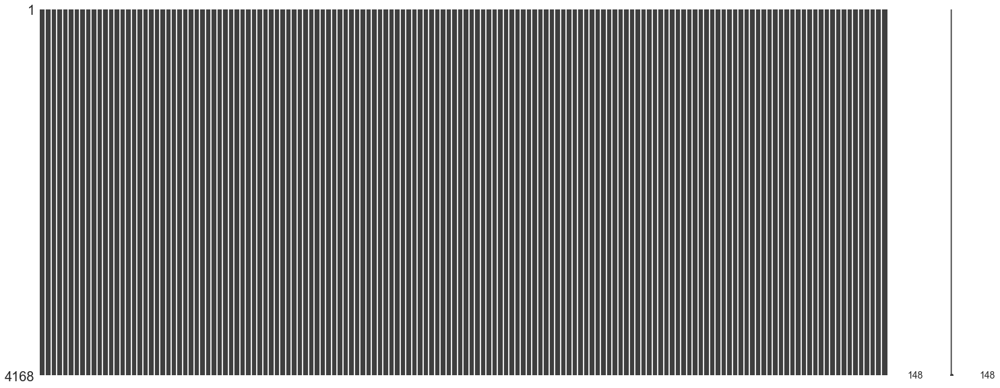

In [81]:
msno.matrix(features_train_knn);

### Test data imputation

In [82]:
features_test_knn = pd.DataFrame(np.round(imputer_knn.transform(features_test_full)), columns = features_test_full.columns, index=features_test_full.index)

### Run Random Forest model for comparison

In [83]:
model_rf_knn = RandomForestClassifier(random_state=42)
model_rf_knn.fit(features_train_knn, target_train)

RandomForestClassifier(random_state=42)

In [84]:
y_pred = model_rf_knn.predict(features_test_knn)

print(classification_report(target_test, y_pred, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.46      0.52      0.49        83
          $1-99       0.45      0.18      0.25        74
       $100-999       0.26      0.21      0.23       133
   $1,000-4,999       0.33      0.43      0.37       180
  $5,000-19,999       0.37      0.44      0.41       236
 $20,000-74,999       0.27      0.15      0.19       165
$75,000 or more       0.51      0.61      0.55       171

       accuracy                           0.38      1042
      macro avg       0.38      0.36      0.36      1042
   weighted avg       0.37      0.38      0.36      1042



### Fill missing values using MICE - Multiple Imputation by Chained Equation

Link to this explanation: https://stats.stackexchange.com/questions/421545/multiple-imputation-by-chained-equations-mice-explained#:~:text=MICE%20is%20a%20multiple%20imputation,are%20missing%20completely%20at%20random).

"Step 1: Replace (or impute) the missing values in each variable with temporary "place holder" values derived solely from the non-missing values available for that variable. For example, replace the missing age value with the mean age value observed in the data, replace the missing income values with the mean income value observed in the data, etc.

Step 2 Set back to missing the “place holder” imputations for the age variable only. This way, the current data copy contains missing values for age, but not for income and gender.

Step 3: Regress age on income and gender via a linear regression model (though it is possible to also regress age on only one of these variables); to be able to fit the model to the current data copy, drop all the records where age is missing during the model fitting process. In this model, age is the dependent variable and income and gender are the independent variables.

Step 4 Use the fitted regression model in the previous step to predict the missing age values. (When age will be subsequently used as an independent variable in the regression models for other variables, both the observed values of age and these predicted values will be used.) The article doesn't make it clear that a random component should be added to these predictions.

Step 5: Repeat Steps 2–4 separately for each variable that has missing data, namely income and gender."

We assume that the data is missing at random - there is some relationship with other observations.

In [85]:
kernel = mf.ImputationKernel(
  features_train_full,
  datasets=4,
  save_all_iterations=True,
  random_state=42
)

In [86]:
%%time
# Run the MICE algorithm for 3 iterations on each of the datasets
kernel.mice(3,verbose=False)

Wall time: 7min 24s


In [87]:
features_train_full_mice = kernel.complete_data(dataset=0, inplace=False)

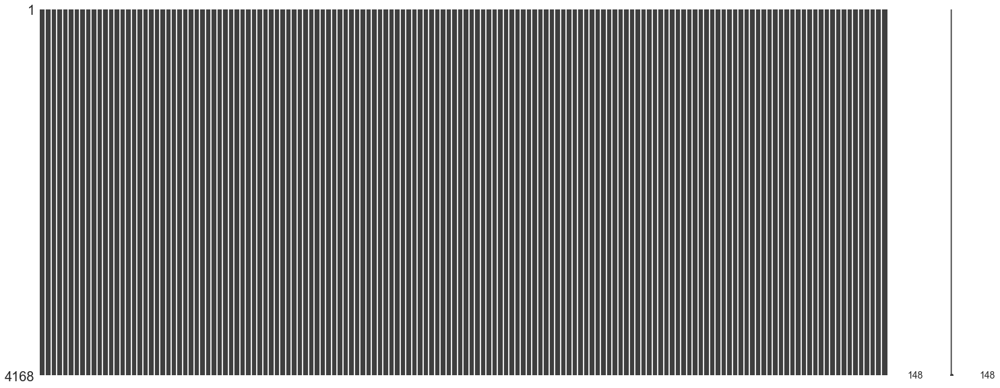

In [88]:
msno.matrix(features_train_full_mice);

### Random forest on MICE data

In [89]:
model = RandomForestClassifier(random_state=42)
model.fit(features_train_full_mice, target_train)

RandomForestClassifier(random_state=42)

In [90]:
kernel_test = mf.ImputationKernel(
  features_test_full,
  datasets=4,
  save_all_iterations=True,
  random_state=42
)
features_test_full_mice = kernel_test.complete_data(dataset=0, inplace=False)

In [91]:
%%time
# Run the MICE algorithm for 3 iterations on each of the datasets
kernel_test.mice(3,verbose=False)

Wall time: 2min 56s


In [92]:
y_pred = model.predict(features_test_full_mice)

print(classification_report(target_test, y_pred, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.46      0.55      0.50        83
          $1-99       0.42      0.11      0.17        74
       $100-999       0.40      0.38      0.39       133
   $1,000-4,999       0.37      0.44      0.40       180
  $5,000-19,999       0.38      0.42      0.40       236
 $20,000-74,999       0.33      0.25      0.29       165
$75,000 or more       0.49      0.53      0.51       171

       accuracy                           0.40      1042
      macro avg       0.40      0.38      0.38      1042
   weighted avg       0.40      0.40      0.39      1042



We see small increase in f1-score macro avg and f1-score weighted avg compared to original values (0.36 amd 0.37)

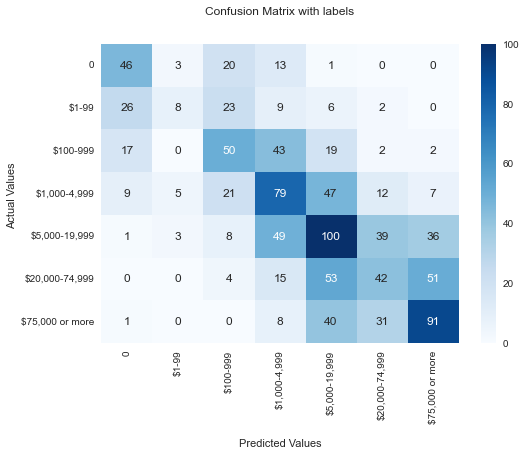

In [93]:
#confusion_matrix
conf= confusion_matrix(target_test, y_pred)

ax = sns.heatmap(conf, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.set_xticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
ax.set_yticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

It would be interstin to exemine why the model predicted saving of 0 to someone who has USD75,000 or more.

In [94]:
test_pred = pd.DataFrame({'target_test': target_test, 'y_pred':y_pred}, index=target_test.index)

In [95]:
test_pred[(test_pred['target_test']==7) & (test_pred['y_pred']==1)]

,target_test,y_pred
3573,7.0,1.0


Participant number 3573

In [96]:
features_test_full_mice.loc[3573]

I_am_satisfied_with_my_life                                              7.0
I_am_optimistic_about_my_future                                          7.0
If_I_work_hard_today_I_will_be_more_successful_in_the_future             7.0
My_finances_control_my_life                                              3.0
I_know_how_to_get_myself_to_follow_through_on_my_financial_intentions    3.0
                                                                        ... 
Presence_of_Household_Members_Children_0_1                               0.0
Presence_of_Household_Members_Children_2_5                               0.0
Presence_of_Household_Members_Children_6_12                              0.0
Presence_of_Household_Members_Children_13_17                             0.0
Presence_of_Household_Members_Adults_18_                                 2.0
Name: 3573, Length: 148, dtype: float64

### ROC curve

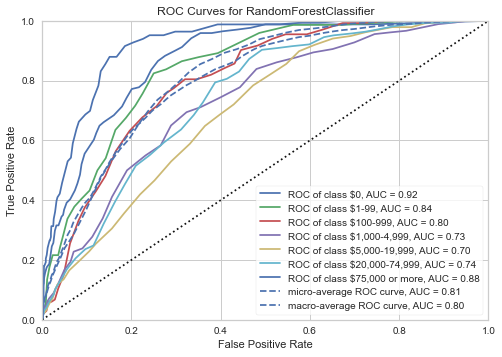

In [97]:
#In random forest, the tresholds are fraction of trees voting for the correct answer
visual = plot_ROC_curve(model, features_train_full_mice, target_train, features_test_full_mice, target_test)

### PR curve

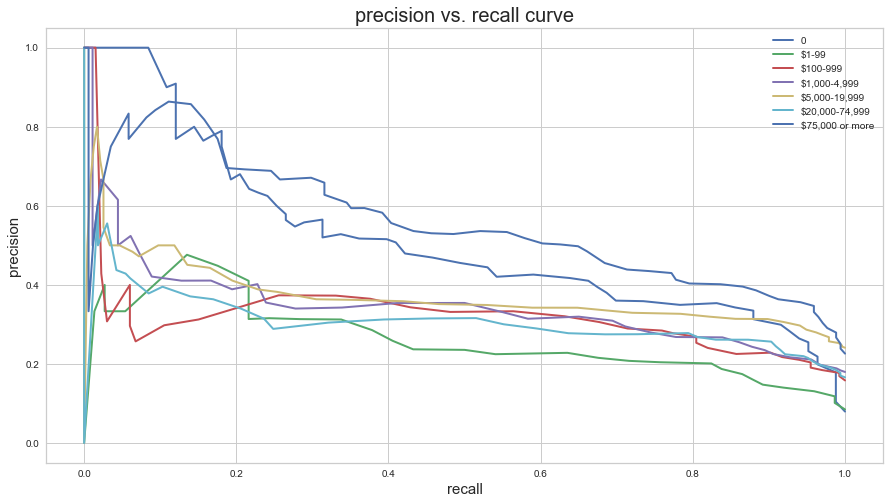

In [98]:
pr_curve(model, features_test_full_mice, target_test)

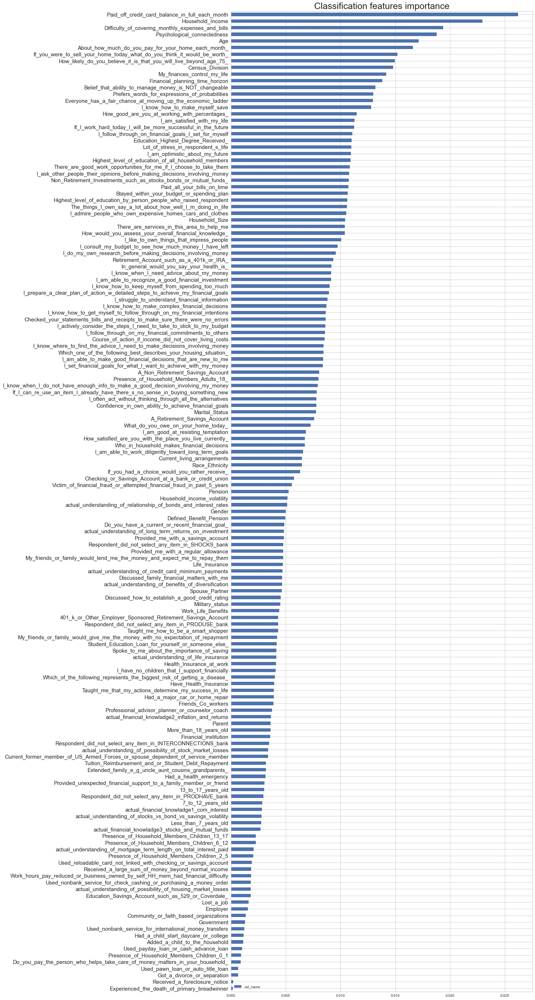

In [99]:
feature_importance_model = pd.DataFrame({'col_name': model.feature_importances_}, index=features_train_full_mice.columns).sort_values(by='col_name', ascending=False)

fig, ax = plt.subplots(figsize =(15, 50))
feature_importance_model.sort_values(by='col_name',ascending=True).plot(kind='barh', ax=ax)
plt.title('Classification features importance', size=25)
ax.tick_params(axis='y', labelsize=15)
plt.show()

In [100]:
%%time
#See explanation for test set
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(features_test_full_mice)

Wall time: 3min 22s


Class: $0


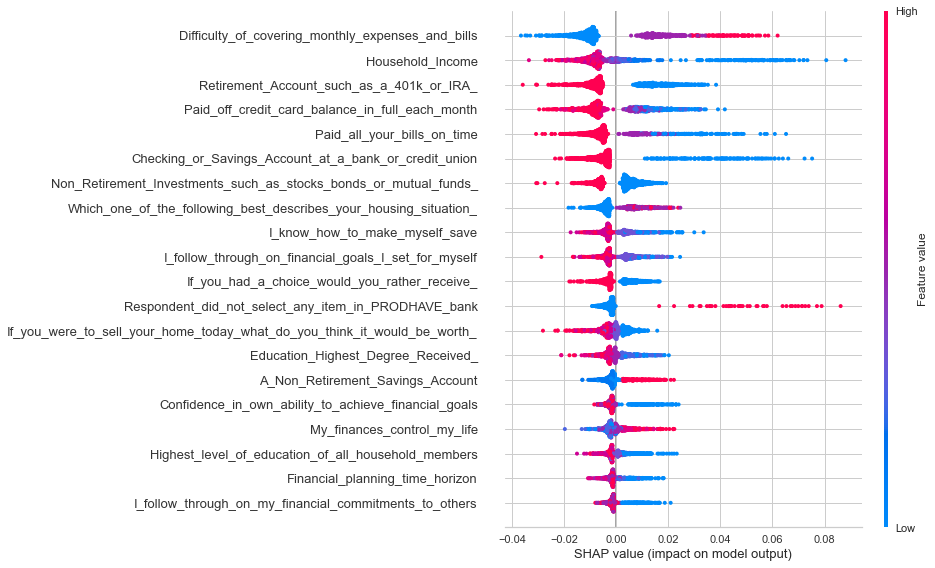

Class: $1-99


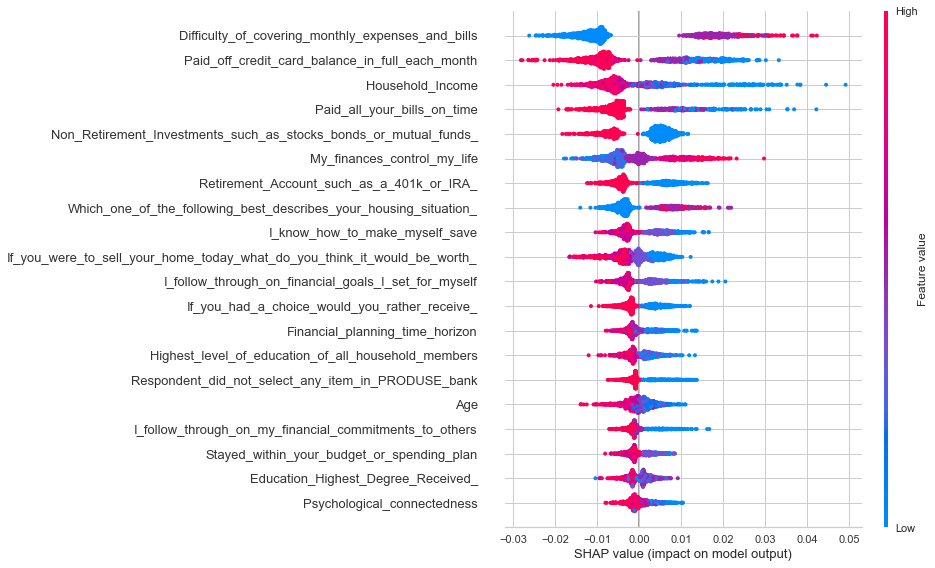

Class: $100-999


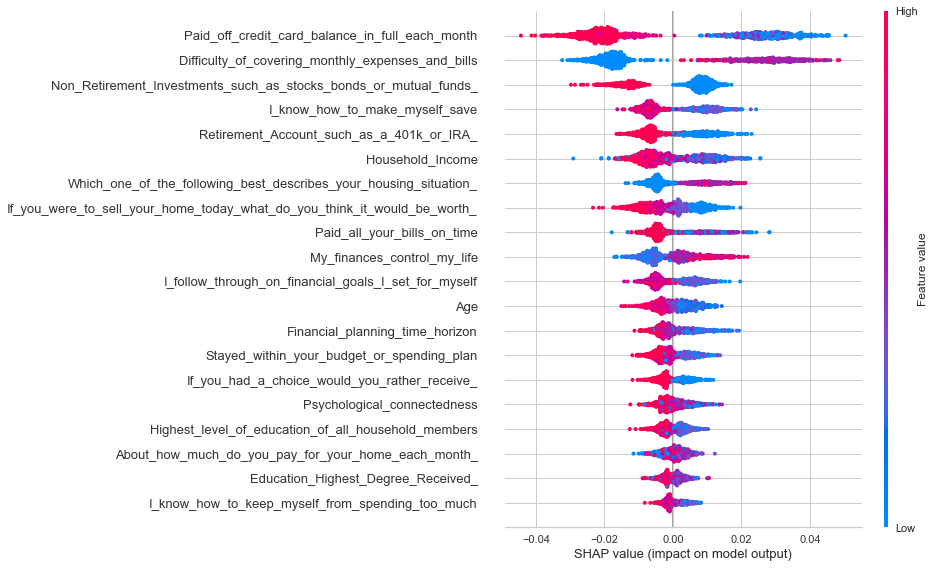

Class: $1,000-4,999


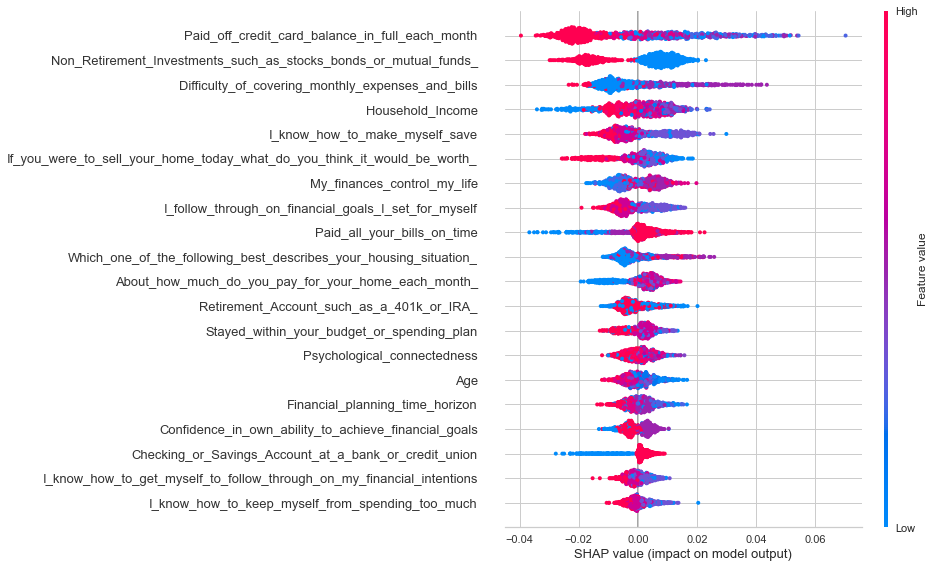

Class: $5,000-19,999


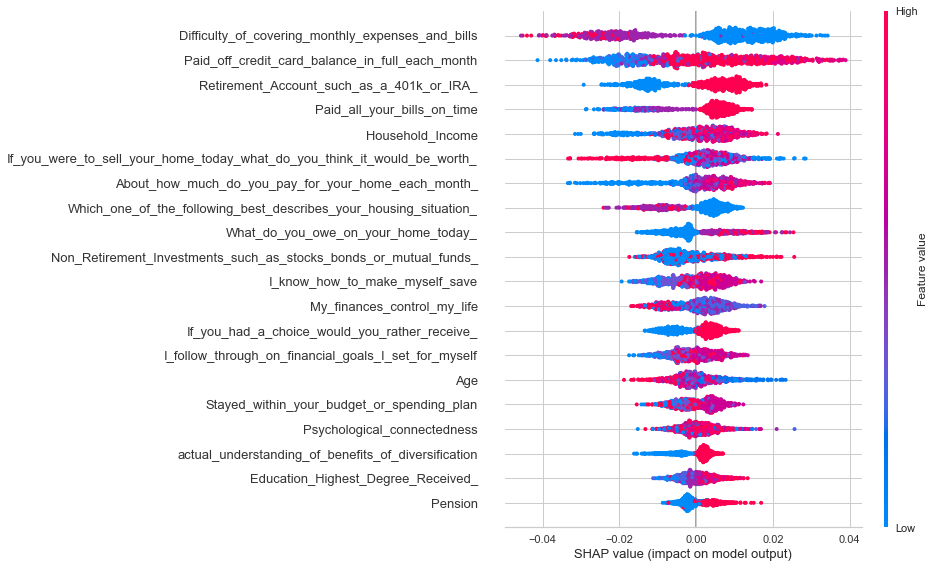

Class: $20,000-74,999


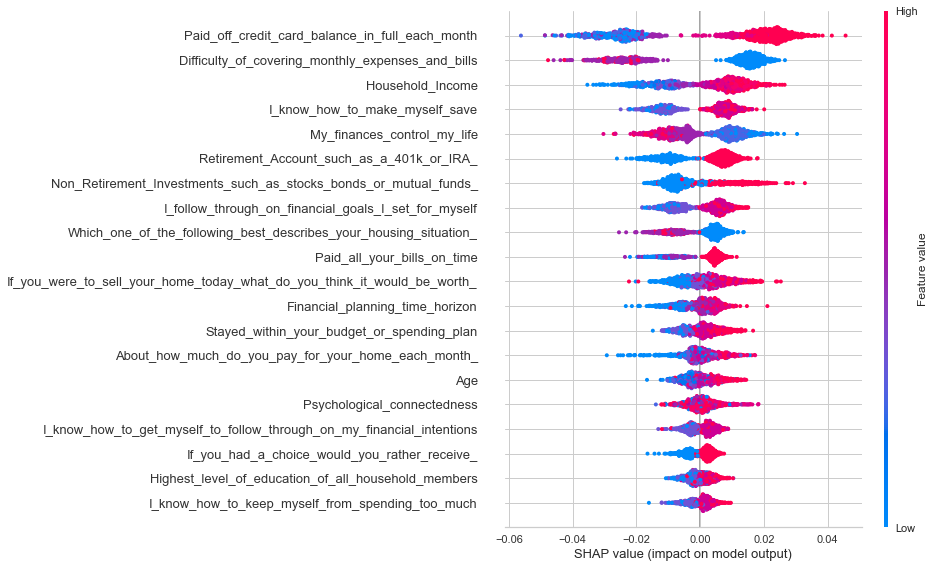

Class: $75,000 or more


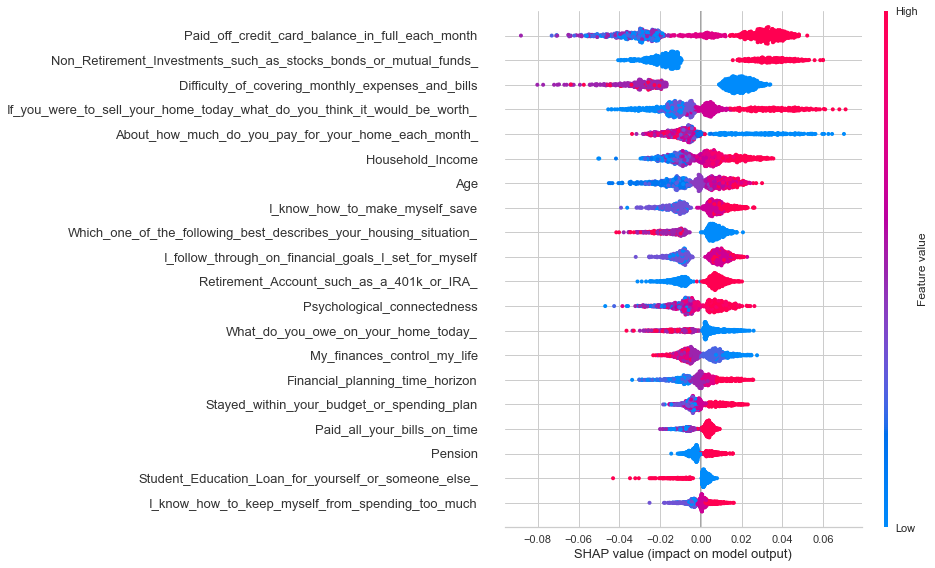

In [101]:
classes={1: '$0',
2: '$1-99', 
3: '$100-999',
4: '$1,000-4,999',
5: '$5,000-19,999',
6: '$20,000-74,999',
7: '$75,000 or more'}

for i in range(1,8):
    print('Class:', classes[i])
    shap.summary_plot(shap_values[i-1], features_test_full_mice.values, feature_names = features_test_full_mice.columns)

Here we can interstingly see the differences between USD 0 preidction and USD 75K and more predictions. For example where high values of purchase managemnet increasing the probability for class USD 0, while decraseing the probabiltiy for class USD 75K and more.

### Exemine why the model predicted saving of USD 100 - 999 to someone who has USD 75,000 or more.

In [102]:
test_pred[(test_pred['target_test']==7) & (test_pred['y_pred']==1)]

,target_test,y_pred
3573,7.0,1.0


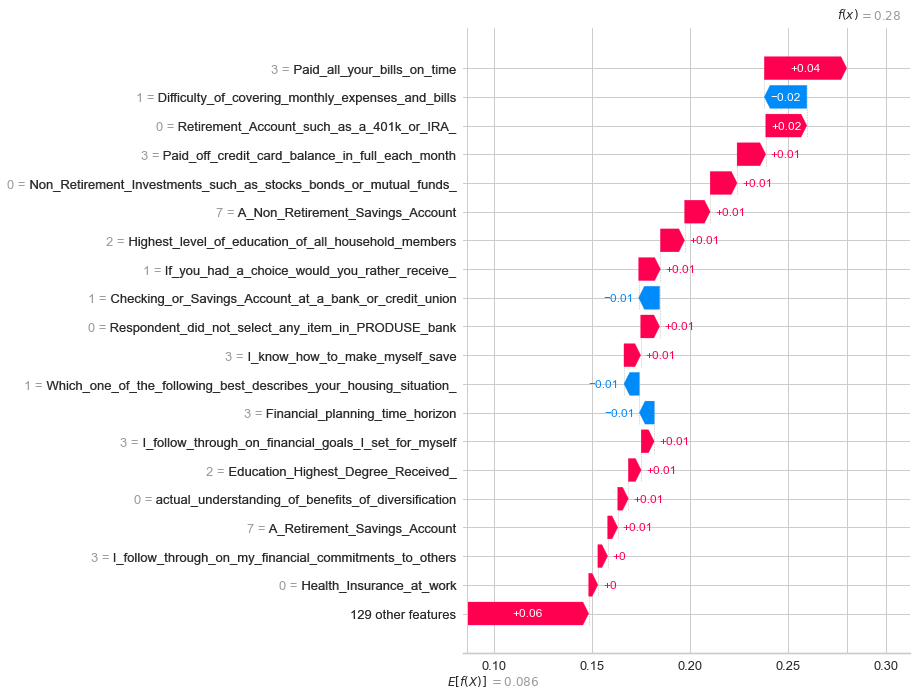

In [103]:
#See specific obseration
#Class as defined in the target
class_to_exemine = 1
#Original observation in the set
observ = 3573

#Class starting from 0
saving_class = class_to_exemine-1

#Observation ordinal number
row_shape = len(features_test_full_mice.loc[:observ])-1

shap.waterfall_plot(shap.Explanation(values=shap_values[saving_class][row_shape], 
           base_values=explainer.expected_value[saving_class], data=features_test_full_mice.loc[observ],  
                                         feature_names=features_test_full_mice.columns.tolist()),max_display=20)

**Observation 2721**

For a specific class: 1<br>
Observation: 2721 <br>
E[f(x)] is the base value - average probability of class 1 regardless of the features.<br>
f(x) is the model predicted probabiltiy to this class for the specific observation.

The main reason participant 2721 was classified into USD 0, while had USD 75K or more was because he answered: He has no checking or saving account, Difficulty of covering monthly expenses and bills - Somewhat difficult (2), I know how to make myself save - Very little (2), no retirment account.

In the other hand, he answered: Paid off credit card balance in full each month - always (5), Income USD 150,000 or more.

**Observation 3573**

For a specific class: 1<br>
Observation: 3573 <br>
E[f(x)] is the base value - average probability of class 1 regardless of the features.<br>
f(x) is the model predicted probabiltiy to this class for the specific observation.

Paid all bills on time - sometimes (3), no retirment account, paid credit card in full - simetimes (3), no stocks or bonds, don't have A Non-Retirement Savings Account. On the other hand, have no problem covering monthly expenses.

<!-- **Observation 3573**

The main reason participant 3573 was classified into USD 100 - 999 was because he answered: Paid off credit card balance in full each month - sometimes (3), he has no retirement account (0), income between  USD 40K to 49.9K (4), I know how to make myself save - somewhat (3), My finances control my life - sometimes(3), no bonds or stocks, Highest level of education of all household members - High school degree/GED (2). -->

# Exemine feature importance without 3 main features: 
- Paid off credit card in full each month
- Paid all your bills on time
- Difficulty of covering monthly expenses and bills

In [141]:
features_train_full_mice_less_3 = features_train_full_mice.drop(['Paid_all_your_bills_on_time','Difficulty_of_covering_monthly_expenses_and_bills','Paid_off_credit_card_balance_in_full_each_month'], axis=1)

features_test_full_mice_less_3 = features_test_full_mice.drop(['Paid_all_your_bills_on_time','Difficulty_of_covering_monthly_expenses_and_bills','Paid_off_credit_card_balance_in_full_each_month'], axis=1)

In [142]:
model_less_3 = RandomForestClassifier(random_state=42)

model_less_3.fit(features_train_full_mice_less_3, target_train)

RandomForestClassifier(random_state=42)

In [143]:
y_pred_less_3 = model_less_3.predict(features_test_full_mice_less_3)

print(classification_report(target_test, y_pred_less_3, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.45      0.58      0.51        83
          $1-99       0.10      0.03      0.04        74
       $100-999       0.30      0.20      0.24       133
   $1,000-4,999       0.28      0.38      0.32       180
  $5,000-19,999       0.32      0.38      0.35       236
 $20,000-74,999       0.22      0.15      0.18       165
$75,000 or more       0.46      0.50      0.48       171

       accuracy                           0.33      1042
      macro avg       0.30      0.32      0.30      1042
   weighted avg       0.31      0.33      0.32      1042



In [144]:
%%time
#See explanation for test set
explainer_less_3 = shap.TreeExplainer(model_less_3)
shap_values_less_3 = explainer_less_3.shap_values(features_test_full_mice_less_3)

Wall time: 3min 2s


Class: $0


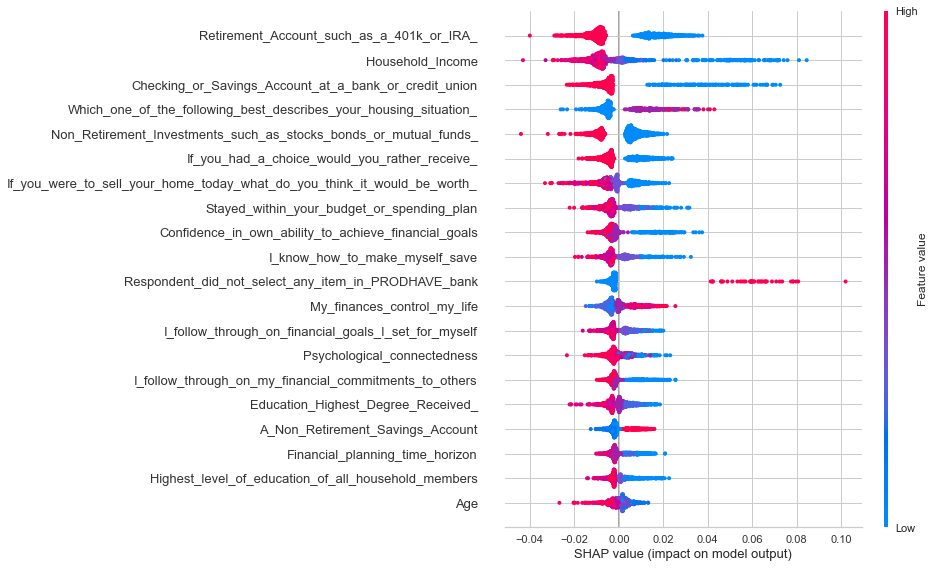

Class: $1-99


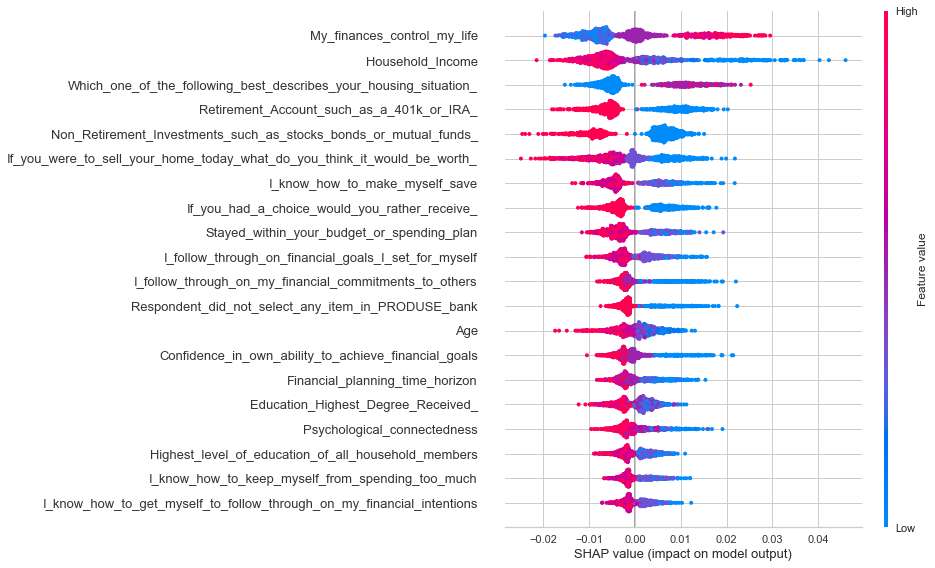

Class: $100-999


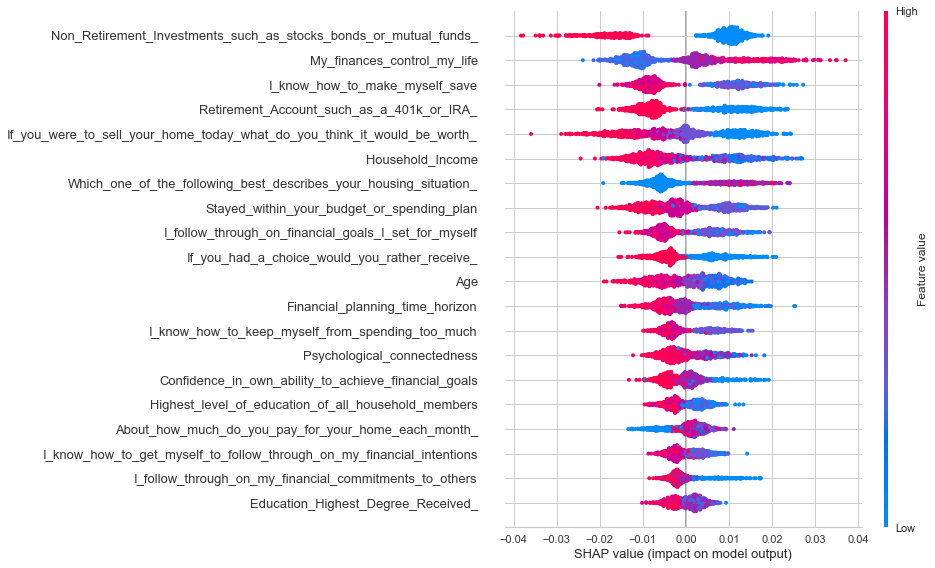

Class: $1,000-4,999


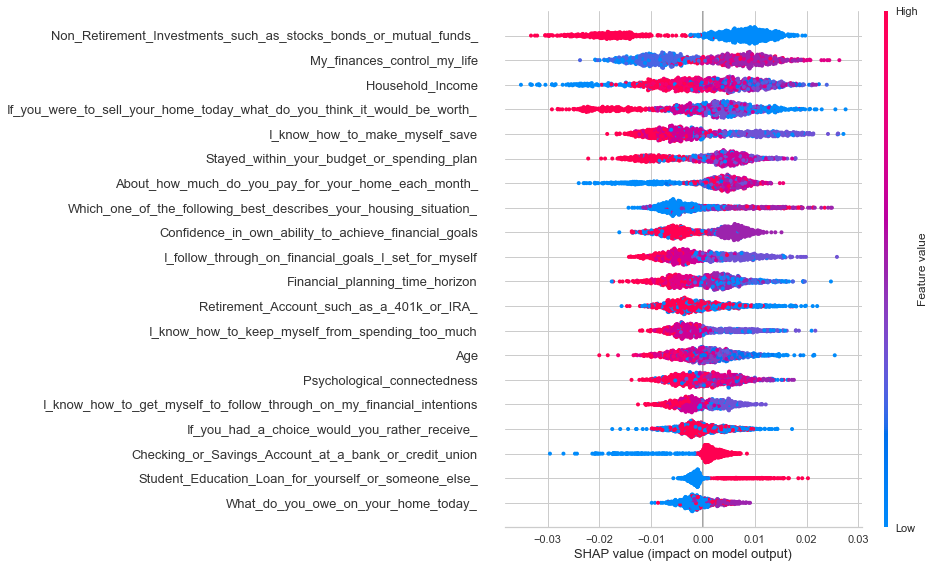

Class: $5,000-19,999


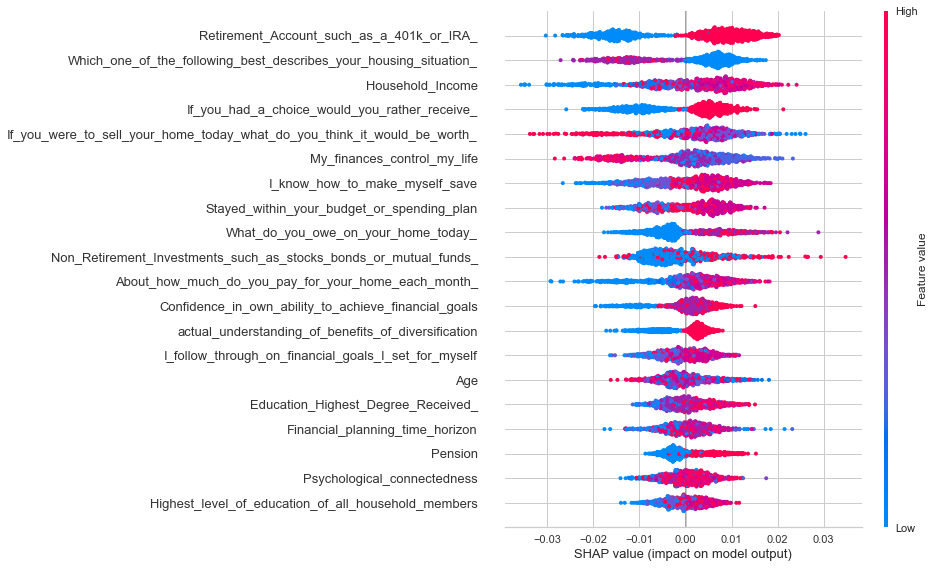

Class: $20,000-74,999


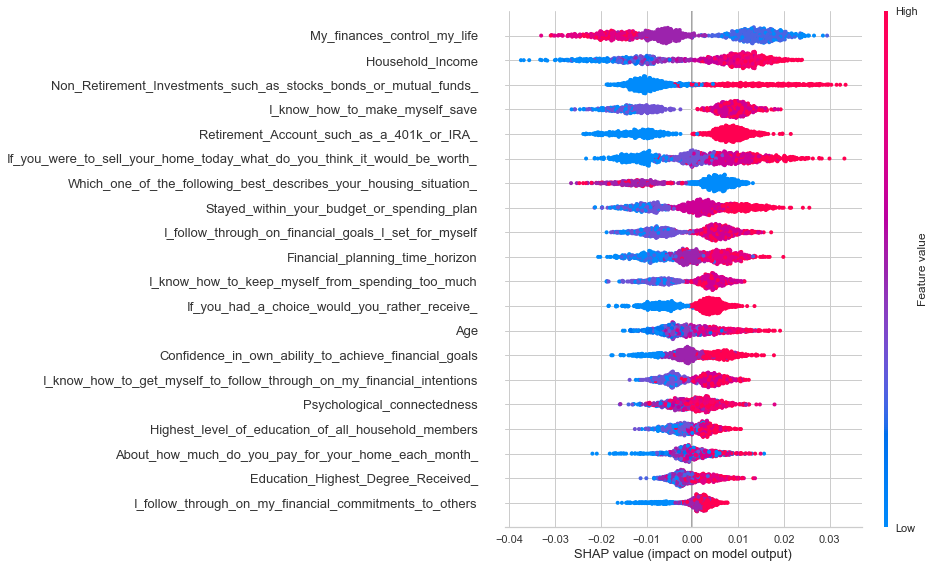

Class: $75,000 or more


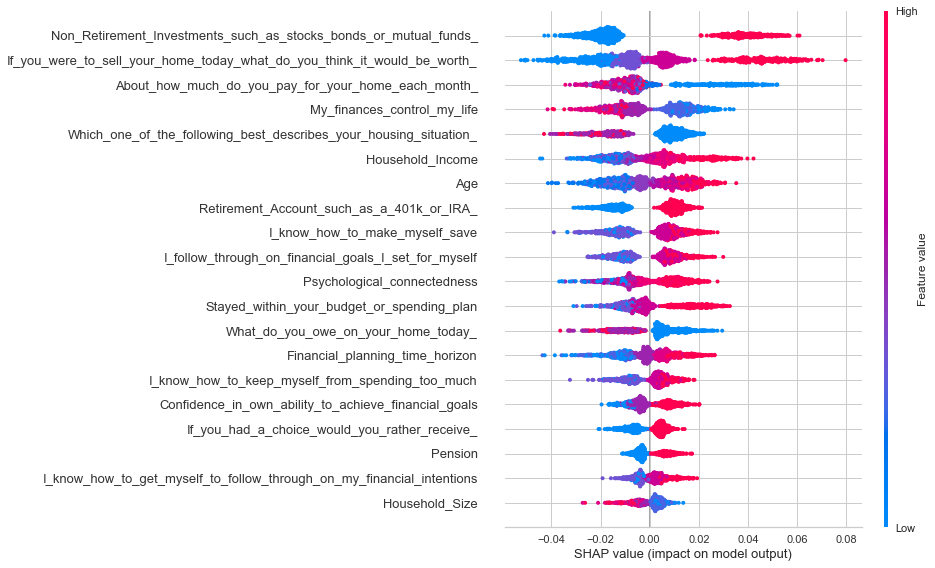

In [145]:
classes={1: '$0',
2: '$1-99', 
3: '$100-999',
4: '$1,000-4,999',
5: '$5,000-19,999',
6: '$20,000-74,999',
7: '$75,000 or more'}

for i in range(1,8):
    print('Class:', classes[i])
    shap.summary_plot(shap_values_less_3[i-1], features_test_full_mice_less_3.values, feature_names = features_test_full_mice_less_3.columns)

Interstingly, when we removed 3 most important features, we see now that self control features are even more important (after income, house situation and investments). These features are: discounting delay, stay within your budget, know how to save, achive financial goals. 

# Models

After the initial exemination we observed that replacing unwanted values has minor affect on the metrics. We will use the new values and fit a pipeline wuth upsample and GridSearchCV.

**f1_macro** - the metrics treats all classes equally regardless of their support values. Each class f1 divided by number of classes. <br>
**f1_weighted** - Using each f1 score and multiplying each class’s proportion of observations.

### GridSearchCV

We will use the grid function we created above - best_model.

In [97]:
#Create empty tuple for score
models_score = {}

## Pipeline

We will use pipeline to do upsample with cross validation. Standardize the data fir SVM which uses distances, because some of the features have values between 1-100, and run the model with different hyperparameters.

### Logistic regression - initial data

In [98]:
pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('model',LogisticRegression())])

log_reg_initial = best_model(pipe, {}, features_train_all, target_train_all)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END ..............., score=(train=0.404, test=0.334) total time=   0.6s
[CV 2/5] END ..............., score=(train=0.392, test=0.327) total time=   0.7s
[CV 3/5] END ..............., score=(train=0.395, test=0.314) total time=   0.7s
[CV 4/5] END ..............., score=(train=0.400, test=0.351) total time=   0.5s
[CV 5/5] END ..............., score=(train=0.400, test=0.354) total time=   0.5s

Best parameters: {}

Best score: 0.34


In [99]:
y_pred_lr_initial = log_reg_initial.predict(features_test_all)

In [100]:
print(classification_report(target_test_all, y_pred_lr_initial, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.40      0.61      0.48        83
          $1-99       0.19      0.24      0.22        74
       $100-999       0.29      0.24      0.26       133
   $1,000-4,999       0.35      0.31      0.33       180
  $5,000-19,999       0.37      0.22      0.28       236
 $20,000-74,999       0.30      0.31      0.31       165
$75,000 or more       0.43      0.60      0.50       171

       accuracy                           0.35      1042
      macro avg       0.33      0.36      0.34      1042
   weighted avg       0.34      0.35      0.34      1042



### Logistic regression - imputed values

In [101]:
features_train_full_mice.shape

(4168, 148)

As we have 148 categorical features, we are not encoding them into dummy variables for logistic regression. This will cause the model to think that the values are categorical ro numerical, in some sense they are.

In [102]:
pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('model',LogisticRegression())])

log_reg = best_model(pipe, {}, features_train_full_mice, target_train)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END ..............., score=(train=0.402, test=0.335) total time=   0.6s
[CV 2/5] END ..............., score=(train=0.396, test=0.354) total time=   0.6s
[CV 3/5] END ..............., score=(train=0.406, test=0.334) total time=   0.7s
[CV 4/5] END ..............., score=(train=0.387, test=0.350) total time=   0.7s
[CV 5/5] END ..............., score=(train=0.399, test=0.326) total time=   0.7s

Best parameters: {}

Best score: 0.34


In [103]:
y_pred_lr = log_reg.predict(features_test_full_mice)


In [104]:
print(classification_report(target_test, y_pred_lr, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.42      0.59      0.49        83
          $1-99       0.23      0.30      0.26        74
       $100-999       0.30      0.29      0.29       133
   $1,000-4,999       0.37      0.32      0.34       180
  $5,000-19,999       0.43      0.25      0.31       236
 $20,000-74,999       0.32      0.38      0.34       165
$75,000 or more       0.48      0.60      0.53       171

       accuracy                           0.37      1042
      macro avg       0.36      0.39      0.37      1042
   weighted avg       0.38      0.37      0.37      1042



In [105]:
#Save test, validation and test f1 weighted scores:
models_score['Logisitc Regression'] = [round(log_reg.cv_results_['mean_train_score'].mean(),3),
                                       round(log_reg.cv_results_['mean_test_score'].mean(),3),
                                       round(f1_score(target_test, y_pred_lr, average='weighted'),3)]

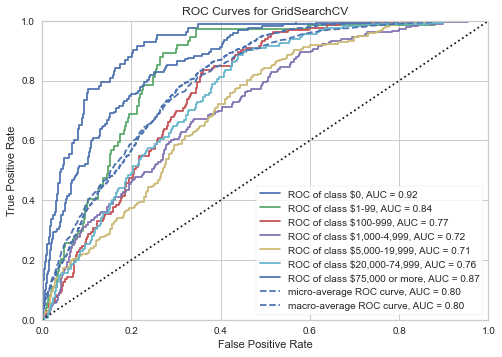

In [106]:
visual = plot_ROC_curve(log_reg, features_train_full_mice, target_train, features_test_full_mice, target_test)

### SVM

In [107]:
%%time

# C - Regularization parameter. The strength of the regularization is inversely proportional to C. 
# Must be strictly positive. The penalty is a squared l2 penalty.

# gamma - The gamma parameters can be seen as the inverse of the radius of influence of 
# samples selected by the model as support vectors. When gamma is very small, the model is too constrained and cannot capture 
# the complexity or “shape” of the data. 
pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('scaler',StandardScaler()),('model',SVC())])

param_grid = {'model__C': [0.1, 1000],
              'model__gamma': [1,  0.01],
              'model__kernel': ['rbf','sigmoid'], 'model__probability':[True]}

svc = best_model(pipe, param_grid, features_train_full_mice, target_train)

Fitting 5 folds for each of 8 candidates, totalling 40 fits
[CV 1/5] END model__C=0.1, model__gamma=1, model__kernel=rbf, model__probability=True;, score=(train=0.531, test=0.071) total time=  28.4s
[CV 2/5] END model__C=0.1, model__gamma=1, model__kernel=rbf, model__probability=True;, score=(train=0.534, test=0.071) total time=  24.8s
[CV 3/5] END model__C=0.1, model__gamma=1, model__kernel=rbf, model__probability=True;, score=(train=0.536, test=0.070) total time=  28.7s
[CV 4/5] END model__C=0.1, model__gamma=1, model__kernel=rbf, model__probability=True;, score=(train=0.534, test=0.070) total time=  30.2s
[CV 5/5] END model__C=0.1, model__gamma=1, model__kernel=rbf, model__probability=True;, score=(train=0.534, test=0.070) total time=  27.3s
[CV 1/5] END model__C=0.1, model__gamma=1, model__kernel=sigmoid, model__probability=True;, score=(train=0.154, test=0.165) total time=  13.1s
[CV 2/5] END model__C=0.1, model__gamma=1, model__kernel=sigmoid, model__probability=True;, score=(tra

In [108]:
y_pred_svc = svc.predict(features_test_full_mice)

In [109]:
print(classification_report(target_test, y_pred_svc, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.41      0.57      0.47        83
          $1-99       0.23      0.12      0.16        74
       $100-999       0.33      0.30      0.31       133
   $1,000-4,999       0.34      0.38      0.36       180
  $5,000-19,999       0.37      0.36      0.37       236
 $20,000-74,999       0.34      0.32      0.33       165
$75,000 or more       0.50      0.53      0.51       171

       accuracy                           0.38      1042
      macro avg       0.36      0.37      0.36      1042
   weighted avg       0.37      0.38      0.37      1042



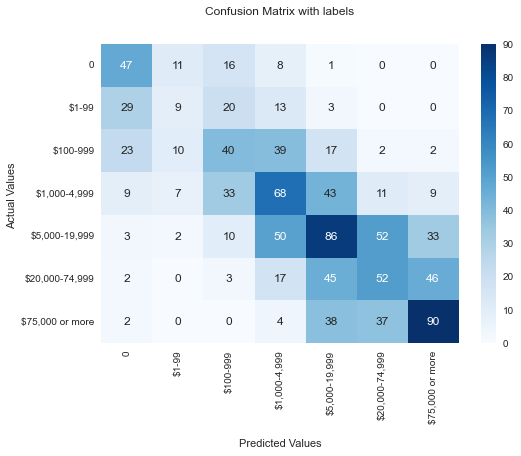

In [110]:
#confusion_matrix
conf_svc= confusion_matrix(target_test, y_pred_svc)

ax = sns.heatmap(conf_svc, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.set_xticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
ax.set_yticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

In [111]:
svc_check = pd.DataFrame({'target_test': target_test, 'y_pred':y_pred_svc}, index=target_test.index).reset_index()
svc_check.head()

,index,target_test,y_pred
0,3259,7.0,7.0
1,1015,6.0,7.0
2,1422,7.0,7.0
3,2550,4.0,3.0
4,4469,2.0,3.0


In [112]:
#check the biased results
svc_check[(svc_check['target_test']==7) & (svc_check['y_pred']==1)]

,index,target_test,y_pred
824,2721,7.0,1.0
842,3573,7.0,1.0


In [113]:
#Save test, validation and test f1 weighted scores:
models_score['SVC'] = [round(svc.cv_results_['mean_train_score'].mean(),3),
                       round(svc.cv_results_['mean_test_score'].mean(),3),
                        round(f1_score(target_test, y_pred_svc, average='weighted'),3)]

### LIME

In [114]:
# Get the class names
class_names = ['$0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more']

# Get the feature names
feature_names = list(features_test_full_mice.columns)

# Fit the Explainer on the training data set using the LimeTabularExplainer 
lime_explainer_svc = LimeTabularExplainer(features_test_full_mice.values, feature_names = feature_names, 
                                 class_names = class_names, mode = 'classification')

### Single instance - index 2721 (824)

In [115]:
#Perform the explanation on the 8th instance in the test data
explaination_svc = lime_explainer_svc.explain_instance(features_test_full_mice.iloc[824], 
                                                       svc.best_estimator_[2].predict_proba, top_labels=1)

# show the result of the model's explaination
explaination_svc.show_in_notebook(show_table = True, show_all = False)

The models predicts this observaiton is class 1, with confidence of 43%, while the actual class is 7.

### Single instance - index 3573 (842)

In [116]:
#Perform the explanation on the 8th instance in the test data
explaination_svc = lime_explainer_svc.explain_instance(features_test_full_mice.iloc[842],
                                                       svc.best_estimator_[2].predict_proba, top_labels=1)

# show the result of the model's explaination
explaination_svc.show_in_notebook(show_table = True, show_all = False)

The models predicts this observaiton is class 1, with confidence of 43%, while the actual class is 7.

### Decision Tree

In [117]:
%%time
# max_depth - The maximum depth of the tree. Need to restriced to avoid overfitting
# min_samples_split - minimum samples required to split internal node
# min_samples_leaf - The minimum number of samples required to be at a leaf node
pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('model',DecisionTreeClassifier(random_state=12345))])

dt = best_model(pipe, {'model__max_depth' : [10,20],
                      'model__min_samples_split': [1,10,20],
                      'model__min_samples_leaf': [1,5,10]}, features_train_full_mice, target_train)

Fitting 5 folds for each of 18 candidates, totalling 90 fits
[CV 1/5] END model__max_depth=10, model__min_samples_leaf=1, model__min_samples_split=1;, score=(train=nan, test=nan) total time=   0.1s
[CV 2/5] END model__max_depth=10, model__min_samples_leaf=1, model__min_samples_split=1;, score=(train=nan, test=nan) total time=   0.0s
[CV 3/5] END model__max_depth=10, model__min_samples_leaf=1, model__min_samples_split=1;, score=(train=nan, test=nan) total time=   0.0s
[CV 4/5] END model__max_depth=10, model__min_samples_leaf=1, model__min_samples_split=1;, score=(train=nan, test=nan) total time=   0.0s
[CV 5/5] END model__max_depth=10, model__min_samples_leaf=1, model__min_samples_split=1;, score=(train=nan, test=nan) total time=   0.0s
[CV 1/5] END model__max_depth=10, model__min_samples_leaf=1, model__min_samples_split=10;, score=(train=0.626, test=0.287) total time=   0.2s
[CV 2/5] END model__max_depth=10, model__min_samples_leaf=1, model__min_samples_split=10;, score=(train=0.628, t

In [118]:
y_pred_dt = dt.predict(features_test_full_mice)

In [119]:
print(classification_report(target_test, y_pred_dt, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.27      0.27      0.27        83
          $1-99       0.16      0.26      0.20        74
       $100-999       0.27      0.30      0.28       133
   $1,000-4,999       0.28      0.27      0.28       180
  $5,000-19,999       0.33      0.26      0.29       236
 $20,000-74,999       0.28      0.29      0.28       165
$75,000 or more       0.40      0.37      0.39       171

       accuracy                           0.29      1042
      macro avg       0.28      0.29      0.28      1042
   weighted avg       0.30      0.29      0.29      1042



In [120]:
#Save test, validation and test f1 weighted scores:
models_score['DecisionTree'] = [round(np.nanmean(dt.cv_results_['mean_train_score']),3),
                                round(np.nanmean(dt.cv_results_['mean_test_score']),3),
                                       round(f1_score(target_test, y_pred_dt, average='weighted'),3)]

### Random Forest

In [121]:
%%time
# n_estimators - This is the number of trees
# max_depth - The maximum depth of the tree. Need to restriced to avoid overfitting
pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('model',RandomForestClassifier(random_state=12345))])

rf = best_model(pipe, {'model__n_estimators' : [100, 200],
                        'model__max_depth' : [5,8],
                      'model__min_samples_split':[10, 20],
                      'model__min_samples_leaf':[10,20]}, features_train_full_mice, target_train)

Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV 1/5] END model__max_depth=5, model__min_samples_leaf=10, model__min_samples_split=10, model__n_estimators=100;, score=(train=0.451, test=0.345) total time=   0.7s
[CV 2/5] END model__max_depth=5, model__min_samples_leaf=10, model__min_samples_split=10, model__n_estimators=100;, score=(train=0.449, test=0.335) total time=   0.6s
[CV 3/5] END model__max_depth=5, model__min_samples_leaf=10, model__min_samples_split=10, model__n_estimators=100;, score=(train=0.458, test=0.332) total time=   0.6s
[CV 4/5] END model__max_depth=5, model__min_samples_leaf=10, model__min_samples_split=10, model__n_estimators=100;, score=(train=0.450, test=0.327) total time=   0.5s
[CV 5/5] END model__max_depth=5, model__min_samples_leaf=10, model__min_samples_split=10, model__n_estimators=100;, score=(train=0.452, test=0.353) total time=   0.5s
[CV 1/5] END model__max_depth=5, model__min_samples_leaf=10, model__min_samples_split=10, model__n_estim

In [122]:
y_pred_rf = rf.predict(features_test_full_mice)

print(classification_report(target_test, y_pred_rf, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.40      0.59      0.48        83
          $1-99       0.21      0.31      0.25        74
       $100-999       0.29      0.23      0.26       133
   $1,000-4,999       0.35      0.31      0.33       180
  $5,000-19,999       0.39      0.26      0.32       236
 $20,000-74,999       0.35      0.25      0.29       165
$75,000 or more       0.44      0.71      0.54       171

       accuracy                           0.37      1042
      macro avg       0.35      0.38      0.35      1042
   weighted avg       0.36      0.37      0.35      1042



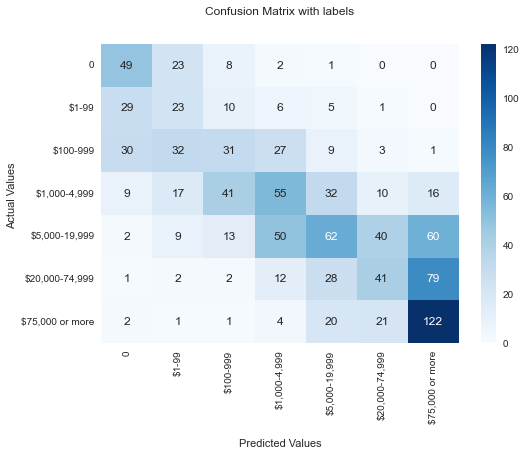

In [305]:
#confusion_matrix
conf_rf_7= confusion_matrix(target_test, y_pred_rf)

ax = sns.heatmap(conf_rf_7, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.set_xticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
ax.set_yticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

In [123]:
#Save test, validation and test f1 weighted scores:
models_score['RandomForest'] = [round(rf.cv_results_['mean_train_score'].mean(),3),
                                round(rf.cv_results_['mean_test_score'].mean(),3),
                                       round(f1_score(target_test, y_pred_rf, average='weighted'),3)]

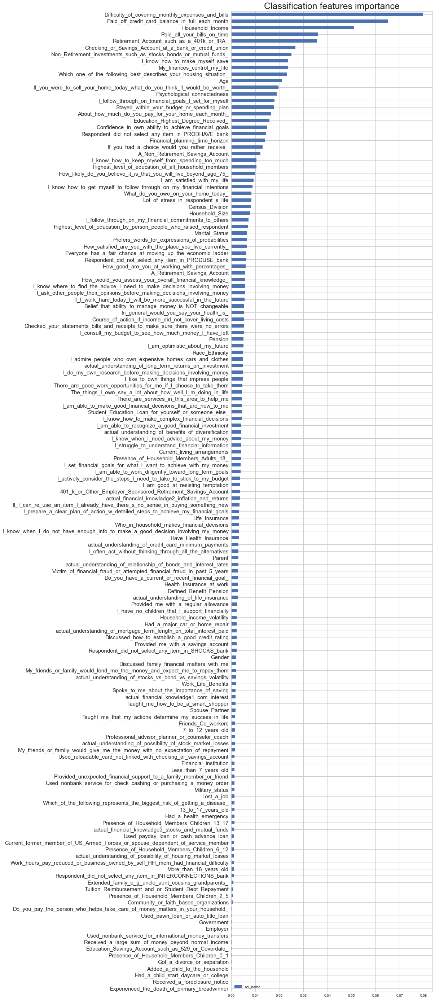

In [124]:
feature_importance_rfn = pd.DataFrame({'col_name': rf.best_estimator_[1].feature_importances_}, index=features_train_full_mice.columns).sort_values(by='col_name', ascending=False)

fig, ax = plt.subplots(figsize =(10, 50))
feature_importance_rfn.sort_values(by='col_name',ascending=True).plot(kind='barh', ax=ax)
plt.title('Classification features importance', size=25)
ax.tick_params(axis='y', labelsize=15)
plt.show()

In [125]:
%%time
#See explanation for test set
explainer_rf_7 = shap.TreeExplainer(rf.best_estimator_[1])
shap_values_rf_7 = explainer_rf_7.shap_values(features_test_full_mice)

Wall time: 13.2 s


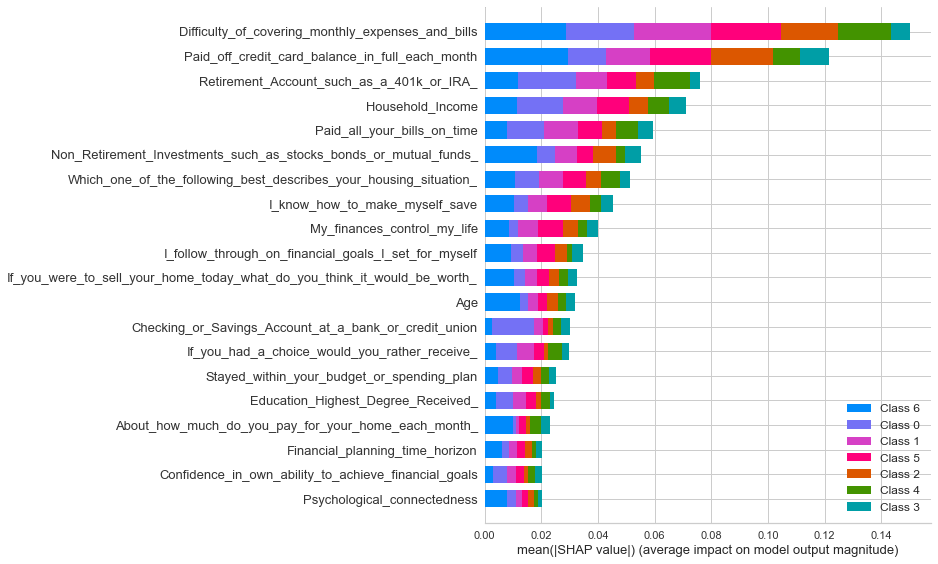

In [126]:
shap.summary_plot(shap_values_rf_7, features_test_full_mice.values, feature_names = features_test_full_mice.columns)

### SHAP by class

Class: $0


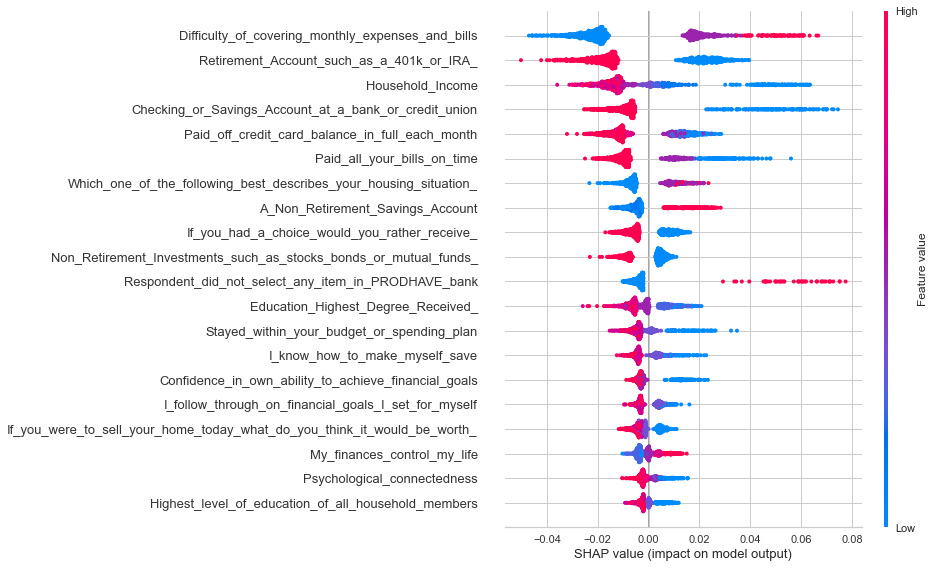

Class: $1-99


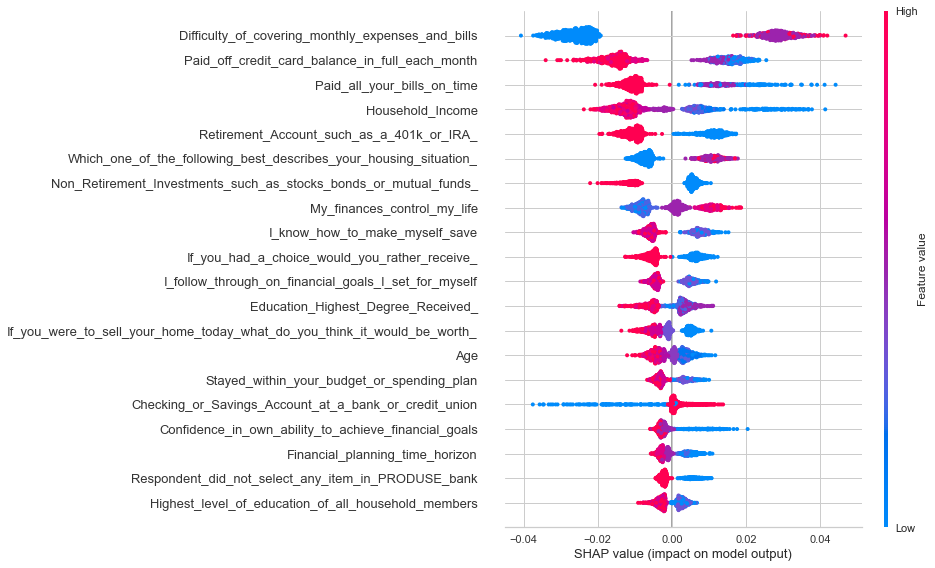

Class: $100-999


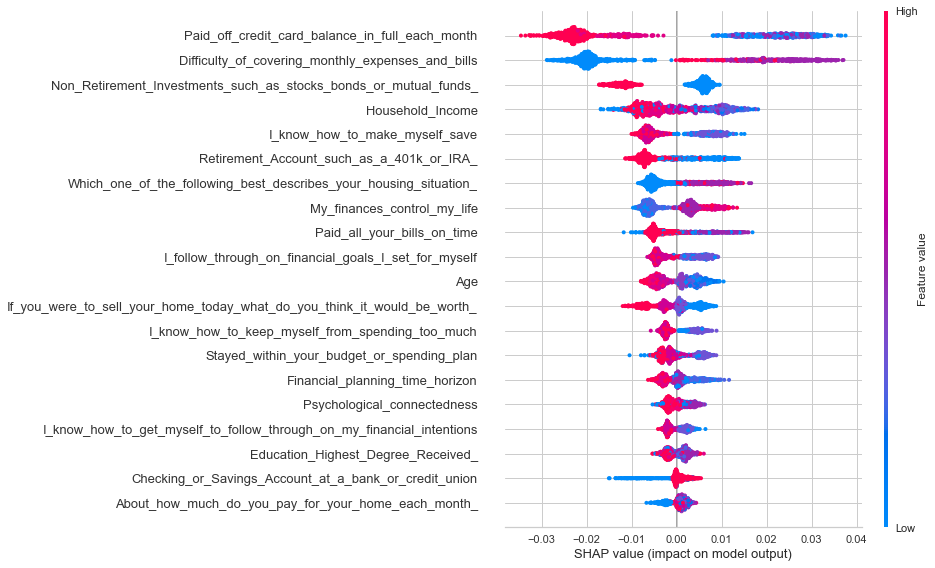

Class: $1,000-4,999


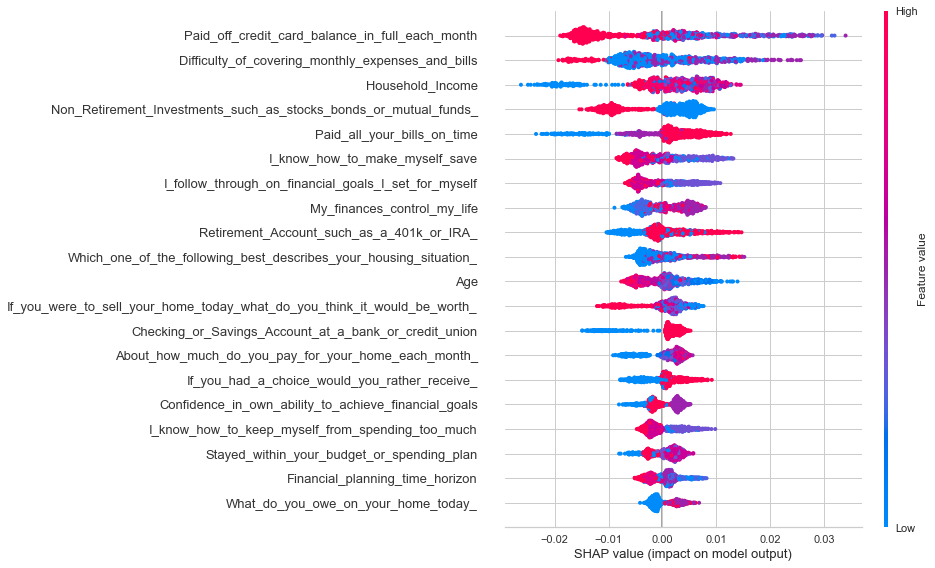

Class: $5,000-19,999


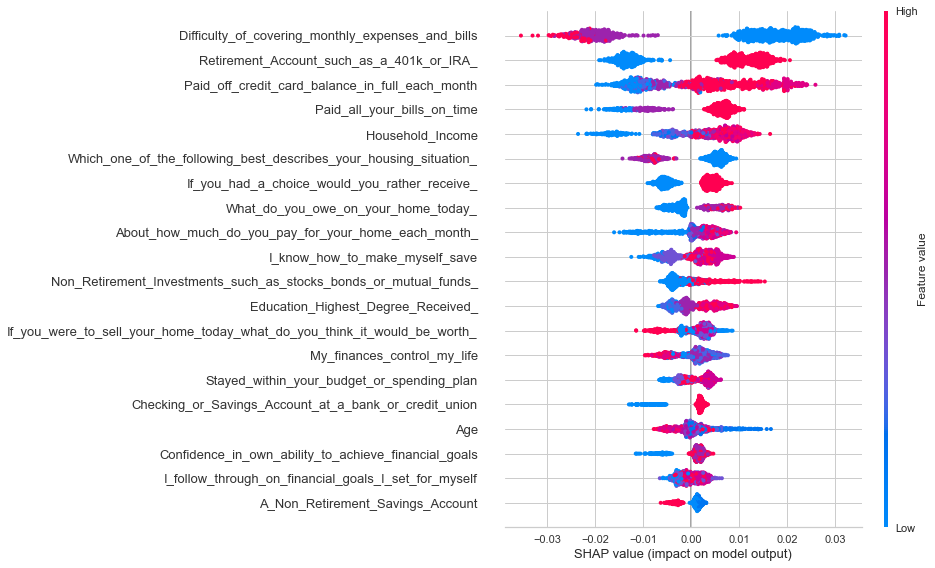

Class: $20,000-74,999


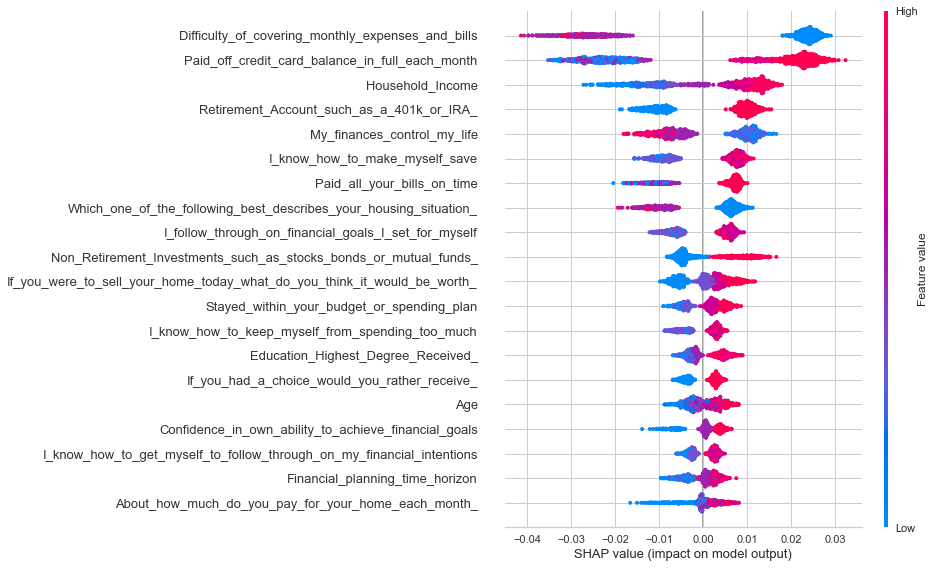

Class: $75,000 or more


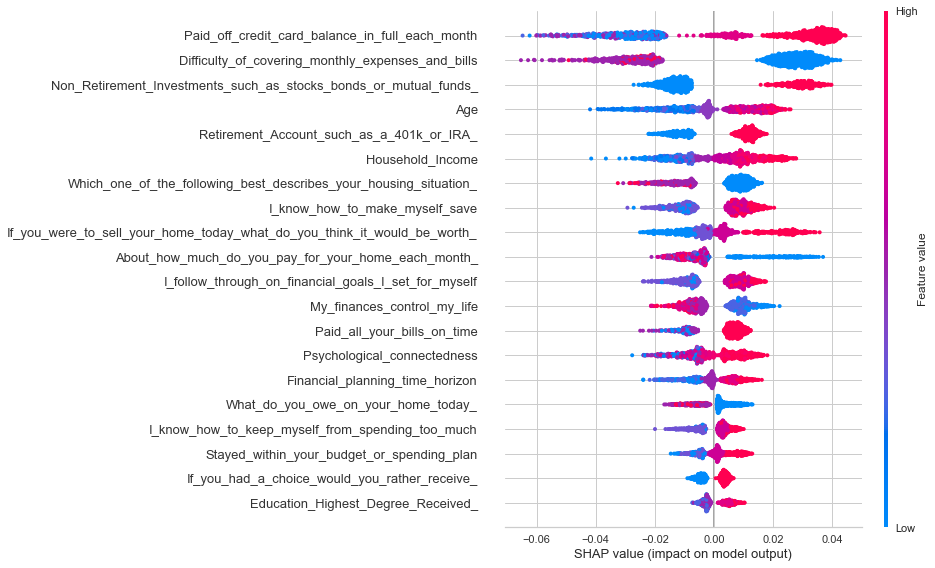

In [127]:
classes={1: '$0',
2: '$1-99', 
3: '$100-999',
4: '$1,000-4,999',
5: '$5,000-19,999',
6: '$20,000-74,999',
7: '$75,000 or more'}

for i in range(1,8):
    print('Class:', classes[i])
    shap.summary_plot(shap_values_rf_7[i-1], features_test_full_mice.values, feature_names = features_test_full_mice.columns)

### ELI5

In [128]:
perm = PermutationImportance(rf.best_estimator_[1], scoring = 'f1_weighted' ,random_state=42).fit(features_test_full_mice, target_test)

In [129]:
show_weights(perm, feature_names = list(features_test_full_mice.columns))

Weight,Feature
0.0156 ± 0.0145,Paid_off_credit_card_balance_in_full_each_month
0.0086 ± 0.0095,What_do_you_owe_on_your_home_today_
0.0070 ± 0.0133,Retirement_Account_such_as_a_401k_or_IRA_
0.0061 ± 0.0064,Checking_or_Savings_Account_at_a_bank_or_credit_union
0.0058 ± 0.0041,Presence_of_Household_Members_Adults_18_
0.0043 ± 0.0095,Age
0.0038 ± 0.0023,Who_in_household_makes_financial_decisions
0.0036 ± 0.0033,401_k_or_Other_Employer_Sponsored_Retirement_Savings_Account
0.0035 ± 0.0048,actual_financial_knowladge2_inflation_and_returns
0.0034 ± 0.0028,I_follow_through_on_my_financial_commitments_to_others


### Look at misclassification

In [130]:
show_prediction(rf.best_estimator_[1], features_test_full_mice.iloc[842], show_feature_values=True)

### Look at correct classification

In [131]:
show_prediction(rf.best_estimator_[1], features_test_full_mice.iloc[1], show_feature_values=True)

### XGBoost

In [132]:
%%time
# n_estimators - number of boosting rounds that will be performed
# max_depth -  maximum distance between the root node of each tree and a leaf node

pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('model',XGBClassifier(random_state=12345))])

xgboost = best_model(pipe, {
                        'model__learning_rate' : [0.01, 0.1],
                        'model__n_estimators' : [100, 200],
                        'model__max_depth' : [5, 8],
                        'model__objective':['multi:softprob'],
                        }, features_train_full_mice, target_train-1)

Fitting 5 folds for each of 8 candidates, totalling 40 fits
[CV 1/5] END model__learning_rate=0.01, model__max_depth=5, model__n_estimators=100, model__objective=multi:softprob;, score=(train=0.555, test=0.345) total time=  31.5s
[CV 2/5] END model__learning_rate=0.01, model__max_depth=5, model__n_estimators=100, model__objective=multi:softprob;, score=(train=0.536, test=0.319) total time=  31.8s
[CV 3/5] END model__learning_rate=0.01, model__max_depth=5, model__n_estimators=100, model__objective=multi:softprob;, score=(train=0.535, test=0.337) total time=  31.2s
[CV 4/5] END model__learning_rate=0.01, model__max_depth=5, model__n_estimators=100, model__objective=multi:softprob;, score=(train=0.530, test=0.295) total time=  32.1s
[CV 5/5] END model__learning_rate=0.01, model__max_depth=5, model__n_estimators=100, model__objective=multi:softprob;, score=(train=0.532, test=0.350) total time=  33.0s
[CV 1/5] END model__learning_rate=0.01, model__max_depth=5, model__n_estimators=200, model

In [133]:
y_pred_xgb = xgboost.predict(features_test_full_mice)

print(classification_report(target_test, y_pred_xgb+1, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.41      0.55      0.47        83
          $1-99       0.25      0.18      0.21        74
       $100-999       0.32      0.26      0.29       133
   $1,000-4,999       0.37      0.40      0.39       180
  $5,000-19,999       0.38      0.32      0.35       236
 $20,000-74,999       0.26      0.28      0.27       165
$75,000 or more       0.46      0.56      0.51       171

       accuracy                           0.37      1042
      macro avg       0.35      0.36      0.35      1042
   weighted avg       0.36      0.37      0.36      1042



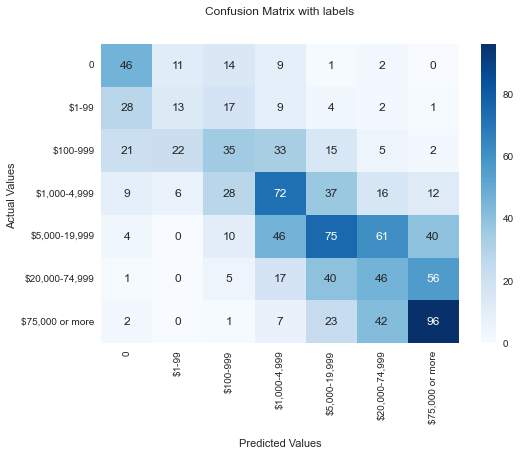

In [134]:
#confusion_matrix
conf_xgb= confusion_matrix(target_test, y_pred_xgb+1)

ax = sns.heatmap(conf_xgb, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.set_xticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
ax.set_yticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

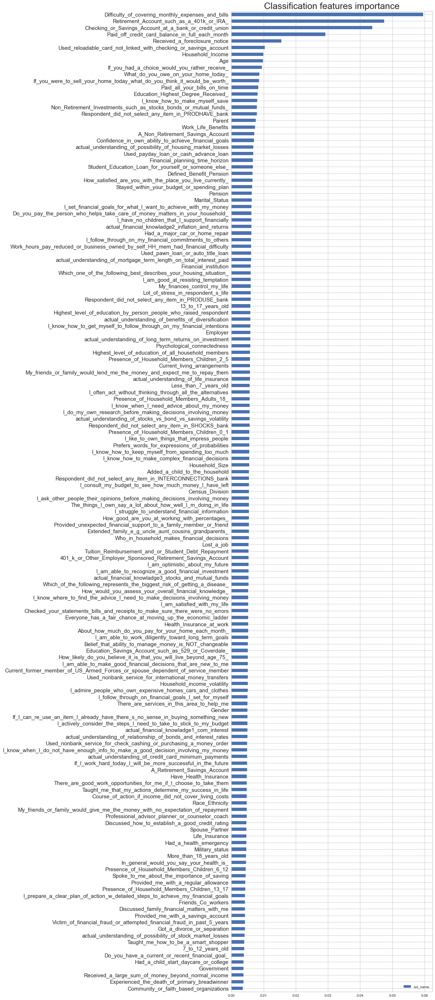

In [135]:
feature_importance_xgb = pd.DataFrame({'col_name': xgboost.best_estimator_[1].feature_importances_}, index=features_train_full_mice.columns).sort_values(by='col_name', ascending=False)

fig, ax = plt.subplots(figsize =(10, 50))
feature_importance_xgb.sort_values(by='col_name',ascending=True).plot(kind='barh', ax=ax)
plt.title('Classification features importance', size=25)
ax.tick_params(axis='y', labelsize=15)
plt.show()

In [136]:
%%time
#See explanation for test set
explainer_xgb_7 = shap.TreeExplainer(xgboost.best_estimator_[1])
shap_values_xgb_7 = explainer_xgb_7.shap_values(features_test_full_mice)

Wall time: 32.8 s


Class: $0


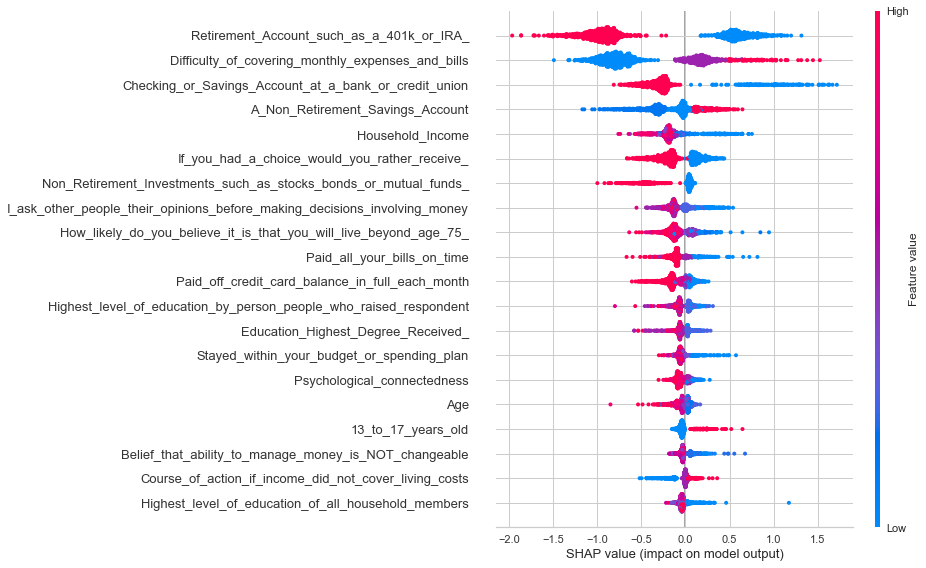

Class: $1-99


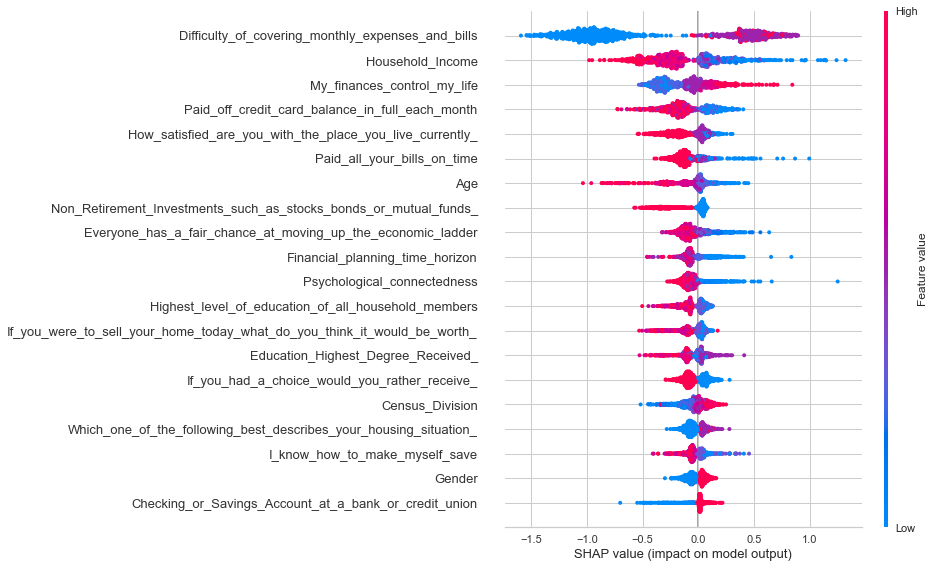

Class: $100-999


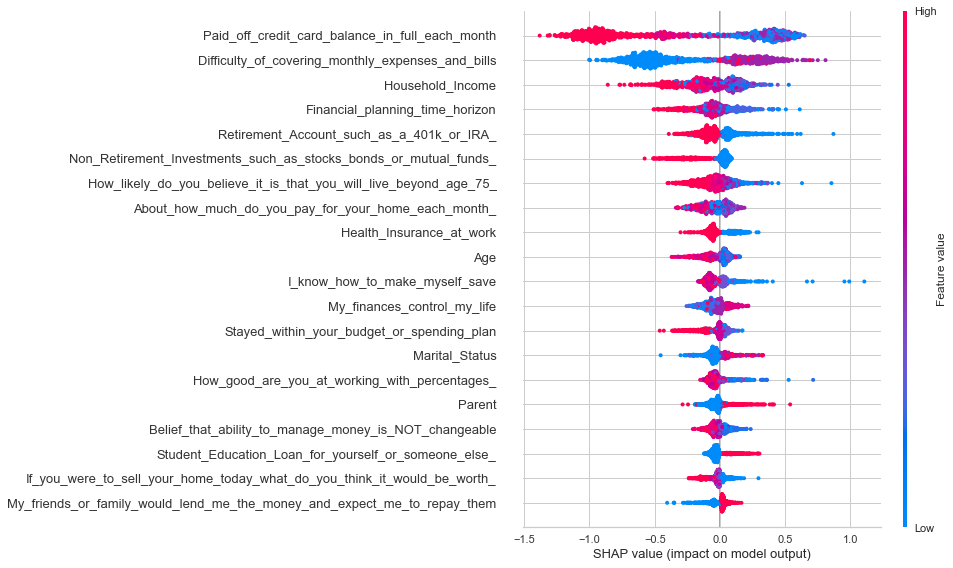

Class: $1,000-4,999


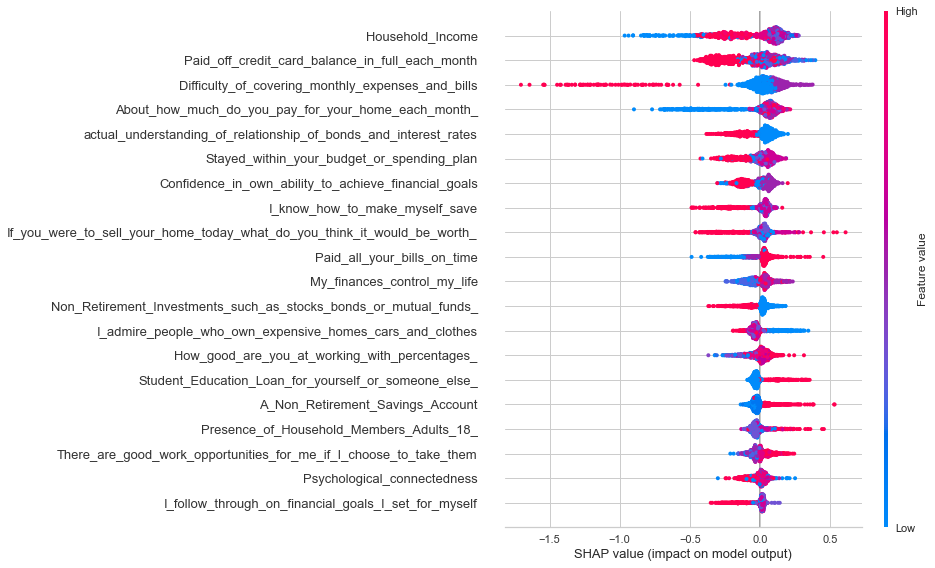

Class: $5,000-19,999


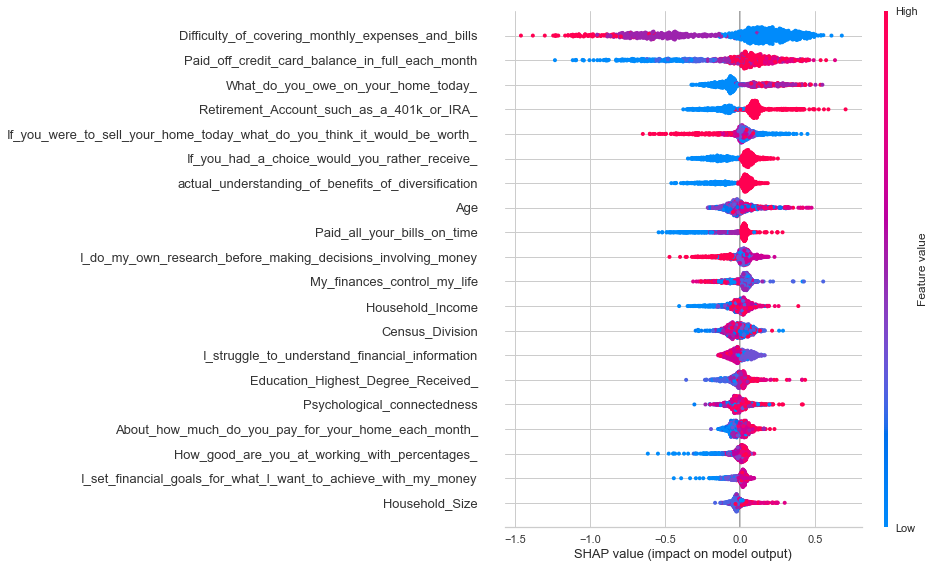

Class: $20,000-74,999


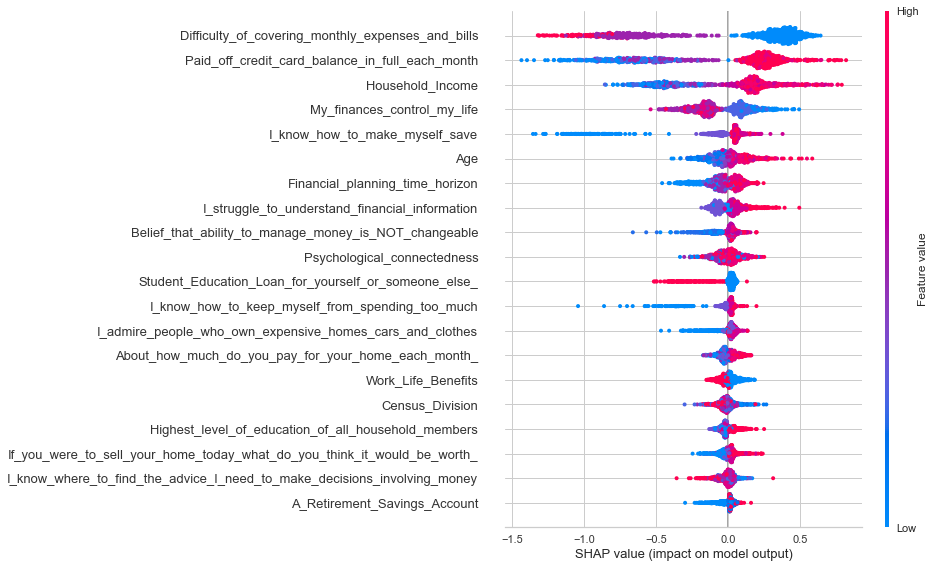

Class: $75,000 or more


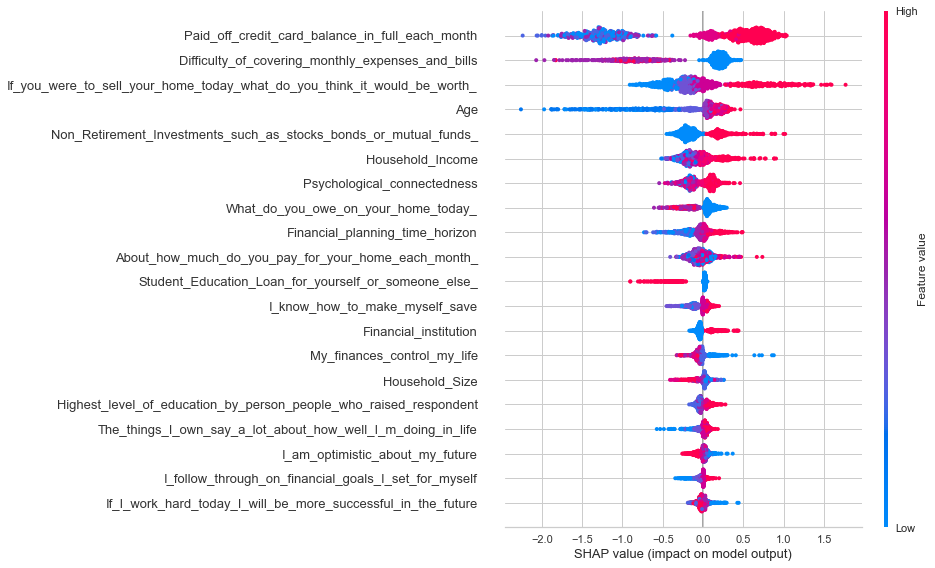

In [137]:
classes={1: '$0',
2: '$1-99', 
3: '$100-999',
4: '$1,000-4,999',
5: '$5,000-19,999',
6: '$20,000-74,999',
7: '$75,000 or more'}

for i in range(1,8):
    print('Class:', classes[i])
    shap.summary_plot(shap_values_xgb_7[i-1], features_test_full_mice.values, feature_names = features_test_full_mice.columns)

In [138]:
#Save test, validation and test f1 weighted scores:
models_score['XGBoost'] = [round(xgboost.cv_results_['mean_train_score'].mean(),3),
                           round(xgboost.cv_results_['mean_test_score'].mean(),3),
                                       round(f1_score(target_test, y_pred_xgb+1, average='weighted'),3)]

### LightGBM

In [139]:
%%time
# n_estimators - number of boosting rounds that will be performed
# max_depth -  maximum distance between the root node of each tree and a leaf node
pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('model',lgb.LGBMClassifier(random_state=12345))])

lgbm = best_model(pipe, {'model__learning_rate' : [0.01, 0.1],
                        'model__n_estimators' : [20, 80],
                        'model__max_depth' : [3, 5],
                        'model__num_leaves': [8, 15, 30],
                        'model__min_data_in_leaf': [10, 30]}, features_train_full_mice, target_train)

Fitting 5 folds for each of 48 candidates, totalling 240 fits
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[CV 1/5] END model__learning_rate=0.01, model__max_depth=3, model__min_data_in_leaf=10, model__n_estimators=20, model__num_leaves=8;, score=(train=0.326, test=0.310) total time=   0.2s
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[CV 2/5] END model__learning_rate=0.01, model__max_depth=3, model__min_data_in_leaf=10, model__n_estimators=20, model__num_leaves=8;, score=(train=0.330, test=0.304) total time=   0.2s
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[CV 3/5] END model__learning_rate=0.01, model__max_depth=3, model__min_data_in_leaf=10, model__n_estimators=20, model__num_leaves=8;, score=(train=0.324, test=0.313) total time=   0.2s
[LightGBM] [Warni

In [140]:
y_pred_lgbm = lgbm.predict(features_test_full_mice)

print(classification_report(target_test, y_pred_lgbm, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.44      0.60      0.51        83
          $1-99       0.28      0.34      0.30        74
       $100-999       0.31      0.25      0.28       133
   $1,000-4,999       0.32      0.27      0.29       180
  $5,000-19,999       0.39      0.30      0.34       236
 $20,000-74,999       0.28      0.30      0.29       165
$75,000 or more       0.45      0.60      0.52       171

       accuracy                           0.36      1042
      macro avg       0.35      0.38      0.36      1042
   weighted avg       0.36      0.36      0.36      1042



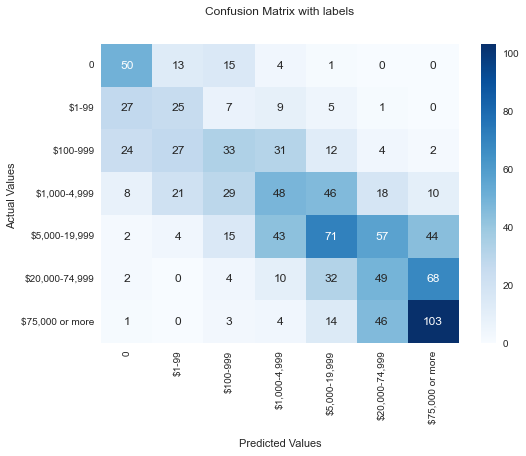

In [141]:
#confusion_matrix
conf_lgbm= confusion_matrix(target_test, y_pred_lgbm)

ax = sns.heatmap(conf_lgbm, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.set_xticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
ax.set_yticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

In [142]:
#Save test, validation and test f1 weighted scores:
models_score['LightGBM'] = [round(lgbm.cv_results_['mean_train_score'].mean(),3),
                            round(lgbm.cv_results_['mean_test_score'].mean(),3),
                                       round(f1_score(target_test, y_pred_lgbm, average='weighted'),3)]

### Use lightGBM to exemine train vs test metrics F1 weighted

In [143]:
f1_table = {}
for i in range(1,10):
    model_lgbm = lgb.LGBMClassifier(random_state=42, max_depth=i, num_leaves=8, min_data_in_leaf=30,
                                   n_estimators=10, learning_rate=0.1)
    model_lgbm.fit(features_train_full_mice, target_train)
   
    y_pred_lgbm = model_lgbm.predict(features_test_full_mice)
    
    y_pred_lgbm_train = model_lgbm.predict(features_train_full_mice)
    
    f1_table[i] = [f1_score(target_test, y_pred_lgbm, average='weighted'),f1_score(target_train, y_pred_lgbm_train, average='weighted')]
    

[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] min

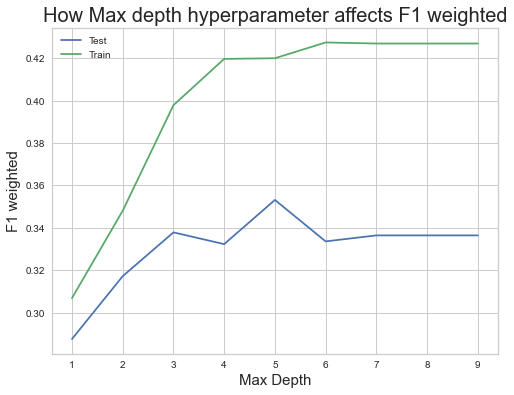

In [144]:
plt.figure(figsize=(8, 6))
plt.plot(list(f1_table.keys()),list(f1_table.values()))
plt.xlabel('Max Depth', size=15)
plt.ylabel('F1 weighted', size=15)
plt.title('How Max depth hyperparameter affects F1 weighted', size=20)
plt.legend(['Test','Train'])
plt.show()

### SVM - OvO

In [145]:
%%time

# C - Regularization parameter. The strength of the regularization is inversely proportional to C. 
# Must be strictly positive. The penalty is a squared l2 penalty.

# gamma - The gamma parameters can be seen as the inverse of the radius of influence of 
# samples selected by the model as support vectors. When gamma is very small, the model is too constrained and cannot capture 
# the complexity or “shape” of the data. 
pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('scaler',StandardScaler()),('model',SVC())])

param_grid = {'model__C': [0.1, 1000],
              'model__gamma': [1,  0.01],
              'model__kernel': ['rbf'], 'model__probability':[True], 'model__decision_function_shape':['ovo']}

svc_ovo = best_model(pipe, param_grid, features_train_full_mice, target_train)

Fitting 5 folds for each of 4 candidates, totalling 20 fits
[CV 1/5] END model__C=0.1, model__decision_function_shape=ovo, model__gamma=1, model__kernel=rbf, model__probability=True;, score=(train=0.531, test=0.071) total time=  23.2s
[CV 2/5] END model__C=0.1, model__decision_function_shape=ovo, model__gamma=1, model__kernel=rbf, model__probability=True;, score=(train=0.534, test=0.071) total time=15.4min
[CV 3/5] END model__C=0.1, model__decision_function_shape=ovo, model__gamma=1, model__kernel=rbf, model__probability=True;, score=(train=0.536, test=0.070) total time= 1.0min
[CV 4/5] END model__C=0.1, model__decision_function_shape=ovo, model__gamma=1, model__kernel=rbf, model__probability=True;, score=(train=0.534, test=0.070) total time=  41.4s
[CV 5/5] END model__C=0.1, model__decision_function_shape=ovo, model__gamma=1, model__kernel=rbf, model__probability=True;, score=(train=0.534, test=0.070) total time=  33.0s
[CV 1/5] END model__C=0.1, model__decision_function_shape=ovo, mo

In [146]:
y_pred_svc_ovo = svc_ovo.predict(features_test_full_mice)

print(classification_report(target_test, y_pred_svc_ovo, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.41      0.57      0.47        83
          $1-99       0.23      0.12      0.16        74
       $100-999       0.33      0.30      0.31       133
   $1,000-4,999       0.34      0.38      0.36       180
  $5,000-19,999       0.37      0.36      0.37       236
 $20,000-74,999       0.34      0.32      0.33       165
$75,000 or more       0.50      0.53      0.51       171

       accuracy                           0.38      1042
      macro avg       0.36      0.37      0.36      1042
   weighted avg       0.37      0.38      0.37      1042



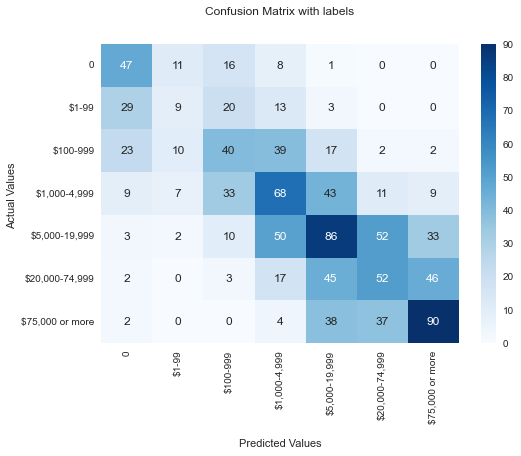

In [147]:
#confusion_matrix
conf_svc_ovo= confusion_matrix(target_test, y_pred_svc_ovo)

ax = sns.heatmap(conf_svc_ovo, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.set_xticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
ax.set_yticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

In [148]:
#Save test, validation and test f1 weighted scores:
models_score['SVC_OvO'] = [round(svc_ovo.cv_results_['mean_train_score'].mean(),3),
                            round(svc_ovo.cv_results_['mean_test_score'].mean(),3),
                                       round(f1_score(target_test, y_pred_svc_ovo, average='weighted'),3)]

### KNN

In [149]:
pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('scaler',StandardScaler()),('model',KNeighborsClassifier())])

param_grid = {'model__n_neighbors': list(range(10, 20))}

knn = best_model(pipe, param_grid, features_train_full_mice, target_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END model__n_neighbors=10;, score=(train=0.462, test=0.278) total time=   0.1s
[CV 2/5] END model__n_neighbors=10;, score=(train=0.464, test=0.302) total time=   0.1s
[CV 3/5] END model__n_neighbors=10;, score=(train=0.459, test=0.295) total time=   0.1s
[CV 4/5] END model__n_neighbors=10;, score=(train=0.470, test=0.292) total time=   0.1s
[CV 5/5] END model__n_neighbors=10;, score=(train=0.466, test=0.284) total time=   0.1s
[CV 1/5] END model__n_neighbors=11;, score=(train=0.462, test=0.280) total time=   0.2s
[CV 2/5] END model__n_neighbors=11;, score=(train=0.455, test=0.295) total time=   0.1s
[CV 3/5] END model__n_neighbors=11;, score=(train=0.452, test=0.295) total time=   0.1s
[CV 4/5] END model__n_neighbors=11;, score=(train=0.460, test=0.302) total time=   0.1s
[CV 5/5] END model__n_neighbors=11;, score=(train=0.450, test=0.271) total time=   0.1s
[CV 1/5] END model__n_neighbors=12;, score=(train=0.450, te

In [150]:
y_pred_knn = knn.predict(features_test_full_mice)

print(classification_report(target_test, y_pred_knn, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.39      0.36      0.38        83
          $1-99       0.16      0.23      0.19        74
       $100-999       0.26      0.21      0.23       133
   $1,000-4,999       0.30      0.21      0.25       180
  $5,000-19,999       0.28      0.19      0.23       236
 $20,000-74,999       0.24      0.33      0.27       165
$75,000 or more       0.41      0.54      0.47       171

       accuracy                           0.29      1042
      macro avg       0.29      0.30      0.29      1042
   weighted avg       0.29      0.29      0.29      1042



In [151]:
#Save test, validation and test f1 weighted scores:
models_score['KNN'] = [round(knn.cv_results_['mean_train_score'].mean(),3),
                            round(knn.cv_results_['mean_test_score'].mean(),3),
                                       round(f1_score(target_test, y_pred_knn, average='weighted'),3)]

### Naive Bayes

In [152]:
from sklearn.naive_bayes import GaussianNB

In [153]:
pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('scaler',StandardScaler()),('model',GaussianNB())])

param_grid = {}

naive_bayes = best_model(pipe, param_grid, features_train_full_mice, target_train)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END ..............., score=(train=0.290, test=0.274) total time=   0.0s
[CV 2/5] END ..............., score=(train=0.282, test=0.246) total time=   0.0s
[CV 3/5] END ..............., score=(train=0.304, test=0.283) total time=   0.0s
[CV 4/5] END ..............., score=(train=0.310, test=0.264) total time=   0.0s
[CV 5/5] END ..............., score=(train=0.298, test=0.271) total time=   0.0s

Best parameters: {}

Best score: 0.27


In [154]:
y_pred_naive_bayes = naive_bayes.predict(features_test_full_mice)

print(classification_report(target_test, y_pred_naive_bayes, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.42      0.60      0.49        83
          $1-99       0.29      0.31      0.30        74
       $100-999       0.37      0.22      0.27       133
   $1,000-4,999       0.25      0.13      0.17       180
  $5,000-19,999       0.31      0.04      0.07       236
 $20,000-74,999       0.20      0.59      0.30       165
$75,000 or more       0.45      0.41      0.43       171

       accuracy                           0.29      1042
      macro avg       0.33      0.33      0.29      1042
   weighted avg       0.32      0.29      0.26      1042



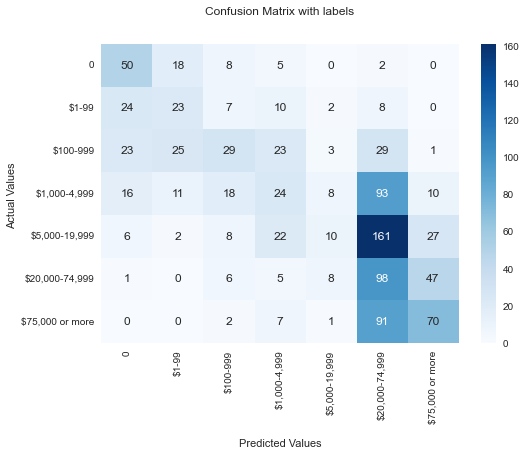

In [155]:
#confusion_matrix
conf_naive_bayes= confusion_matrix(target_test, y_pred_naive_bayes)

ax = sns.heatmap(conf_naive_bayes, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.set_xticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
ax.set_yticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

In [156]:
#Save test, validation and test f1 weighted scores:
models_score['Naive_Bayes'] = [round(naive_bayes.cv_results_['mean_train_score'].mean(),3),
                            round(naive_bayes.cv_results_['mean_test_score'].mean(),3),
                                       round(f1_score(target_test, y_pred_naive_bayes, average='weighted'),3)]

## Results

In [157]:
pd.DataFrame.from_dict(models_score, orient='index', columns=['Train F1 weighted',
                                                              'Valid F1 weighted','Test F1 weighted']).sort_values(by='Test F1 weighted', ascending=False)

,Train F1 weighted,Valid F1 weighted,Test F1 weighted
SVC,0.493,0.232,0.370
SVC_OvO,0.742,0.201,0.370
Logisitc Regression,0.398,0.340,0.366
XGBoost,0.856,0.351,0.361
LightGBM,0.519,0.333,0.355
RandomForest,0.546,0.343,0.353
DecisionTree,0.631,0.303,0.294
KNN,0.438,0.293,0.287
Naive_Bayes,0.297,0.267,0.261


## Conclusions - phase 1.0

We see many clasiffication mistakes, but some of the mistakes might be accetapble, such as the differnce between people with USD 0 to USD 1-99, or USD 100 - 999 to USD 1,000 to 4,999 maybe not that far.<br><br>
Also, for example there might be people with USD 65,000 and people with USD 75,000, and appear under differnt classes.<br><br>
Maybe so many clases is too much for classification task, where the label represent too close classes. Maybe we need to divide the labels to sub categories. <br><br>
We might try start with prediction of USD 0 to USD 4,999 for lower level of saving and USD 5,000 to 19,999 to mid-level and USD 20,000 and above to higher levels of saving. <br><br>
Then we can try to dive deeper.

## Predict one class and change thresholds

### Class 0: $0

In [158]:
#Convert multi class into binary - train set
target_train_0 = [1 if x==1 else 0 for x in target_train]
target_train_0 = pd.Series(target_train_0, index=target_train.index)

#Convert multi class into binary - test set
target_test_0 = [1 if x==1 else 0 for x in target_test]
target_test_0 = pd.Series(target_test_0, index=target_test.index)

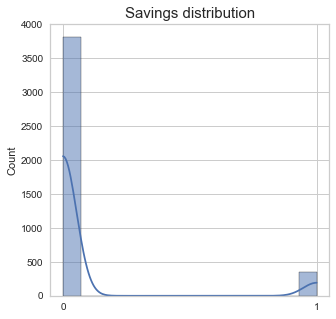

In [159]:
fig, ax = plt.subplots(figsize=(5, 5))
sns.histplot(target_train_0, kde=True, ax=ax)
plt.title('Savings distribution', size=15)
plt.xticks(np.arange(min(target_train_0), max(target_train_0)+1, 1.0))
plt.show()

Very imbalanced data

In [160]:
pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('model',LogisticRegression())])

log_reg_b = best_model_binary(pipe, {}, features_train_full_mice, target_train_0)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END ..............., score=(train=0.612, test=0.471) total time=   0.2s
[CV 2/5] END ..............., score=(train=0.592, test=0.543) total time=   0.2s
[CV 3/5] END ..............., score=(train=0.589, test=0.516) total time=   0.2s
[CV 4/5] END ..............., score=(train=0.590, test=0.524) total time=   0.2s
[CV 5/5] END ..............., score=(train=0.582, test=0.571) total time=   0.2s

Best parameters: {}

Best score: 0.52


In [161]:
y_pred_log_reg_b = log_reg_b.predict(features_test_full_mice)

print(classification_report(target_test_0, y_pred_log_reg_b))

              precision    recall  f1-score   support

           0       0.98      0.86      0.92       959
           1       0.34      0.82      0.48        83

    accuracy                           0.86      1042
   macro avg       0.66      0.84      0.70      1042
weighted avg       0.93      0.86      0.88      1042



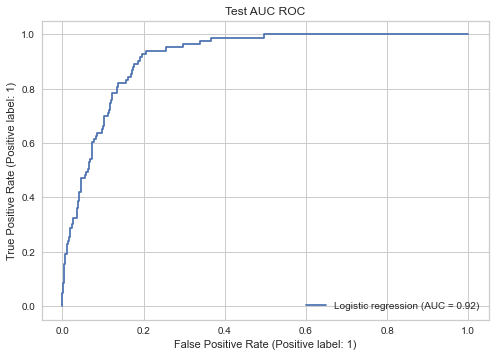

In [162]:
ax = plt.gca()
plt.title('Test AUC ROC')
metrics.plot_roc_curve(log_reg_b, features_test_full_mice, target_test_0, name = 'Logistic regression', ax=ax)
plt.show()

In [163]:
y_pred_log_reg_b_proba = log_reg_b.predict_proba(features_test_full_mice)
yhat = y_pred_log_reg_b_proba[:, 1]

In [164]:
f1_max=0
for i in np.arange(0,1,0.05):
    predicted_valid = yhat > i
    f1_sc = f1_score(target_test_0, predicted_valid)
    print('Treshold:', round(i,3) ,'f1 score:',round(f1_score(target_test_0, predicted_valid),3))
    
    if f1_sc>f1_max:
        f1_max = f1_sc
        best_treshold = i
print()        
print('Best treshold:', round(best_treshold,3) ,'best f1 score:',round(f1_max,3))

Treshold: 0.0 f1 score: 0.148
Treshold: 0.05 f1 score: 0.33
Treshold: 0.1 f1 score: 0.379
Treshold: 0.15 f1 score: 0.4
Treshold: 0.2 f1 score: 0.426
Treshold: 0.25 f1 score: 0.44
Treshold: 0.3 f1 score: 0.444
Treshold: 0.35 f1 score: 0.45
Treshold: 0.4 f1 score: 0.452
Treshold: 0.45 f1 score: 0.466
Treshold: 0.5 f1 score: 0.479
Treshold: 0.55 f1 score: 0.481
Treshold: 0.6 f1 score: 0.481
Treshold: 0.65 f1 score: 0.479
Treshold: 0.7 f1 score: 0.47
Treshold: 0.75 f1 score: 0.481
Treshold: 0.8 f1 score: 0.461
Treshold: 0.85 f1 score: 0.451
Treshold: 0.9 f1 score: 0.467
Treshold: 0.95 f1 score: 0.397

Best treshold: 0.55 best f1 score: 0.481


In [165]:
predicted_valid = yhat > best_treshold
print(classification_report(target_test_0, predicted_valid))

              precision    recall  f1-score   support

           0       0.98      0.87      0.92       959
           1       0.35      0.78      0.48        83

    accuracy                           0.87      1042
   macro avg       0.66      0.83      0.70      1042
weighted avg       0.93      0.87      0.89      1042



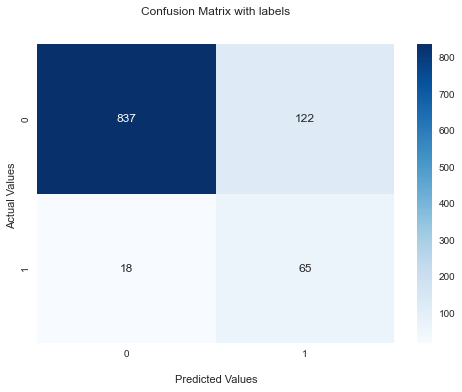

In [166]:
#confusion_matrix
conf_log_b= confusion_matrix(target_test_0, predicted_valid)

ax = sns.heatmap(conf_log_b, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
plt.show()

For the best F1 score 49%:

Recall 61% - The model was able to recognize only 61% of all cases.
We see that the model predicted 51 correct 1 classes, but for the rest of 32 class 1 cases (USD 0 saving) he predicted that they have more money, althou they have not. <br>

Precision 41% - The predictions of the model were right in only 41%. We see that 51 class 1 cases were predicted correctly but 74 classes were labeld as class 1 (USD 0 savings), but actually they had more more money.

If people with 0 savings are very important to recognize (for business they have higher risk, for education they need more attention), even in the case of mistake, we want the model to predict more cases of USD 0. In this case we would like to increse the Recall on the expense of saying people have mo money when they actually have. 

In [167]:
recall_max=0
for i in np.arange(0,1,0.05):
    predicted_valid = yhat > i
    recall_sc = recall_score(target_test_0, predicted_valid)
    print('Treshold:', round(i,3) ,'recall score:',round(recall_score(target_test_0, predicted_valid),3))
    
    if recall_sc>recall_max:
        recall_max = recall_sc
        best_treshold_r = i
print()        
print('Best treshold:', round(best_treshold_r,3) ,'best recall score:',round(recall_max,3))

Treshold: 0.0 recall score: 1.0
Treshold: 0.05 recall score: 0.976
Treshold: 0.1 recall score: 0.952
Treshold: 0.15 recall score: 0.94
Treshold: 0.2 recall score: 0.94
Treshold: 0.25 recall score: 0.904
Treshold: 0.3 recall score: 0.892
Treshold: 0.35 recall score: 0.867
Treshold: 0.4 recall score: 0.831
Treshold: 0.45 recall score: 0.819
Treshold: 0.5 recall score: 0.819
Treshold: 0.55 recall score: 0.783
Treshold: 0.6 recall score: 0.747
Treshold: 0.65 recall score: 0.699
Treshold: 0.7 recall score: 0.663
Treshold: 0.75 recall score: 0.602
Treshold: 0.8 recall score: 0.53
Treshold: 0.85 recall score: 0.494
Treshold: 0.9 recall score: 0.47
Treshold: 0.95 recall score: 0.325

Best treshold: 0.0 best recall score: 1.0


We don't want the model to predict all customers as class 1, so we won't use 0 as a treshold.

              precision    recall  f1-score   support

           0       0.99      0.79      0.88       959
           1       0.28      0.94      0.43        83

    accuracy                           0.80      1042
   macro avg       0.63      0.86      0.65      1042
weighted avg       0.94      0.80      0.84      1042



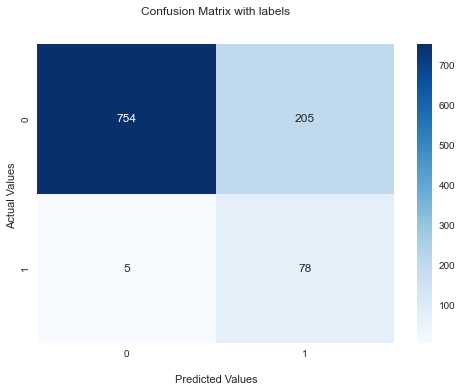

In [168]:
predicted_valid = yhat > 0.2
print(classification_report(target_test_0, predicted_valid))

#confusion_matrix
conf_log_b= confusion_matrix(target_test_0, predicted_valid)

ax = sns.heatmap(conf_log_b, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
plt.show()

Precision 27%. The model predicted correctly only 27% of the cases.

Recall 94%. the model was able to recognize 94% of the cases.

In total 72% of models predictions were false alarms. In this case, 206 people would have to investigated further (maybe they have small amount of savings). But only 5 people were missed. 78 people were correctly detected as have 0 savings, and 753 (78%) were detected correctly as have more than USD 0 savings.

## Predict 3 classes - Low, Mid, High

In [169]:
#Create empty tuple for score
models_score_3 = {}

1. USD 0 - Low
2. USD 1-99 - Low
3. USD 100-999 - Low
4. USD 1,000-4,999 - Mid
5. USD 5,000-19,999 - Mid
6. USD 20,000-74,999 - High
7. USD 75,000 or more - High

In [170]:
#Convert 7 classes into 3 classes - train set
target_train_3 = [1 if x==1 else 1 if x==2 else 1 if x==3 else 2 if x==4 else 2 if x==5 else 3 if x==6 else 3 for x in target_train]
target_train_3 = pd.Series(target_train_3, index=target_train.index)

#Convert 7 classes into 3 classes - test set
target_test_3 = [1 if x==1 else 1 if x==2 else 1 if x==3 else 2 if x==4 else 2 if x==5 else 3 if x==6 else 3 for x in target_test]
target_test_3 = pd.Series(target_test_3, index=target_test.index)

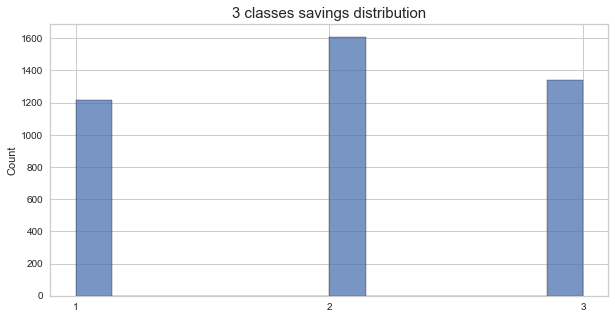

In [171]:
fig, ax = plt.subplots(figsize=(10, 5))
sns.histplot(target_train_3, ax=ax)
plt.title('3 classes savings distribution', size=15)
plt.xticks(np.arange(min(target_train_3), max(target_train_3)+1, 1.0))
plt.show()

The seems more balance than not.

### Logistic regression

In [172]:
pipe = Pipeline([('model',LogisticRegression())])

log_reg_3 = best_model(pipe, {}, features_train_full_mice, target_train_3)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END ..............., score=(train=0.700, test=0.681) total time=   0.2s
[CV 2/5] END ..............., score=(train=0.704, test=0.653) total time=   0.2s
[CV 3/5] END ..............., score=(train=0.702, test=0.666) total time=   0.2s
[CV 4/5] END ..............., score=(train=0.703, test=0.663) total time=   0.2s
[CV 5/5] END ..............., score=(train=0.689, test=0.695) total time=   0.2s

Best parameters: {}

Best score: 0.67


In [173]:
y_pred_lr_3 = log_reg_3.predict(features_test_full_mice)

In [174]:
print(classification_report(target_test_3, y_pred_lr_3, target_names=['Low',
                                                               'Mid','High']))

              precision    recall  f1-score   support

         Low       0.77      0.73      0.75       290
         Mid       0.62      0.61      0.61       416
        High       0.69      0.74      0.71       336

    accuracy                           0.68      1042
   macro avg       0.69      0.69      0.69      1042
weighted avg       0.69      0.68      0.68      1042



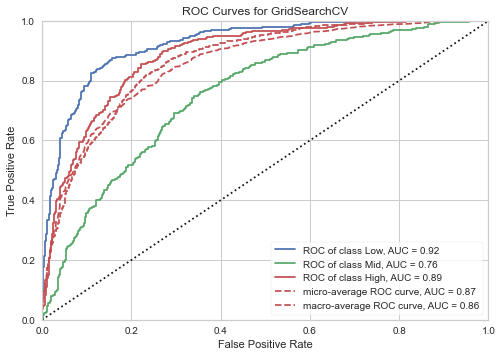

In [175]:
visual_3 = plot_ROC_curve_3(log_reg_3, features_train_full_mice, target_train_3, features_test_full_mice, target_test_3)

In [176]:
#Save f1 weighted scores:
models_score_3['Logistic_regression'] = [round(log_reg_3.cv_results_['mean_train_score'].mean(),2),
                            round(log_reg_3.cv_results_['mean_test_score'].mean(),2),
                                       round(f1_score(target_test_3, y_pred_lr_3, average='weighted'),2)]

### SVC

In [177]:
%%time

# C - Regularization parameter. The strength of the regularization is inversely proportional to C. 
# Must be strictly positive. The penalty is a squared l2 penalty.

# gamma - The gamma parameters can be seen as the inverse of the radius of influence of 
# samples selected by the model as support vectors. When gamma is very small, the model is too constrained and cannot capture 
# the complexity or “shape” of the data.  
#Gamma essentially controls the distance of influence of a single training point.
#-Low values of Gamma indicate a large similarity radius which results in more points being grouped together.
#-For High values of Gamma, the points need to be very close to each other in order for it to be considered in the same group.


pipe = Pipeline([('scaler',StandardScaler()),('model',SVC())])

param_grid = {'model__C': [1, 1.5],
              'model__gamma':[0.005, 0.01,'scale','auto'],
              'model__kernel': ['rbf'], 'model__probability':[True]}

svc_3 = best_model(pipe, param_grid, features_train_full_mice, target_train_3)

Fitting 5 folds for each of 8 candidates, totalling 40 fits
[CV 1/5] END model__C=1, model__gamma=0.005, model__kernel=rbf, model__probability=True;, score=(train=0.840, test=0.680) total time=   6.1s
[CV 2/5] END model__C=1, model__gamma=0.005, model__kernel=rbf, model__probability=True;, score=(train=0.843, test=0.666) total time=   5.4s
[CV 3/5] END model__C=1, model__gamma=0.005, model__kernel=rbf, model__probability=True;, score=(train=0.835, test=0.690) total time=   6.1s
[CV 4/5] END model__C=1, model__gamma=0.005, model__kernel=rbf, model__probability=True;, score=(train=0.836, test=0.684) total time=   5.8s
[CV 5/5] END model__C=1, model__gamma=0.005, model__kernel=rbf, model__probability=True;, score=(train=0.842, test=0.700) total time=   6.0s
[CV 1/5] END model__C=1, model__gamma=0.01, model__kernel=rbf, model__probability=True;, score=(train=0.932, test=0.665) total time=   7.0s
[CV 2/5] END model__C=1, model__gamma=0.01, model__kernel=rbf, model__probability=True;, score=

In [178]:
y_pred_svc_3 = svc_3.predict(features_test_full_mice)


print(classification_report(target_test_3, y_pred_svc_3, target_names=['Low',
                                                               'Mid','High']))

              precision    recall  f1-score   support

         Low       0.77      0.74      0.76       290
         Mid       0.62      0.61      0.62       416
        High       0.70      0.74      0.72       336

    accuracy                           0.69      1042
   macro avg       0.70      0.70      0.70      1042
weighted avg       0.69      0.69      0.69      1042



In [179]:
#Save f1 weighted scores:
models_score_3['SVC'] = [round(svc_3.cv_results_['mean_train_score'].mean(),2),
                            round(svc_3.cv_results_['mean_test_score'].mean(),2),
                                       round(f1_score(target_test_3, y_pred_svc_3, average='weighted'),2)]

### Random Forest

In [180]:
%%time
# n_estimators - This is the number of trees
# max_depth - The maximum depth of the tree. Need to restriced to avoid overfitting
pipe = Pipeline([('model',RandomForestClassifier(random_state=12345))])

rf_3 = best_model(pipe, {'model__n_estimators' : [100, 200],
                        'model__max_depth' : [5,8],
                      'model__min_samples_split':[10, 20],
                      'model__min_samples_leaf':[10,20]}, features_train_full_mice, target_train_3)

Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV 1/5] END model__max_depth=5, model__min_samples_leaf=10, model__min_samples_split=10, model__n_estimators=100;, score=(train=0.701, test=0.653) total time=   0.4s
[CV 2/5] END model__max_depth=5, model__min_samples_leaf=10, model__min_samples_split=10, model__n_estimators=100;, score=(train=0.707, test=0.658) total time=   0.4s
[CV 3/5] END model__max_depth=5, model__min_samples_leaf=10, model__min_samples_split=10, model__n_estimators=100;, score=(train=0.703, test=0.670) total time=   0.3s
[CV 4/5] END model__max_depth=5, model__min_samples_leaf=10, model__min_samples_split=10, model__n_estimators=100;, score=(train=0.710, test=0.671) total time=   0.3s
[CV 5/5] END model__max_depth=5, model__min_samples_leaf=10, model__min_samples_split=10, model__n_estimators=100;, score=(train=0.703, test=0.663) total time=   0.4s
[CV 1/5] END model__max_depth=5, model__min_samples_leaf=10, model__min_samples_split=10, model__n_estim

In [181]:
y_pred_rf_3 = rf_3.predict(features_test_full_mice)


print(classification_report(target_test_3, y_pred_rf_3, target_names=['Low',
                                                               'Mid','High']))

              precision    recall  f1-score   support

         Low       0.79      0.73      0.76       290
         Mid       0.61      0.63      0.62       416
        High       0.70      0.71      0.71       336

    accuracy                           0.69      1042
   macro avg       0.70      0.69      0.70      1042
weighted avg       0.69      0.69      0.69      1042



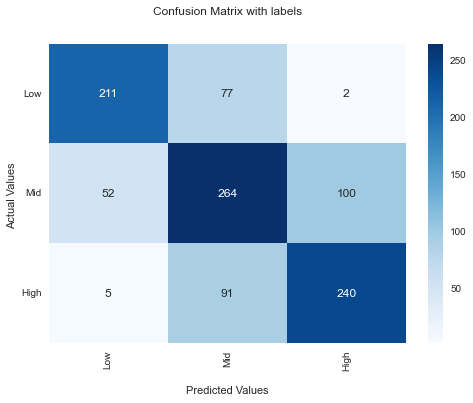

In [182]:
#confusion_matrix
conf_rf_3= confusion_matrix(target_test_3, y_pred_rf_3)

ax = sns.heatmap(conf_rf_3, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.set_xticklabels(['Low','Mid','High'])
ax.set_yticklabels(['Low','Mid','High'])
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

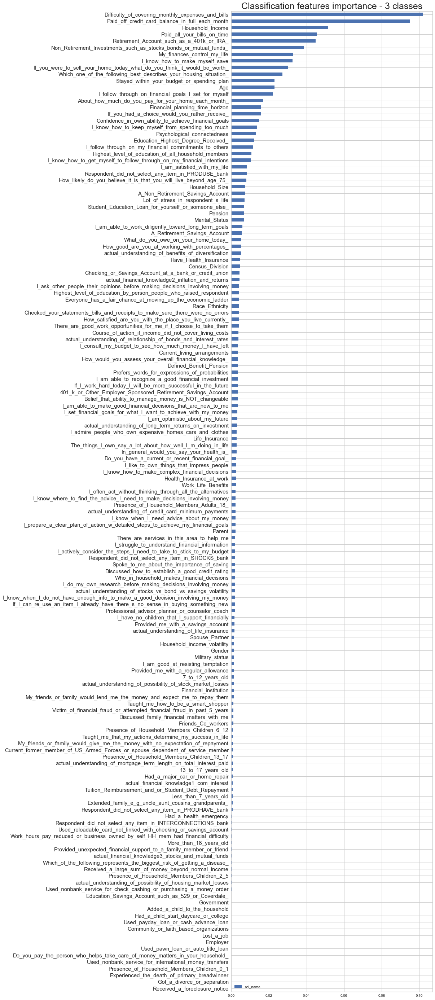

In [183]:
feature_importance_3_classes = pd.DataFrame({'col_name': rf_3.best_estimator_[0].feature_importances_}, index=features_train_full_mice.columns).sort_values(by='col_name', ascending=False)

fig, ax = plt.subplots(figsize =(10, 50))
feature_importance_3_classes.sort_values(by='col_name',ascending=True).plot(kind='barh', ax=ax)
plt.title('Classification features importance - 3 classes', size=25)
ax.tick_params(axis='y', labelsize=15)
plt.show()

In [184]:
%%time
#See explanation for test set
explainer_3 = shap.TreeExplainer(rf_3.best_estimator_[0])
shap_values_3 = explainer_3.shap_values(features_test_full_mice)

Wall time: 9.51 s


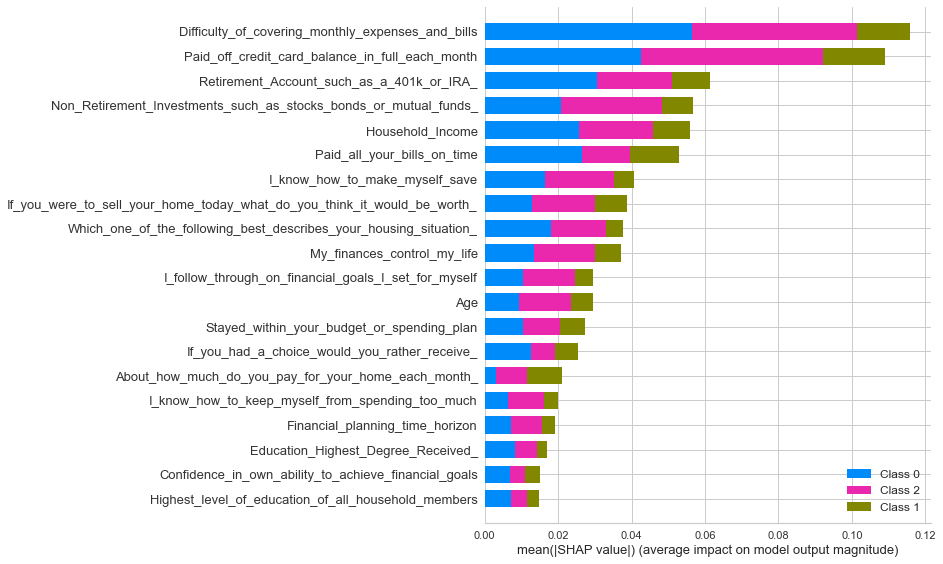

In [185]:
shap.summary_plot(shap_values_3, features_test_full_mice.values, feature_names = features_test_full_mice.columns)

Class: Low


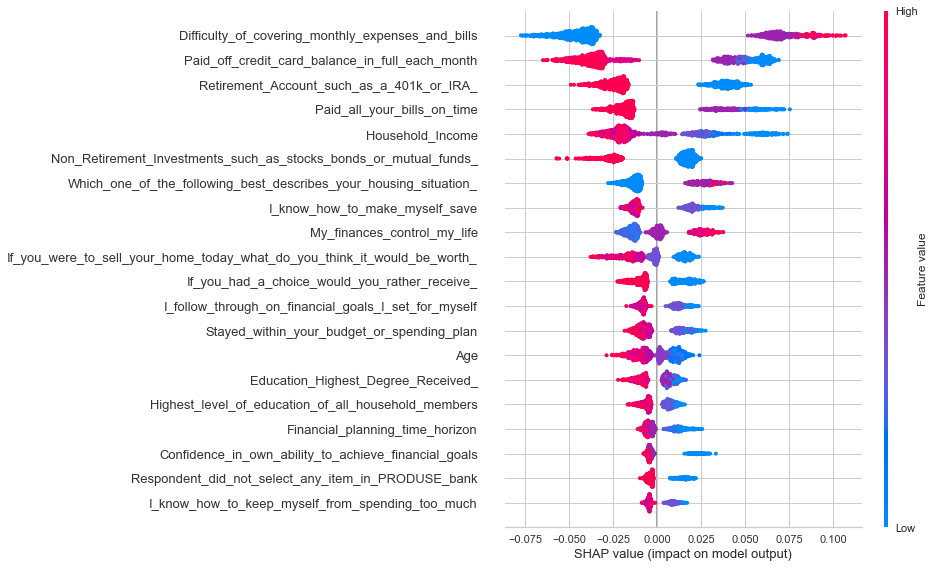

Class: Mid


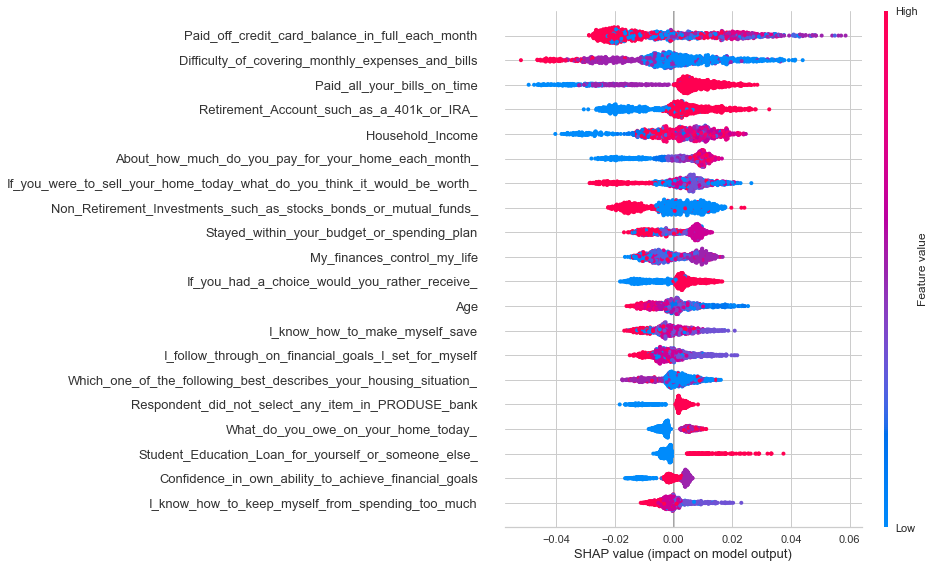

Class: High


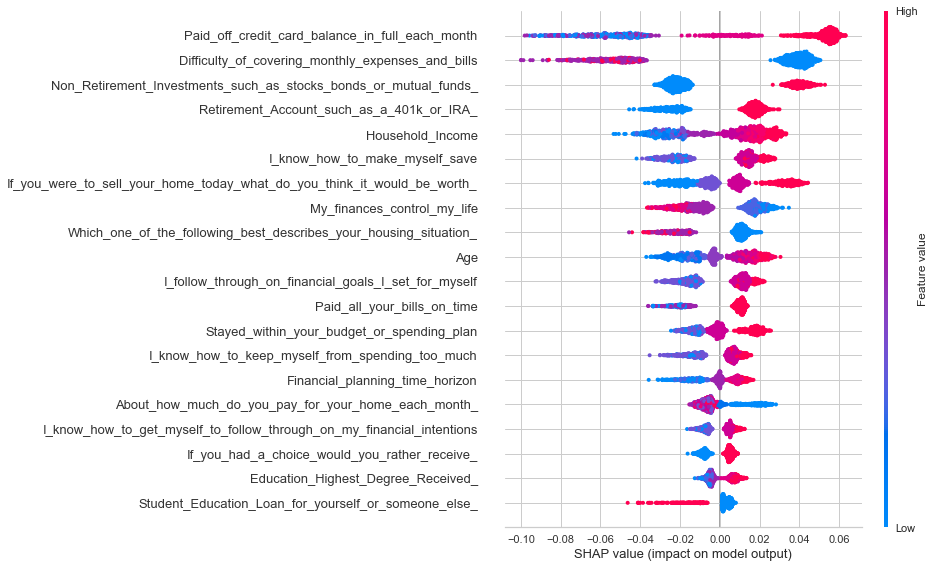

In [186]:
classes_3={1: 'Low',
2: 'Mid', 
3: 'High'}

for i in range(1,4):
    print('Class:', classes_3[i])
    shap.summary_plot(shap_values_3[i-1], features_test_full_mice.values, feature_names = features_test_full_mice.columns)

### ELI5 - 3 classes - test set

In [187]:
perm_3 = PermutationImportance(rf_3.best_estimator_[0], scoring = 'f1_weighted' ,random_state=42).fit(features_test_full_mice, target_test_3)

In [188]:
show_weights(perm_3, feature_names = list(features_test_full_mice.columns))

Weight,Feature
0.0229 ± 0.0121,Paid_off_credit_card_balance_in_full_each_month
0.0138 ± 0.0188,Difficulty_of_covering_monthly_expenses_and_bills
0.0049 ± 0.0042,Non_Retirement_Investments_such_as_stocks_bonds_or_mutual_funds_
0.0032 ± 0.0020,Life_Insurance
0.0025 ± 0.0015,Pension
0.0023 ± 0.0020,Race_Ethnicity
0.0019 ± 0.0086,Retirement_Account_such_as_a_401k_or_IRA_
0.0016 ± 0.0014,I_know_when_I_do_not_have_enough_info_to_make_a_good_decision_involving_my_money
0.0015 ± 0.0017,I_ask_other_people_their_opinions_before_making_decisions_involving_money
0.0013 ± 0.0073,Which_one_of_the_following_best_describes_your_housing_situation_


### ELI5 - 3 classes - train set

If you don’t have a separate held-out dataset, you can fit PermutationImportance on the same data as used for training; this still allows to inspect the model, **but doesn’t show which features are important for generalization**.

In [189]:
perm_3_train = PermutationImportance(rf_3.best_estimator_[0], scoring = 'f1_weighted' ,random_state=42).fit(features_train_full_mice, target_train_3)

In [190]:
show_weights(perm_3_train, feature_names = list(features_train_full_mice.columns))

Weight,Feature
0.0370 ± 0.0076,Paid_off_credit_card_balance_in_full_each_month
0.0255 ± 0.0050,Difficulty_of_covering_monthly_expenses_and_bills
0.0122 ± 0.0038,Household_Income
0.0116 ± 0.0021,If_you_were_to_sell_your_home_today_what_do_you_think_it_would_be_worth_
0.0097 ± 0.0039,Retirement_Account_such_as_a_401k_or_IRA_
0.0087 ± 0.0020,Age
0.0081 ± 0.0040,Non_Retirement_Investments_such_as_stocks_bonds_or_mutual_funds_
0.0075 ± 0.0029,Paid_all_your_bills_on_time
0.0071 ± 0.0019,If_you_had_a_choice_would_you_rather_receive_
0.0064 ± 0.0021,Financial_planning_time_horizon


### Partial dependencies - class 1 (low)

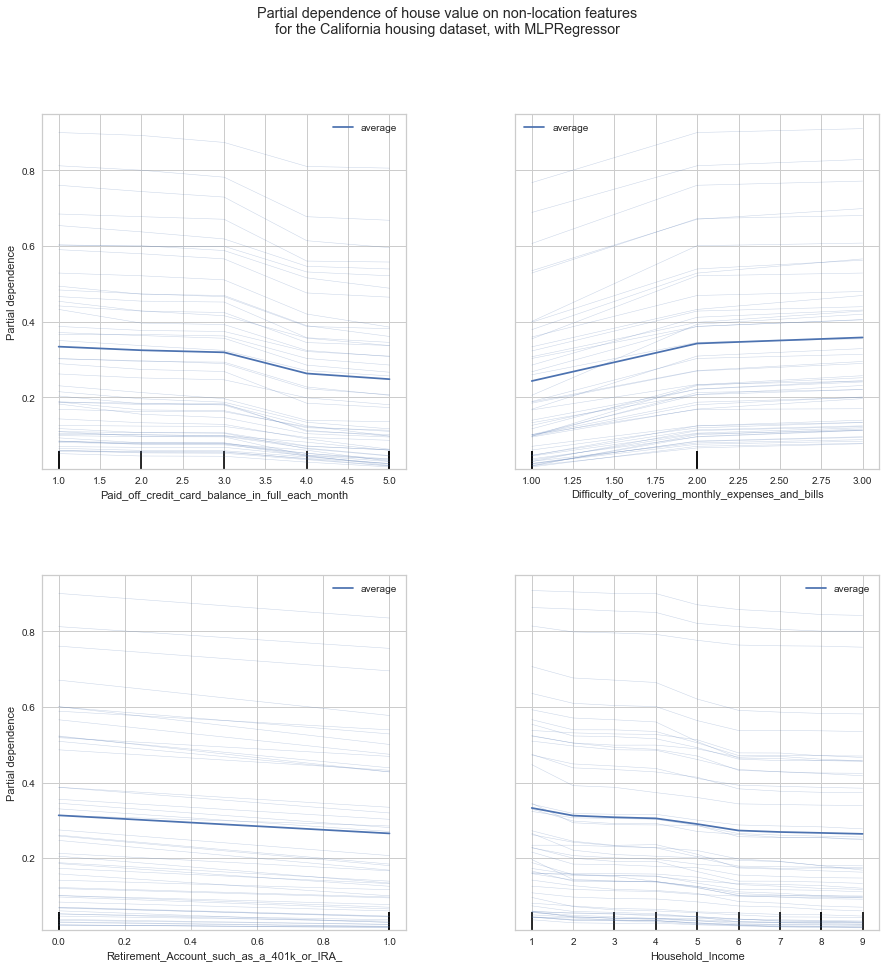

In [191]:
f, axs = plt.subplots(2,2,figsize=(15,15))

common_params = {
    "subsample": 50,
    "n_jobs": 2,
    "grid_resolution": 20,
    "random_state": 0,
}


display = PartialDependenceDisplay.from_estimator(
    rf_3.best_estimator_[0],
    features_train_full_mice,
    features=["Paid_off_credit_card_balance_in_full_each_month", "Difficulty_of_covering_monthly_expenses_and_bills",
              "Retirement_Account_such_as_a_401k_or_IRA_", "Household_Income"],
    kind="both",
    target=1,
    **common_params, ax=axs
)

display.figure_.suptitle(
    "Partial dependence of house value on non-location features\n"
    "for the California housing dataset, with MLPRegressor"
)
display.figure_.subplots_adjust(hspace=0.3, wspace=0.3)

### Partial dependencies - class 2 (Mid)

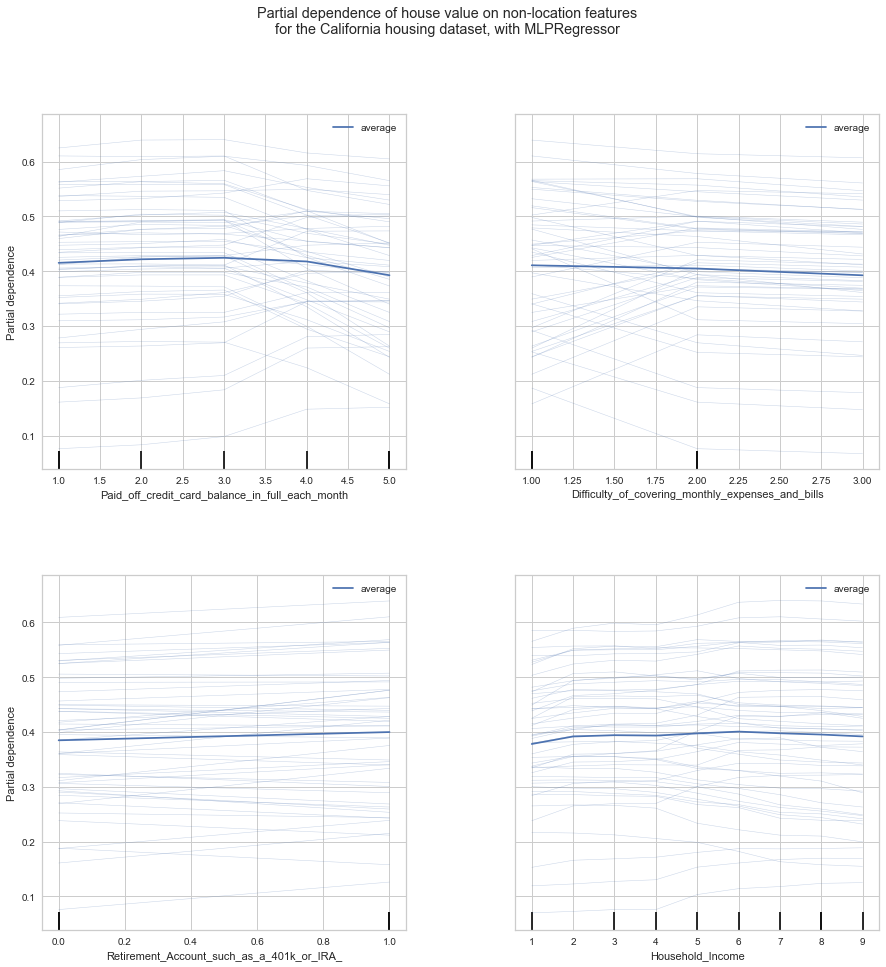

In [192]:
f, axs = plt.subplots(2,2,figsize=(15,15))

common_params = {
    "subsample": 50,
    "n_jobs": 2,
    "grid_resolution": 20,
    "random_state": 0,
}


display = PartialDependenceDisplay.from_estimator(
    rf_3.best_estimator_[0],
    features_train_full_mice,
    features=["Paid_off_credit_card_balance_in_full_each_month", "Difficulty_of_covering_monthly_expenses_and_bills",
              "Retirement_Account_such_as_a_401k_or_IRA_", "Household_Income"],
    kind="both",
    target=2,
    **common_params, ax=axs
)

display.figure_.suptitle(
    "Partial dependence of house value on non-location features\n"
    "for the California housing dataset, with MLPRegressor"
)
display.figure_.subplots_adjust(hspace=0.3, wspace=0.3)

### Partial dependencies - class 3 (high)

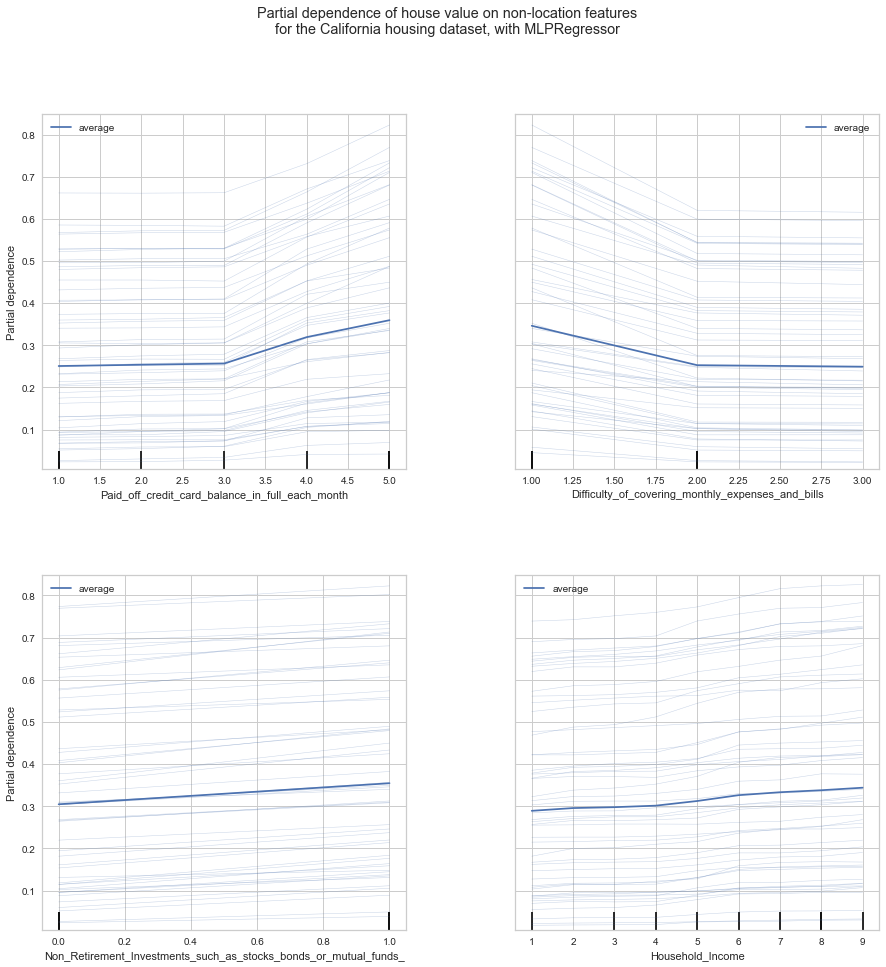

In [193]:
f, axs = plt.subplots(2,2,figsize=(15,15))

common_params = {
    "subsample": 50,
    "n_jobs": 2,
    "grid_resolution": 20,
    "random_state": 0,
}


display = PartialDependenceDisplay.from_estimator(
    rf_3.best_estimator_[0],
    features_train_full_mice,
    features=["Paid_off_credit_card_balance_in_full_each_month", "Difficulty_of_covering_monthly_expenses_and_bills",
              "Non_Retirement_Investments_such_as_stocks_bonds_or_mutual_funds_", "Household_Income"],
    kind="both",
    target=3,
    **common_params, ax=axs
)

display.figure_.suptitle(
    "Partial dependence of house value on non-location features\n"
    "for the California housing dataset, with MLPRegressor"
)
display.figure_.subplots_adjust(hspace=0.3, wspace=0.3)

In [194]:
#Save f1 weighted scores:
models_score_3['Random_forest'] = [round(rf_3.cv_results_['mean_train_score'].mean(),2),
                            round(rf_3.cv_results_['mean_test_score'].mean(),2),
                                       round(f1_score(target_test_3, y_pred_rf_3, average='weighted'),2)]

## 3 Classes results

In [195]:
pd.DataFrame.from_dict(models_score_3, orient='index', columns=['Train F1 weighted',
                                                              'Valid F1 weighted','Test F1 weighted']).sort_values(by='Test F1 weighted', ascending=False)

,Train F1 weighted,Valid F1 weighted,Test F1 weighted
SVC,0.90,0.68,0.69
Random_forest,0.73,0.67,0.69
Logistic_regression,0.70,0.67,0.68


# Try to improve test f1 weighted of 69% 

## Clustering - Kmeans

In this part we are going to try cluster observations with Kmeans and examine f1 score. Then we will try to use the output as a feature.

In [196]:
from sklearn.cluster import KMeans

In [197]:
kmeans_mdoel = KMeans(n_clusters=3, random_state=42)

In [198]:
kmeans_mdoel.fit(features_train_full_mice)

KMeans(n_clusters=3, random_state=42)

In [199]:
print(np.unique(kmeans_mdoel.labels_+1))

[1 2 3]


In [200]:
print(kmeans_mdoel.labels_+1)

[1 1 1 ... 2 1 3]


In [201]:
train_cluster = pd.Series(data = kmeans_mdoel.labels_+1, index = target_train_3.index)

In [202]:
cluster_pred = kmeans_mdoel.predict(features_test_full_mice)

test_cluster = pd.Series(data = cluster_pred+1, index = target_test_3.index)

In [203]:
#Train f1 weighted score
f1_score(train_cluster, target_train_3, average='weighted')

0.20581944163117022

In [204]:
#Test f1 weighted score
f1_score(test_cluster, target_test_3, average='weighted')

0.2294073335099913

In [205]:
#Add cluster feature to train set
features_train_cluster = features_train_full_mice.merge(train_cluster.rename('features_train_cluster'), left_index=True, right_index=True)

#Add cluster feature to test set
features_test_cluster = features_test_full_mice.merge(test_cluster.rename('features_test_cluster'), left_index=True, right_index=True)

### SVC with cluster feature

In [206]:
svc_3.best_params_

{'model__C': 1,
 'model__gamma': 0.005,
 'model__kernel': 'rbf',
 'model__probability': True}

In [207]:
%%time

# C - Regularization parameter. The strength of the regularization is inversely proportional to C. 
# Must be strictly positive. The penalty is a squared l2 penalty.

# gamma - The gamma parameters can be seen as the inverse of the radius of influence of 
# samples selected by the model as support vectors. When gamma is very small, the model is too constrained and cannot capture 
# the complexity or “shape” of the data.  
#Gamma essentially controls the distance of influence of a single training point.
#-Low values of Gamma indicate a large similarity radius which results in more points being grouped together.
#-For High values of Gamma, the points need to be very close to each other in order for it to be considered in the same group.


pipe = Pipeline([('scaler',StandardScaler()),('model',SVC())])

param_grid = {'model__C': [1],
              'model__gamma':[0.005],
              'model__kernel': ['rbf'], 'model__probability':[True]}

svc_3_cluster = best_model(pipe, param_grid, features_train_cluster, target_train_3)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END model__C=1, model__gamma=0.005, model__kernel=rbf, model__probability=True;, score=(train=0.842, test=0.676) total time=   7.9s
[CV 2/5] END model__C=1, model__gamma=0.005, model__kernel=rbf, model__probability=True;, score=(train=0.844, test=0.661) total time=   6.6s
[CV 3/5] END model__C=1, model__gamma=0.005, model__kernel=rbf, model__probability=True;, score=(train=0.835, test=0.691) total time=   6.3s
[CV 4/5] END model__C=1, model__gamma=0.005, model__kernel=rbf, model__probability=True;, score=(train=0.838, test=0.688) total time=   6.8s
[CV 5/5] END model__C=1, model__gamma=0.005, model__kernel=rbf, model__probability=True;, score=(train=0.843, test=0.695) total time=   7.5s

Best parameters: {'model__C': 1, 'model__gamma': 0.005, 'model__kernel': 'rbf', 'model__probability': True}

Best score: 0.68
Wall time: 57.1 s


In [208]:
y_pred_svc_3_cluster = svc_3_cluster.predict(features_test_cluster)


print(classification_report(target_test_3, y_pred_svc_3_cluster, target_names=['Low',
                                                               'Mid','High']))

              precision    recall  f1-score   support

         Low       0.78      0.74      0.76       290
         Mid       0.63      0.62      0.62       416
        High       0.70      0.74      0.72       336

    accuracy                           0.69      1042
   macro avg       0.70      0.70      0.70      1042
weighted avg       0.69      0.69      0.69      1042



No improvment of the model when using Kmeans clustering as a feature with SVC model.

In [209]:
models_score_3['SVC_Kmeans'] = [round(svc_3_cluster.cv_results_['mean_train_score'].mean(),2),
                            round(svc_3_cluster.cv_results_['mean_test_score'].mean(),2),
                                       round(f1_score(target_test_3, y_pred_svc_3_cluster, average='weighted'),2)]

### Clustering - Kmodes

In [210]:
from kmodes.kmodes import KModes

In [211]:
km = KModes(n_clusters=3, init='Huang', n_init=5, verbose=1)

km_clusters = km.fit_predict(features_train_full_mice)

Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 1170, cost: 219581.0
Run 1, iteration: 2/100, moves: 250, cost: 219511.0
Run 1, iteration: 3/100, moves: 147, cost: 219403.0
Run 1, iteration: 4/100, moves: 148, cost: 219338.0
Run 1, iteration: 5/100, moves: 212, cost: 218963.0
Run 1, iteration: 6/100, moves: 285, cost: 218798.0
Run 1, iteration: 7/100, moves: 230, cost: 218534.0
Run 1, iteration: 8/100, moves: 186, cost: 218477.0
Run 1, iteration: 9/100, moves: 51, cost: 218477.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 1474, cost: 216788.0
Run 2, iteration: 2/100, moves: 370, cost: 216629.0
Run 2, iteration: 3/100, moves: 107, cost: 216609.0
Run 2, iteration: 4/100, moves: 6, cost: 216609.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 3, iteration: 1/100, moves: 1655, cost: 219633.0
Run 3, iteration: 2/100, moves: 

In [212]:
np.unique(km_clusters+1)

array([1, 2, 3], dtype=uint16)

In [213]:
#Train f1 weighted score
f1_score(km_clusters+1, target_train_3, average='weighted')

0.14939569633154015

In [214]:
test_cluster_kmodes = km.predict(features_test_full_mice)

In [215]:
#Test f1 weighted score
f1_score(test_cluster_kmodes+1, target_test_3, average='weighted')

0.1481832775309361

Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 0, cost: 58712.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 0, cost: 58712.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 3, iteration: 1/100, moves: 0, cost: 58712.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 4, iteration: 1/100, moves: 0, cost: 58712.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 5, iteration: 1/100, moves: 0, cost: 58712.0
Best run was number 1
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 267, cost: 55999.0
Run 1, iteration: 2/100, moves: 123, cost: 55640.0
Run 1, iteration: 3/100, moves: 110, cost: 55370.0
Run 1, iteration: 4/100, moves: 44, cost: 55358.0
Run 1, iteration: 5/100, moves: 3, cost: 55358.0
I

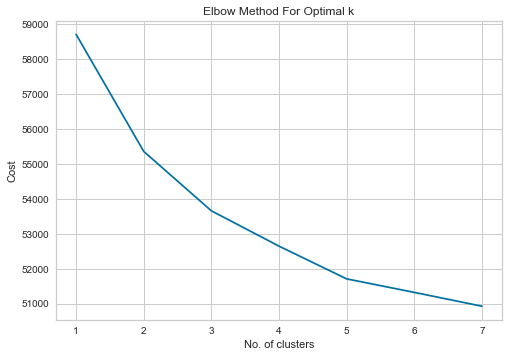

In [216]:
# Elbow curve to find optimal K
cost = []
K = range(1,8)
for num_clusters in list(K):
    kmode = KModes(n_clusters=num_clusters, init = "random", n_init = 5, verbose=1)
    kmode.fit_predict(features_test_full_mice)
    cost.append(kmode.cost_)
    
plt.plot(K, cost, 'bx-')
plt.xlabel('No. of clusters')
plt.ylabel('Cost')
plt.title('Elbow Method For Optimal k')
plt.show()

We can see bend at 5, we will use it as a feature.

In [217]:
km = KModes(n_clusters=5, init='Huang', n_init=5, verbose=1)

km_clusters = km.fit_predict(features_train_full_mice)

Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 2106, cost: 212605.0
Run 1, iteration: 2/100, moves: 1036, cost: 210728.0
Run 1, iteration: 3/100, moves: 438, cost: 210349.0
Run 1, iteration: 4/100, moves: 246, cost: 210238.0
Run 1, iteration: 5/100, moves: 55, cost: 210238.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 1663, cost: 214757.0
Run 2, iteration: 2/100, moves: 501, cost: 214406.0
Run 2, iteration: 3/100, moves: 271, cost: 214215.0
Run 2, iteration: 4/100, moves: 201, cost: 214110.0
Run 2, iteration: 5/100, moves: 101, cost: 214110.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 3, iteration: 1/100, moves: 1970, cost: 213371.0
Run 3, iteration: 2/100, moves: 692, cost: 212716.0
Run 3, iteration: 3/100, moves: 431, cost: 212413.0
Run 3, iteration: 4/100, moves: 182, cost: 212385.0
Run 3, iteration: 5/100, move

In [218]:
np.unique(km_clusters)

array([0, 1, 2, 3, 4], dtype=uint16)

In [219]:
test_cluster_kmodes = km.predict(features_test_full_mice)

In [220]:
#Create series with train clusters
train_cluster_km = pd.Series(data = km.labels_, index = target_train_3.index)

In [221]:
#Create series with test clusters
test_cluster_km = pd.Series(data = test_cluster_kmodes, index = target_test_3.index)

In [222]:
#Add cluster feature to train set
features_train_cluster_km = features_train_full_mice.merge(train_cluster.rename('features_train_cluster_km'), left_index=True, right_index=True)

#Add cluster feature to test set
features_test_cluster_km = features_test_full_mice.merge(test_cluster.rename('features_train_cluster_km'), left_index=True, right_index=True)

### SVM with Kmodes feature

In [223]:
%%time

# C - Regularization parameter. The strength of the regularization is inversely proportional to C. 
# Must be strictly positive. The penalty is a squared l2 penalty.

# gamma - The gamma parameters can be seen as the inverse of the radius of influence of 
# samples selected by the model as support vectors. When gamma is very small, the model is too constrained and cannot capture 
# the complexity or “shape” of the data.  

#Gamma essentially controls the distance of influence of a single training point.
#-Low values of Gamma indicate a large similarity radius which results in more points being grouped together.
#-For High values of Gamma, the points need to be very close to each other in order for it to be considered in the same group.


pipe = Pipeline([('scaler',StandardScaler()),('model',SVC())])

param_grid = {'model__C': [1],
              'model__gamma':[0.005],
              'model__kernel': ['rbf'], 'model__probability':[True]}

svc_3_cluster_km = best_model(pipe, param_grid, features_train_cluster_km, target_train_3)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END model__C=1, model__gamma=0.005, model__kernel=rbf, model__probability=True;, score=(train=0.842, test=0.676) total time=   8.0s
[CV 2/5] END model__C=1, model__gamma=0.005, model__kernel=rbf, model__probability=True;, score=(train=0.844, test=0.661) total time=   6.9s
[CV 3/5] END model__C=1, model__gamma=0.005, model__kernel=rbf, model__probability=True;, score=(train=0.835, test=0.691) total time=   6.7s
[CV 4/5] END model__C=1, model__gamma=0.005, model__kernel=rbf, model__probability=True;, score=(train=0.838, test=0.688) total time=   6.6s
[CV 5/5] END model__C=1, model__gamma=0.005, model__kernel=rbf, model__probability=True;, score=(train=0.843, test=0.695) total time=   7.2s

Best parameters: {'model__C': 1, 'model__gamma': 0.005, 'model__kernel': 'rbf', 'model__probability': True}

Best score: 0.68
Wall time: 57.4 s


In [224]:
y_pred_svc_3_cluster_km = svc_3_cluster_km.predict(features_test_cluster_km)


print(classification_report(target_test_3, y_pred_svc_3_cluster_km, target_names=['Low',
                                                               'Mid','High']))

              precision    recall  f1-score   support

         Low       0.78      0.74      0.76       290
         Mid       0.63      0.62      0.62       416
        High       0.70      0.74      0.72       336

    accuracy                           0.69      1042
   macro avg       0.70      0.70      0.70      1042
weighted avg       0.69      0.69      0.69      1042



No improvment of the model when using Kmodes clustering as a feature with SVC model.

In [225]:
models_score_3['SVC_Kmodes'] = [round(svc_3_cluster_km.cv_results_['mean_train_score'].mean(),2),
                            round(svc_3_cluster_km.cv_results_['mean_test_score'].mean(),2),
                                       round(f1_score(target_test_3, y_pred_svc_3_cluster_km, average='weighted'),2)]

### Random forest with Kmode feature

In [226]:
%%time
# n_estimators - This is the number of trees
# max_depth - The maximum depth of the tree. Need to restriced to avoid overfitting
pipe = Pipeline([('model',RandomForestClassifier(random_state=12345))])

rf_3_km = best_model(pipe, {'model__n_estimators' : [100, 200],
                        'model__max_depth' : [5,8],
                      'model__min_samples_split':[10, 20],
                      'model__min_samples_leaf':[10,20]}, features_train_cluster_km, target_train_3)

Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV 1/5] END model__max_depth=5, model__min_samples_leaf=10, model__min_samples_split=10, model__n_estimators=100;, score=(train=0.702, test=0.660) total time=   0.3s
[CV 2/5] END model__max_depth=5, model__min_samples_leaf=10, model__min_samples_split=10, model__n_estimators=100;, score=(train=0.707, test=0.658) total time=   0.3s
[CV 3/5] END model__max_depth=5, model__min_samples_leaf=10, model__min_samples_split=10, model__n_estimators=100;, score=(train=0.703, test=0.675) total time=   0.3s
[CV 4/5] END model__max_depth=5, model__min_samples_leaf=10, model__min_samples_split=10, model__n_estimators=100;, score=(train=0.706, test=0.662) total time=   0.4s
[CV 5/5] END model__max_depth=5, model__min_samples_leaf=10, model__min_samples_split=10, model__n_estimators=100;, score=(train=0.704, test=0.667) total time=   0.4s
[CV 1/5] END model__max_depth=5, model__min_samples_leaf=10, model__min_samples_split=10, model__n_estim

In [227]:
y_pred_rf_3_km = rf_3_km.predict(features_test_cluster_km)


print(classification_report(target_test_3, y_pred_rf_3_km, target_names=['Low',
                                                               'Mid','High']))

              precision    recall  f1-score   support

         Low       0.78      0.74      0.76       290
         Mid       0.61      0.64      0.62       416
        High       0.71      0.71      0.71       336

    accuracy                           0.69      1042
   macro avg       0.70      0.69      0.70      1042
weighted avg       0.69      0.69      0.69      1042



No improvment of the model when using Kmodes clustering as a feature with Random Forest model.

In [228]:
models_score_3['Random_forest_Kmodes'] = [round(rf_3_km.cv_results_['mean_train_score'].mean(),2),
                            round(rf_3_km.cv_results_['mean_test_score'].mean(),2),
                                       round(f1_score(target_test_3, y_pred_rf_3_km, average='weighted'),2)]

## Neural Networks - 7 classes

In [290]:
from tensorflow.keras.models import Sequential 
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Dense, Dropout, Activation
from tensorflow.keras import metrics

In [291]:
#We will use the common optimizer - Adam with learning rate of 0.001
optimizer = Adam(learning_rate=0.001)

In [292]:
model_nn = Sequential() 

#Layer 1
model_nn.add(Dense(input_shape = (features_train_full_mice.shape[-1],), activation="relu", units=features_train_full_mice.shape[-1]))
model_nn.add(Dropout(0.5))


#Layer 2
model_nn.add(Dense(activation="relu", units=256))
model_nn.add(Dropout(0.5))


#Layer 3
model_nn.add(Dense(activation="relu", units=64))
model_nn.add(Dropout(0.5))


#Output layer range 1 - 7
model_nn.add(Dense(activation="softmax", units=8))

#Compiler
#For clasiffication problems use: sparse_categorical_crossentropy
# The data is balanced so we will use accuracy metrics
model_nn.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics='acc')

#Summary: Since batch size can vary, its size is represented by None
model_nn.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_8 (Dense)              (None, 148)               22052     
_________________________________________________________________
dropout_5 (Dropout)          (None, 148)               0         
_________________________________________________________________
dense_9 (Dense)              (None, 256)               38144     
_________________________________________________________________
dropout_6 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_10 (Dense)             (None, 64)                16448     
_________________________________________________________________
dropout_7 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_11 (Dense)             (None, 8)                

In [293]:
model_nn.fit(features_train_full_mice, target_train_all, 
          epochs=150, 
          batch_size=500, 
          validation_split=0.2,
          verbose=1)

Epoch 1/150
7/7 [==============================] - 0s 29ms/step - loss: 11.7818 - acc: 0.1524 - val_loss: 2.1093 - val_acc: 0.1859
Epoch 2/150
7/7 [==============================] - 0s 8ms/step - loss: 5.1785 - acc: 0.1596 - val_loss: 2.0710 - val_acc: 0.1223
Epoch 3/150
7/7 [==============================] - 0s 8ms/step - loss: 3.1525 - acc: 0.1515 - val_loss: 2.0743 - val_acc: 0.0635
Epoch 4/150
7/7 [==============================] - 0s 8ms/step - loss: 2.4408 - acc: 0.1611 - val_loss: 2.0748 - val_acc: 0.1667
Epoch 5/150
7/7 [==============================] - 0s 9ms/step - loss: 2.2611 - acc: 0.1611 - val_loss: 2.0728 - val_acc: 0.1775
Epoch 6/150
7/7 [==============================] - 0s 8ms/step - loss: 2.1571 - acc: 0.1593 - val_loss: 2.0703 - val_acc: 0.1775
Epoch 7/150
7/7 [==============================] - 0s 7ms/step - loss: 2.1100 - acc: 0.1671 - val_loss: 2.0666 - val_acc: 0.1787
Epoch 8/150
7/7 [==============================] - 0s 7ms/step - loss: 2.0860 - acc: 0.1848 - v

In [233]:
#Get probabilities for each class
y_pred_nn = model_nn.predict(features_test_full_mice)

#Get the real class
y_pred_nn_results = pd.Series(np.argmax(y_pred_nn,axis = 1), name="pred_class")


#Print classification matrix
print(classification_report(target_test, y_pred_nn_results, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.43      0.69      0.53        83
          $1-99       0.00      0.00      0.00        74
       $100-999       0.32      0.30      0.31       133
   $1,000-4,999       0.38      0.52      0.44       180
  $5,000-19,999       0.42      0.34      0.38       236
 $20,000-74,999       0.35      0.52      0.42       165
$75,000 or more       0.65      0.42      0.51       171

       accuracy                           0.41      1042
      macro avg       0.37      0.40      0.37      1042
   weighted avg       0.40      0.41      0.39      1042



Using MLP (multilayer perceptron) of fully connected class of feedforword artificail neural network (ANN) was able to improve the results from f1 weighted average of 37% to 39%.

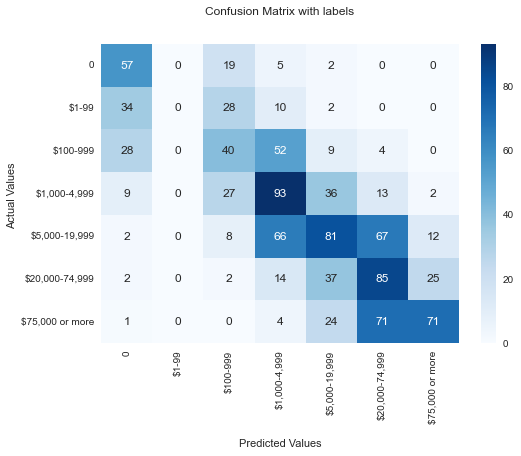

In [234]:
#confusion_matrix
conf_nn= confusion_matrix(target_test, y_pred_nn_results)

ax = sns.heatmap(conf_nn, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.set_xticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
ax.set_yticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

In [235]:
model_nn.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 148)               22052     
_________________________________________________________________
dropout (Dropout)            (None, 148)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 256)               38144     
_________________________________________________________________
dropout_1 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 64)                16448     
_________________________________________________________________
dropout_2 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_3 (Dense)              (None, 8)                 5

## Neural Networks - 3 classes

In [236]:
model_nn_3 = Sequential() 

#Layer 1
model_nn_3.add(Dense(input_shape = (features_train_full_mice.shape[-1],), activation="relu", units=features_train_full_mice.shape[-1]))

#Layer 2
model_nn_3.add(Dense(activation="relu", units=64))
model_nn_3.add(Dropout(0.5))

#Layer 3
model_nn_3.add(Dense(activation="relu", units=64))
#Drop random 50% of the nuerons
model_nn_3.add(Dropout(0.5))


#Output layer range 1 - 3
model_nn_3.add(Dense(activation="softmax", units=4))

#Compiler
#For clasiffication problems use: sparse_categorical_crossentropy
# The data is balanced so we will use accuracy metrics
model_nn_3.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics='acc')

#Summary: Since batch size can vary, its size is represented by None
model_nn_3.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 148)               22052     
_________________________________________________________________
dense_5 (Dense)              (None, 64)                9536      
_________________________________________________________________
dropout_3 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_6 (Dense)              (None, 64)                4160      
_________________________________________________________________
dropout_4 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_7 (Dense)              (None, 4)                 260       
Total params: 36,008
Trainable params: 36,008
Non-trainable params: 0
__________________________________________________

In [237]:
model_nn_3.fit(features_train_full_mice, target_train_3, 
          epochs=100, 
          batch_size=500, 
          validation_split=0.2,
          verbose=1)

Epoch 1/100
7/7 [==============================] - 0s 33ms/step - loss: 6.1122 - acc: 0.3101 - val_loss: 1.1554 - val_acc: 0.3933
Epoch 2/100
7/7 [==============================] - 0s 5ms/step - loss: 2.2807 - acc: 0.3317 - val_loss: 1.1686 - val_acc: 0.4245
Epoch 3/100
7/7 [==============================] - 0s 5ms/step - loss: 1.4097 - acc: 0.3710 - val_loss: 1.1259 - val_acc: 0.3969
Epoch 4/100
7/7 [==============================] - 0s 5ms/step - loss: 1.2644 - acc: 0.3644 - val_loss: 1.1361 - val_acc: 0.4676
Epoch 5/100
7/7 [==============================] - 0s 5ms/step - loss: 1.2289 - acc: 0.3692 - val_loss: 1.0891 - val_acc: 0.5108
Epoch 6/100
7/7 [==============================] - 0s 5ms/step - loss: 1.2150 - acc: 0.3815 - val_loss: 1.0508 - val_acc: 0.4880
Epoch 7/100
7/7 [==============================] - 0s 6ms/step - loss: 1.1800 - acc: 0.3875 - val_loss: 1.0583 - val_acc: 0.5096
Epoch 8/100
7/7 [==============================] - 0s 6ms/step - loss: 1.1501 - acc: 0.3977 - va

In [238]:
#Get probabilities for each class
y_pred_nn_3 = model_nn_3.predict(features_test_full_mice)

#Get the real class
y_pred_nn_results_3 = pd.Series(np.argmax(y_pred_nn_3,axis = 1), name="pred_class")


#Print classification matrix
print(classification_report(target_test_3, y_pred_nn_results_3, target_names=['Low','Mid','High']))

              precision    recall  f1-score   support

         Low       0.73      0.79      0.76       290
         Mid       0.62      0.65      0.64       416
        High       0.74      0.65      0.69       336

    accuracy                           0.69      1042
   macro avg       0.70      0.70      0.70      1042
weighted avg       0.69      0.69      0.69      1042



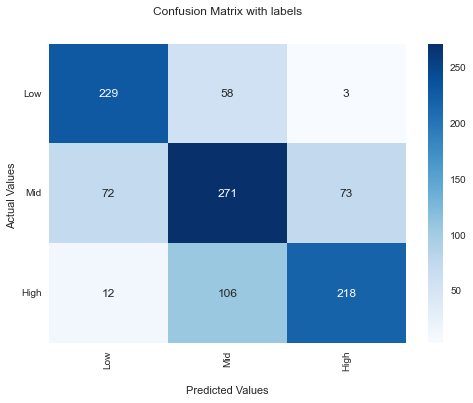

In [239]:
#confusion_matrix
conf_nn_3= confusion_matrix(target_test_3, y_pred_nn_results_3)

ax = sns.heatmap(conf_nn_3, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.set_xticklabels(['Low','Mid','High'])
ax.set_yticklabels(['Low','Mid','High'])
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

In [240]:
model_nn_3.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 148)               22052     
_________________________________________________________________
dense_5 (Dense)              (None, 64)                9536      
_________________________________________________________________
dropout_3 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_6 (Dense)              (None, 64)                4160      
_________________________________________________________________
dropout_4 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_7 (Dense)              (None, 4)                 260       
Total params: 36,008
Trainable params: 36,008
Non-trainable params: 0
__________________________________________________

In [241]:
models_score_3['Neural_networks_2L'] = [np.nan, np.nan,round(f1_score(target_test_3, y_pred_nn_results_3, average='weighted'),2)]

## Resutls 3 classes

In [242]:
pd.DataFrame.from_dict(models_score_3, orient='index', columns=['Train F1 weighted',
                                                              'Valid F1 weighted','Test F1 weighted']).sort_values(by='Test F1 weighted', ascending=False)

,Train F1 weighted,Valid F1 weighted,Test F1 weighted
SVC,0.90,0.68,0.69
Random_forest,0.73,0.67,0.69
SVC_Kmeans,0.84,0.68,0.69
SVC_Kmodes,0.84,0.68,0.69
Random_forest_Kmodes,0.73,0.67,0.69
Neural_networks_2L,NaN,NaN,0.69
Logistic_regression,0.70,0.67,0.68


# Conclusion - phase 2.0

The target is sharply divided into classes, making it very challanging to predict correctly.

We can't enhance our data with outside/online data. We removed some feature which caused target leakedge.

Human behavior not always predictable with high precision.

# Solve problem with regression

We have discrete oridnal varibels, 1 - 7, the results might improve using regression.

In [243]:
#Create empty tuple for score
models_score_regression = {}

### Linear regression

In [244]:
%%time
# n_estimators - number of boosting rounds that will be performed
# max_depth -  maximum distance between the root node of each tree and a leaf node
pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('model',LinearRegression())])

linear_regression = best_model_regression(pipe, {}, features_train_full_mice, target_train)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END ............., score=(train=-0.842, test=-0.890) total time=   0.1s
[CV 2/5] END ............., score=(train=-0.842, test=-0.880) total time=   0.0s
[CV 3/5] END ............., score=(train=-0.850, test=-0.872) total time=   0.0s
[CV 4/5] END ............., score=(train=-0.836, test=-0.903) total time=   0.0s
[CV 5/5] END ............., score=(train=-0.835, test=-0.880) total time=   0.0s

Best parameters: {}

Best score: 0.88
Wall time: 735 ms


In [245]:
y_pred_linear_regression = linear_regression.predict(features_test_full_mice)

In [246]:
#Look at predictions
y_pred_linear_regression

array([6.64841105, 5.86609987, 6.54078502, ..., 5.22426417, 4.85245828,
       2.50408207])

In [247]:
#Look at rounded predictions
np.unique(np.round(y_pred_linear_regression))

array([0., 1., 2., 3., 4., 5., 6., 7.])

We have values which were rounded to 0.

In [248]:
#Create a copy
y_pred_linear_regression_round = np.round(y_pred_linear_regression)

#Make 0 prediction to 1
for i in range(0,len(y_pred_linear_regression_round)):
    if y_pred_linear_regression_round[i]==0:
        y_pred_linear_regression_round[i] = 1

In [249]:
np.unique(y_pred_linear_regression_round)

array([1., 2., 3., 4., 5., 6., 7.])

In [250]:
print(classification_report(target_test, y_pred_linear_regression_round, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.53      0.25      0.34        83
          $1-99       0.27      0.36      0.31        74
       $100-999       0.34      0.38      0.36       133
   $1,000-4,999       0.39      0.42      0.40       180
  $5,000-19,999       0.41      0.43      0.42       236
 $20,000-74,999       0.32      0.47      0.38       165
$75,000 or more       0.69      0.29      0.41       171

       accuracy                           0.39      1042
      macro avg       0.42      0.37      0.38      1042
   weighted avg       0.43      0.39      0.39      1042



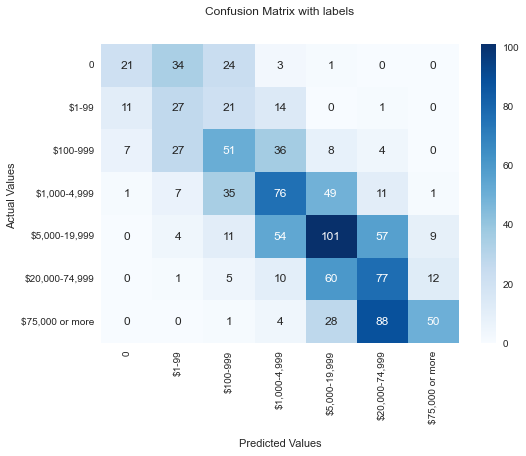

In [251]:
#confusion_matrix
conf_lin_reg= confusion_matrix(target_test, y_pred_linear_regression_round)

ax = sns.heatmap(conf_lin_reg, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.set_xticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
ax.set_yticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

In [252]:
lin_reg_rmse = mean_squared_error(target_test, y_pred_linear_regression_round)**0.5

lin_reg_mae = mean_absolute_error(target_test, y_pred_linear_regression_round)

lin_reg_r2 = r2_score(target_test, y_pred_linear_regression_round)

print('RMSE:',lin_reg_rmse)
print('MAE:',lin_reg_mae)
print('R2:',lin_reg_r2)

RMSE: 1.1005146239918675
MAE: 0.7907869481765835
R2: 0.6200795028170369


In [253]:
lin_reg_f1 = round(f1_score(target_test, y_pred_linear_regression_round, average='weighted'),3)
lin_reg_f1

0.388

In [254]:
linear_coef = pd.DataFrame({'Feature':features_test_full_mice.columns.values.tolist(), 'Coefficient':linear_regression.best_estimator_[1].coef_})

In [255]:
pd.options.display.max_colwidth = 100

In [256]:
linear_coef.sort_values(by='Coefficient').head(20)

,Feature,Coefficient
47,Difficulty_of_covering_monthly_expenses_and_bills,-0.493544
61,Respondent_did_not_select_any_item_in_PRODHAVE_bank,-0.273076
131,13_to_17_years_old,-0.258410
80,Received_a_foreclosure_notice,-0.198908
60,Student_Education_Loan_for_yourself_or_someone_else_,-0.187977
48,Which_one_of_the_following_best_describes_your_housing_situation_,-0.181592
130,7_to_12_years_old,-0.159540
52,What_do_you_owe_on_your_home_today_,-0.137644
79,Work_hours_pay_reduced_or_business_owned_by_self_HH_mem_had_financial_difficulty,-0.136540
122,Government,-0.130088


In [257]:
linear_coef.sort_values(by='Coefficient', ascending=False).head(20)

,Feature,Coefficient
53,Checking_or_Savings_Account_at_a_bank_or_credit_union,0.340961
56,Retirement_Account_such_as_a_401k_or_IRA_,0.334939
86,Received_a_large_sum_of_money_beyond_normal_income,0.303645
58,Non_Retirement_Investments_such_as_stocks_bonds_or_mutual_funds_,0.287598
107,If_you_had_a_choice_would_you_rather_receive_,0.209362
67,Respondent_did_not_select_any_item_in_PRODUSE_bank,0.207100
10,I_know_how_to_make_myself_save,0.195019
65,Used_nonbank_service_for_international_money_transfers,0.190283
87,Had_a_child_start_daycare_or_college,0.179765
24,Paid_off_credit_card_balance_in_full_each_month,0.164985


In [258]:
models_score_regression['Linear_regression'] = lin_reg_f1

### SVM

In [259]:
%%time

#Parameters for GridSearchCV

#C - penalty for each error. Low C is low error and the model more generelized. 0.1 < c < 100

#gamma - used only with rbf and means curvature. Low gamma, more generaliztion. Large gamma,  
#points need to be very close to each other, creates overfitting. 0.0001 < gamma < 10

pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('scaler',StandardScaler()),('model',SVR())])

param_grid = {'model__C': [0.05, 0.1,1],
              'model__gamma': [1, 0.1, 0.01, 0.001],
              'model__kernel': ['rbf']}

svr = best_model_regression(pipe, param_grid, features_train_full_mice, target_train)

Fitting 5 folds for each of 12 candidates, totalling 60 fits
[CV 1/5] END model__C=0.05, model__gamma=1, model__kernel=rbf;, score=(train=-1.499, test=-1.487) total time=   3.5s
[CV 2/5] END model__C=0.05, model__gamma=1, model__kernel=rbf;, score=(train=-1.477, test=-1.578) total time=   3.7s
[CV 3/5] END model__C=0.05, model__gamma=1, model__kernel=rbf;, score=(train=-1.484, test=-1.549) total time=   3.5s
[CV 4/5] END model__C=0.05, model__gamma=1, model__kernel=rbf;, score=(train=-1.484, test=-1.552) total time=   4.0s
[CV 5/5] END model__C=0.05, model__gamma=1, model__kernel=rbf;, score=(train=-1.481, test=-1.569) total time=   3.4s
[CV 1/5] END model__C=0.05, model__gamma=0.1, model__kernel=rbf;, score=(train=-1.500, test=-1.487) total time=   3.3s
[CV 2/5] END model__C=0.05, model__gamma=0.1, model__kernel=rbf;, score=(train=-1.478, test=-1.578) total time=   3.5s
[CV 3/5] END model__C=0.05, model__gamma=0.1, model__kernel=rbf;, score=(train=-1.485, test=-1.549) total time=   3.

In [260]:
y_pred_svr = svr.predict(features_test_full_mice)

#Create a copy
y_pred_svr_round = np.round(y_pred_svr)

#Make 0 prediction to 1
for i in range(0,len(y_pred_svr_round)):
    if y_pred_svr_round[i]==0:
        y_pred_svr_round[i] = 1
    elif y_pred_svr_round[i]==8:
        y_pred_svr_round[i] = 7
        
print(classification_report(target_test, y_pred_svr_round, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.57      0.30      0.39        83
          $1-99       0.28      0.41      0.33        74
       $100-999       0.36      0.44      0.40       133
   $1,000-4,999       0.39      0.38      0.39       180
  $5,000-19,999       0.38      0.36      0.37       236
 $20,000-74,999       0.32      0.48      0.39       165
$75,000 or more       0.72      0.36      0.48       171

       accuracy                           0.39      1042
      macro avg       0.43      0.39      0.39      1042
   weighted avg       0.44      0.39      0.40      1042



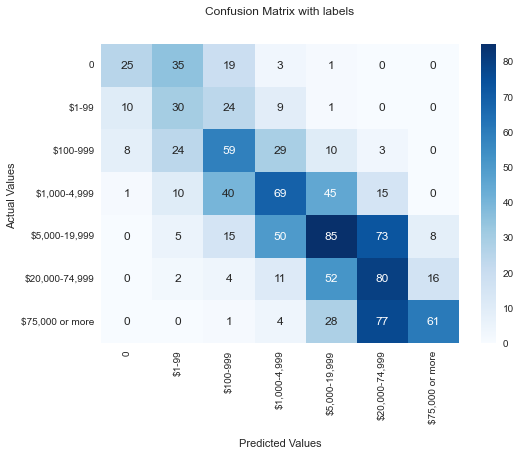

In [261]:
#confusion_matrix
conf_svr= confusion_matrix(target_test, y_pred_svr_round)

ax = sns.heatmap(conf_svr, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.set_xticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
ax.set_yticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

In [262]:
svr_rmse = mean_squared_error(target_test, y_pred_svr_round)**0.5

svr_mae = mean_absolute_error(target_test, y_pred_svr_round)

svr_r2 = r2_score(target_test, y_pred_svr_round)

print('RMSE:',svr_rmse)
print('MAE:',svr_mae)
print('R2:',svr_r2)

RMSE: 1.099642238104474
MAE: 0.7869481765834933
R2: 0.6206815955225566


In [263]:
svr_f1 = round(f1_score(target_test, y_pred_svr_round, average='weighted'),3)
svr_f1

0.397

In [264]:
models_score_regression['SVR'] = svr_f1

### Explore differences

In [265]:
check_table = pd.DataFrame({'target_test': target_test, 'y_pred':y_pred_svr}, index=target_test.index).reset_index()

check_table.head()

,index,target_test,y_pred
0,3259,7.0,6.578727
1,1015,6.0,6.067446
2,1422,7.0,6.642321
3,2550,4.0,3.253910
4,4469,2.0,3.496292


In [266]:
#Add Diff columns with the % differences
check_table['diff'] = round(1-check_table['target_test']/check_table['y_pred'],4)*100

check_table.head()

,index,target_test,y_pred,diff
0,3259,7.0,6.578727,-6.40
1,1015,6.0,6.067446,1.11
2,1422,7.0,6.642321,-5.38
3,2550,4.0,3.253910,-22.93
4,4469,2.0,3.496292,42.80


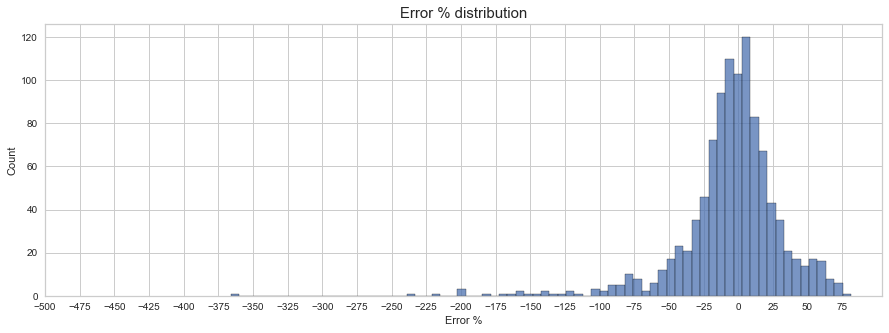

In [267]:
fig, axs = plt.subplots(figsize=(15, 5))
axs = sns.histplot(data = check_table['diff'])
plt.title('Error % distribution', size=15)
plt.xlabel('Error %')
plt.xticks(range(-500, 100, 25))
plt.show()

The distribution of the error seems normal with outliers at the lower end. What we learn form here is that most of the errors are up to 1 class aboove or below, which is good. but some outliers are very far away from the original class.

In [268]:
#see the mistake
check_table[(check_table['target_test']==7) & (np.round(check_table['y_pred'])==3)]

,index,target_test,y_pred,diff
842,3573,7.0,2.942709,-137.88


### LIME

In [269]:
# Get the class names
class_names = ['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more']

# Get the feature names
feature_names = list(features_test_full_mice.columns)

# Fit the Explainer on the training data set using the LimeTabularExplainer 
lime_explainer = LimeTabularExplainer(features_test_full_mice.values, feature_names = feature_names, 
                                 class_names = class_names, mode = 'regression')

### Single instance - target 7, prediction 3

In [270]:
#Perform the explanation on the 8th instance in the test data
explaination = lime_explainer.explain_instance(features_test_full_mice.iloc[842], svr.best_estimator_[2].predict)

# show the result of the model's explaination
explaination.show_in_notebook(show_table = True, show_all = False)

### Ridge

In [271]:
%%time

#Parameters for GridSearchCV

pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('scaler',StandardScaler()),('model',Ridge())])

param_grid = {'model__alpha': [0.1, 0.5, 0.8]}

ridge = best_model_regression(pipe, param_grid, features_train_full_mice, target_train)

Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END model__alpha=0.1;, score=(train=-0.842, test=-0.890) total time=   0.1s
[CV 2/5] END model__alpha=0.1;, score=(train=-0.842, test=-0.880) total time=   0.1s
[CV 3/5] END model__alpha=0.1;, score=(train=-0.850, test=-0.872) total time=   0.1s
[CV 4/5] END model__alpha=0.1;, score=(train=-0.836, test=-0.903) total time=   0.1s
[CV 5/5] END model__alpha=0.1;, score=(train=-0.835, test=-0.880) total time=   0.1s
[CV 1/5] END model__alpha=0.5;, score=(train=-0.842, test=-0.890) total time=   0.1s
[CV 2/5] END model__alpha=0.5;, score=(train=-0.842, test=-0.880) total time=   0.1s
[CV 3/5] END model__alpha=0.5;, score=(train=-0.850, test=-0.872) total time=   0.1s
[CV 4/5] END model__alpha=0.5;, score=(train=-0.836, test=-0.903) total time=   0.1s
[CV 5/5] END model__alpha=0.5;, score=(train=-0.835, test=-0.880) total time=   0.1s
[CV 1/5] END model__alpha=0.8;, score=(train=-0.842, test=-0.890) total time=   0.1s
[CV 2

In [272]:
y_pred_ridge = ridge.predict(features_test_full_mice)

#Create a copy
y_pred_ridge_round = np.round(y_pred_ridge)

#Make 0 prediction to 1
for i in range(0,len(y_pred_ridge_round)):
    if y_pred_ridge_round[i]==0:
        y_pred_ridge_round[i] = 1
    elif y_pred_ridge_round[i]==8:
        y_pred_ridge_round[i] = 7
        
print(classification_report(target_test, y_pred_ridge_round, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.53      0.25      0.34        83
          $1-99       0.27      0.36      0.31        74
       $100-999       0.34      0.38      0.36       133
   $1,000-4,999       0.39      0.42      0.40       180
  $5,000-19,999       0.41      0.43      0.42       236
 $20,000-74,999       0.32      0.47      0.38       165
$75,000 or more       0.69      0.29      0.40       171

       accuracy                           0.39      1042
      macro avg       0.42      0.37      0.37      1042
   weighted avg       0.43      0.39      0.39      1042



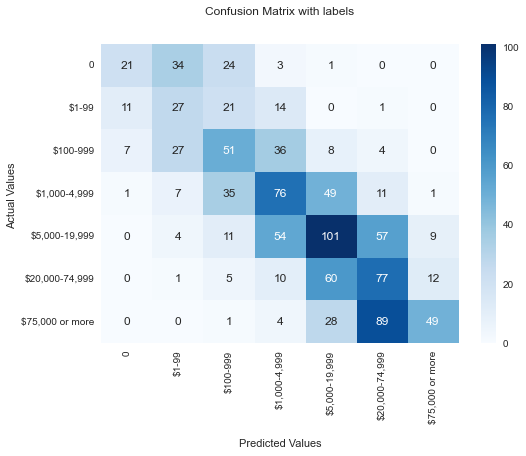

In [273]:
#confusion_matrix
conf_ridge= confusion_matrix(target_test, y_pred_ridge_round)

ax = sns.heatmap(conf_ridge, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.set_xticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
ax.set_yticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

In [274]:
ridge_rmse = mean_squared_error(target_test, y_pred_ridge_round)**0.5

ridge_mae = mean_absolute_error(target_test, y_pred_ridge_round)

ridge_r2 = r2_score(target_test, y_pred_ridge_round)

print('RMSE:',ridge_rmse)
print('MAE:',ridge_mae)
print('R2:',ridge_r2)

RMSE: 1.1009505577083079
MAE: 0.791746641074856
R2: 0.619778456464277


In [275]:
ridge_f1 = round(f1_score(target_test, y_pred_ridge_round, average='weighted'),3)
ridge_f1

0.387

In [276]:
models_score_regression['Ridge'] = ridge_f1

### Lasso

In [277]:
%%time

#Parameters for GridSearchCV

pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('scaler',StandardScaler()),('model',Lasso())])

param_grid = {'model__alpha': [0.01, 0.05, 0.1, 0.5, 0.8]}

lasso = best_model_regression(pipe, param_grid, features_train_full_mice, target_train)

Fitting 5 folds for each of 5 candidates, totalling 25 fits
[CV 1/5] END model__alpha=0.01;, score=(train=-0.847, test=-0.875) total time=   0.1s
[CV 2/5] END model__alpha=0.01;, score=(train=-0.844, test=-0.874) total time=   0.1s
[CV 3/5] END model__alpha=0.01;, score=(train=-0.853, test=-0.857) total time=   0.1s
[CV 4/5] END model__alpha=0.01;, score=(train=-0.839, test=-0.891) total time=   0.1s
[CV 5/5] END model__alpha=0.01;, score=(train=-0.841, test=-0.870) total time=   0.1s
[CV 1/5] END model__alpha=0.05;, score=(train=-0.883, test=-0.887) total time=   0.1s
[CV 2/5] END model__alpha=0.05;, score=(train=-0.876, test=-0.898) total time=   0.1s
[CV 3/5] END model__alpha=0.05;, score=(train=-0.883, test=-0.869) total time=   0.1s
[CV 4/5] END model__alpha=0.05;, score=(train=-0.870, test=-0.888) total time=   0.1s
[CV 5/5] END model__alpha=0.05;, score=(train=-0.870, test=-0.893) total time=   0.1s
[CV 1/5] END model__alpha=0.1;, score=(train=-0.902, test=-0.902) total time=   

In [278]:
y_pred_lasso = lasso.predict(features_test_full_mice)

#Create a copy
y_pred_lasso_round = np.round(y_pred_lasso)

#Make 0 prediction to 1
for i in range(0,len(y_pred_lasso_round)):
    if y_pred_lasso_round[i]==0:
        y_pred_lasso_round[i] = 1
    elif y_pred_lasso_round[i]==8:
        y_pred_lasso_round[i] = 7
        
print(classification_report(target_test, y_pred_lasso_round, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.61      0.24      0.34        83
          $1-99       0.29      0.42      0.34        74
       $100-999       0.34      0.38      0.35       133
   $1,000-4,999       0.39      0.42      0.41       180
  $5,000-19,999       0.39      0.42      0.40       236
 $20,000-74,999       0.31      0.48      0.38       165
$75,000 or more       0.73      0.26      0.38       171

       accuracy                           0.38      1042
      macro avg       0.44      0.37      0.37      1042
   weighted avg       0.44      0.38      0.38      1042



In [279]:
lasso_rmse = mean_squared_error(target_test, y_pred_lasso_round)**0.5

lasso_mae = mean_absolute_error(target_test, y_pred_lasso_round)

lasso_r2 = r2_score(target_test, y_pred_lasso_round)

print('RMSE:',lasso_rmse)
print('MAE:',lasso_mae)
print('R2:',lasso_r2)

RMSE: 1.0899999119547763
MAE: 0.7888675623800384
R2: 0.627304615283274


In [280]:
lasso_f1 = round(f1_score(target_test, y_pred_lasso_round, average='weighted'),3)
lasso_f1

0.382

In [281]:
models_score_regression['Lasso'] = lasso_f1

### Random Forest

In [282]:
%%time
# n_estimators - This is the number of trees
# max_depth - The maximum depth of the tree. Need to restriced to avoid overfitting
pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('model',RandomForestRegressor(random_state=12345))])

rf_regression = best_model_regression(pipe, {'model__n_estimators' : [30, 50],
                        'model__max_depth' : [5,8,10]}, features_train_full_mice, target_train)

Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END model__max_depth=5, model__n_estimators=30;, score=(train=-0.885, test=-0.964) total time=   1.2s
[CV 2/5] END model__max_depth=5, model__n_estimators=30;, score=(train=-0.891, test=-0.980) total time=   1.1s
[CV 3/5] END model__max_depth=5, model__n_estimators=30;, score=(train=-0.899, test=-0.929) total time=   1.1s
[CV 4/5] END model__max_depth=5, model__n_estimators=30;, score=(train=-0.892, test=-0.961) total time=   1.0s
[CV 5/5] END model__max_depth=5, model__n_estimators=30;, score=(train=-0.877, test=-0.967) total time=   1.0s
[CV 1/5] END model__max_depth=5, model__n_estimators=50;, score=(train=-0.884, test=-0.963) total time=   1.7s
[CV 2/5] END model__max_depth=5, model__n_estimators=50;, score=(train=-0.892, test=-0.980) total time=   2.6s
[CV 3/5] END model__max_depth=5, model__n_estimators=50;, score=(train=-0.900, test=-0.929) total time=   3.2s
[CV 4/5] END model__max_depth=5, model__n_estimators

In [284]:
y_pred_rf_regression = rf_regression.predict(features_test_full_mice)

#Create a copy
y_pred_rf_regression_round = y_pred_rf_regression

for i in range(0,len(y_pred_rf_regression)):
    if y_pred_rf_regression[i]>3:
        y_pred_rf_regression_round[i] = np.ceil(y_pred_rf_regression[i])
    else:
        y_pred_rf_regression_round[i] = np.round(y_pred_rf_regression[i])

#Make 0 prediction to 1
for i in range(0,len(y_pred_rf_regression_round)):
    if y_pred_rf_regression_round[i]==0:
        y_pred_rf_regression_round[i] = 1
    elif y_pred_rf_regression_round[i]==8:
        y_pred_rf_regression_round[i] = 7
        
print(classification_report(target_test, y_pred_rf_regression_round, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

                 precision    recall  f1-score   support

              0       0.74      0.17      0.27        83
          $1-99       0.27      0.36      0.31        74
       $100-999       0.32      0.19      0.24       133
   $1,000-4,999       0.34      0.34      0.34       180
  $5,000-19,999       0.41      0.32      0.36       236
 $20,000-74,999       0.28      0.50      0.36       165
$75,000 or more       0.52      0.56      0.54       171

       accuracy                           0.37      1042
      macro avg       0.41      0.35      0.35      1042
   weighted avg       0.40      0.37      0.36      1042



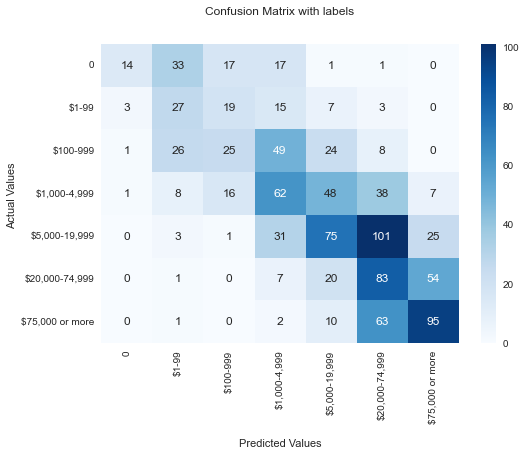

In [285]:
#confusion_matrix
conf_rf_regression= confusion_matrix(target_test, y_pred_rf_regression_round)

ax = sns.heatmap(conf_rf_regression, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.set_xticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
ax.set_yticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

In [286]:
rf_reg_rmse = mean_squared_error(target_test, y_pred_rf_regression_round)**0.5

rf_reg_mae = mean_absolute_error(target_test, y_pred_rf_regression_round)

rf_reg_r2 = r2_score(target_test, y_pred_rf_regression_round)

print('RMSE:',rf_reg_rmse)
print('MAE:',rf_reg_mae)
print('R2:',rf_reg_r2)

RMSE: 1.232166451851039
MAE: 0.8829174664107485
R2: 0.5237446699338767


In [287]:
rf_reg_f1 = round(f1_score(target_test, y_pred_rf_regression_round, average='weighted'),3)
rf_reg_f1

0.359

In [288]:
models_score_regression['Random_forest'] = rf_reg_f1

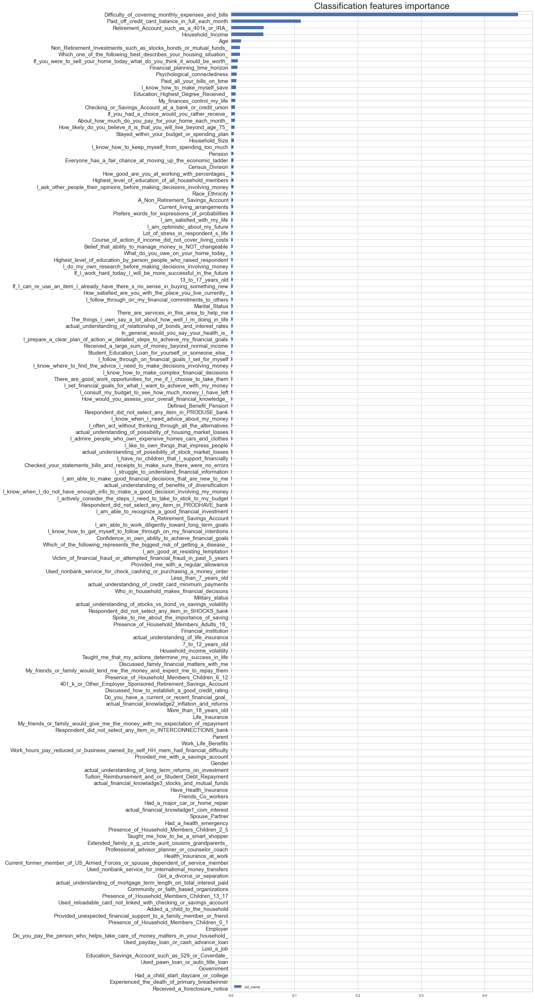

In [289]:
feature_importance_rf_regression = pd.DataFrame({'col_name': rf_regression.best_estimator_[1].feature_importances_}, index=features_train_full_mice.columns).sort_values(by='col_name', ascending=False)

fig, ax = plt.subplots(figsize =(15, 50))
feature_importance_rf_regression.sort_values(by='col_name',ascending=True).plot(kind='barh', ax=ax)
plt.title('Classification features importance', size=25)
ax.tick_params(axis='y', labelsize=15)
plt.show()

### LightGBM

In [ ]:
%%time
# n_estimators - This is the number of trees
# max_depth - The maximum depth of the tree. Need to restriced to avoid overfitting
pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('model',LGBMRegressor(random_state=12345))])

lgbm_reg = best_model_regression(pipe, {'model__n_estimators' : [20, 40],
                        'model__max_depth' : [5,8],
                      'model__learning_rate':[0.001, 0.01, 0.1]}, features_train_full_mice, target_train)

In [ ]:
y_pred_lgbm_reg = lgbm_reg.predict(features_test_full_mice)

#Create a copy
y_pred_lgbm_reg_round = np.round(y_pred_lgbm_reg)

#Make 0 prediction to 1
for i in range(0,len(y_pred_lgbm_reg_round)):
    if y_pred_lgbm_reg_round[i]==0:
        y_pred_lgbm_reg_round[i] = 1
    elif y_pred_lgbm_reg_round[i]==8:
        y_pred_lgbm_reg_round[i] = 7
        
print(classification_report(target_test, y_pred_lgbm_reg_round, target_names=['0','$1-99','$100-999','$1,000-4,999',
                                                               '$5,000-19,999','$20,000-74,999','$75,000 or more']))

In [ ]:
#confusion_matrix
conf_lgbm_reg= confusion_matrix(target_test, y_pred_lgbm_reg_round)

ax = sns.heatmap(conf_lgbm_reg, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.set_xticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
ax.set_yticklabels(['0','$1-99','$100-999','$1,000-4,999','$5,000-19,999','$20,000-74,999','$75,000 or more'])
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

In [ ]:
lgbm_reg_rmse = mean_squared_error(target_test, y_pred_lgbm_reg_round)**0.5

lgbm_reg_mae = mean_absolute_error(target_test, y_pred_lgbm_reg_round)

lgbm_reg_r2 = r2_score(target_test, y_pred_lgbm_reg_round)

print('RMSE:',lgbm_reg_rmse)
print('MAE:',lgbm_reg_mae)
print('R2:',lgbm_reg_r2)

In [ ]:
lgbm_reg_f1 = round(f1_score(target_test, y_pred_lgbm_reg_round, average='weighted'),3)
lgbm_reg_f1

In [ ]:
models_score_regression['LightGBM'] = lgbm_reg_f1

## Results - regression 7 classes

In [294]:
pd.DataFrame.from_dict(models_score_regression, orient='index', columns=['Test F1 weighted']).sort_values(by='Test F1 weighted', ascending=False)

,Test F1 weighted
SVR,0.397
Linear_regression,0.388
Ridge,0.387
Lasso,0.382
Random_forest,0.359


## Regression for 3 classes

### SVR 3 classes

In [295]:
%%time

#Parameters for GridSearchCV

#C - penalty for each error. Low C is low error and the model more generelized. 0.1 < c < 100

#gamma - used only with rbf and means curvature. Low gamma, more generaliztion. Large gamma,  
#points need to be very close to each other, creates overfitting. 0.0001 < gamma < 10

pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('scaler',StandardScaler()),('model',SVR())])

param_grid = {'model__C': [0.05, 0.1,1],
              'model__gamma': [1, 0.1, 0.01, 0.001],
              'model__kernel': ['rbf']}

svr_3 = best_model_regression(pipe, param_grid, features_train_full_mice, target_train_3)

Fitting 5 folds for each of 12 candidates, totalling 60 fits
[CV 1/5] END model__C=0.05, model__gamma=1, model__kernel=rbf;, score=(train=-0.578, test=-0.606) total time=   2.2s
[CV 2/5] END model__C=0.05, model__gamma=1, model__kernel=rbf;, score=(train=-0.574, test=-0.620) total time=   2.1s
[CV 3/5] END model__C=0.05, model__gamma=1, model__kernel=rbf;, score=(train=-0.572, test=-0.626) total time=   2.7s
[CV 4/5] END model__C=0.05, model__gamma=1, model__kernel=rbf;, score=(train=-0.574, test=-0.621) total time=   2.1s
[CV 5/5] END model__C=0.05, model__gamma=1, model__kernel=rbf;, score=(train=-0.580, test=-0.599) total time=   1.9s
[CV 1/5] END model__C=0.05, model__gamma=0.1, model__kernel=rbf;, score=(train=-0.578, test=-0.606) total time=   1.9s
[CV 2/5] END model__C=0.05, model__gamma=0.1, model__kernel=rbf;, score=(train=-0.574, test=-0.620) total time=   2.2s
[CV 3/5] END model__C=0.05, model__gamma=0.1, model__kernel=rbf;, score=(train=-0.573, test=-0.626) total time=   2.

In [296]:
y_pred_svr_3 = svr_3.predict(features_test_full_mice)

#Create a copy
y_pred_svr_3_round = np.round(y_pred_svr_3)

#Make 0 prediction to 1
for i in range(0,len(y_pred_svr_3_round)):
    if y_pred_svr_3_round[i]==0:
        y_pred_svr_3_round[i] = 1
    elif y_pred_svr_3_round[i]==4:
        y_pred_svr_3_round[i] = 3
        
print(classification_report(target_test_3, y_pred_svr_3_round, target_names=['Low','Mid','High']))

              precision    recall  f1-score   support

         Low       0.78      0.65      0.71       290
         Mid       0.59      0.66      0.63       416
        High       0.72      0.72      0.72       336

    accuracy                           0.68      1042
   macro avg       0.70      0.68      0.68      1042
weighted avg       0.68      0.68      0.68      1042



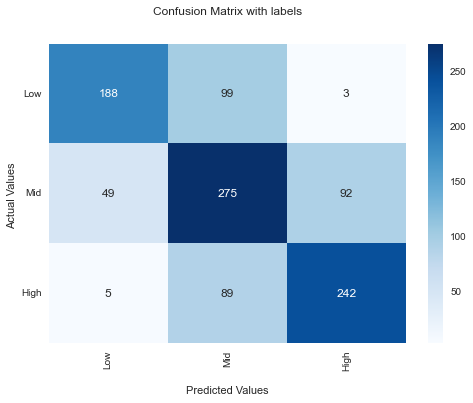

In [297]:
#confusion_matrix
conf_svr_3= confusion_matrix(target_test_3, y_pred_svr_3_round)

ax = sns.heatmap(conf_svr_3, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.set_xticklabels(['Low','Mid','High'])
ax.set_yticklabels(['Low','Mid','High'])
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

In [298]:
svr_3_rmse = mean_squared_error(target_test_3, y_pred_svr_3_round)**0.5

svr_3_mae = mean_absolute_error(target_test_3, y_pred_svr_3_round)

svr_3_r2 = r2_score(target_test_3, y_pred_svr_3_round)

print('RMSE:',svr_3_rmse)
print('MAE:',svr_3_mae)
print('R2:',svr_3_r2)

RMSE: 0.5885993002683503
MAE: 0.3310940499040307
R2: 0.4214458854217935


### Random forest 3 classes

In [299]:
%%time
# n_estimators - This is the number of trees
# max_depth - The maximum depth of the tree. Need to restriced to avoid overfitting
pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('model',RandomForestRegressor(random_state=12345))])

rf_regression_3 = best_model_regression(pipe, {'model__n_estimators' : [30, 50],
                        'model__max_depth' : [5,8,10]}, features_train_full_mice, target_train_3)

Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END model__max_depth=5, model__n_estimators=30;, score=(train=-0.418, test=-0.460) total time=   0.7s
[CV 2/5] END model__max_depth=5, model__n_estimators=30;, score=(train=-0.422, test=-0.459) total time=   0.7s
[CV 3/5] END model__max_depth=5, model__n_estimators=30;, score=(train=-0.424, test=-0.448) total time=   0.7s
[CV 4/5] END model__max_depth=5, model__n_estimators=30;, score=(train=-0.421, test=-0.454) total time=   0.7s
[CV 5/5] END model__max_depth=5, model__n_estimators=30;, score=(train=-0.424, test=-0.450) total time=   0.7s
[CV 1/5] END model__max_depth=5, model__n_estimators=50;, score=(train=-0.417, test=-0.458) total time=   1.2s
[CV 2/5] END model__max_depth=5, model__n_estimators=50;, score=(train=-0.421, test=-0.459) total time=   1.2s
[CV 3/5] END model__max_depth=5, model__n_estimators=50;, score=(train=-0.423, test=-0.447) total time=   1.4s
[CV 4/5] END model__max_depth=5, model__n_estimators

In [300]:
y_pred_rf_reg_3 = rf_regression_3.predict(features_test_full_mice)

#Create a copy
y_pred_rf_reg_3_round = np.round(y_pred_rf_reg_3)

#Make 0 prediction to 1
for i in range(0,len(y_pred_rf_reg_3_round)):
    if y_pred_rf_reg_3_round[i]==0:
        y_pred_rf_reg_3_round[i] = 1
    elif y_pred_rf_reg_3_round[i]==4:
        y_pred_rf_reg_3_round[i] = 3
        
print(classification_report(target_test_3, y_pred_rf_reg_3_round, target_names=['Low','Mid','High']))

              precision    recall  f1-score   support

         Low       0.81      0.63      0.71       290
         Mid       0.58      0.66      0.62       416
        High       0.69      0.71      0.70       336

    accuracy                           0.67      1042
   macro avg       0.69      0.66      0.67      1042
weighted avg       0.68      0.67      0.67      1042



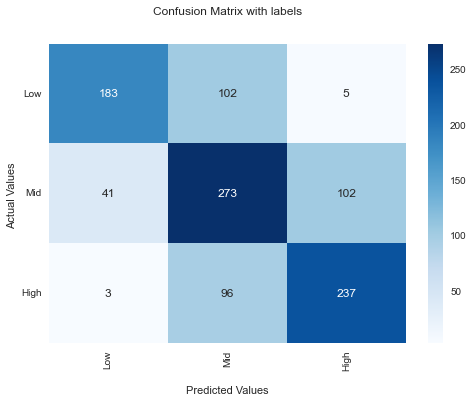

In [301]:
#confusion_matrix
conf_rf_reg_3= confusion_matrix(target_test_3, y_pred_rf_reg_3_round)

ax = sns.heatmap(conf_rf_reg_3, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.set_xticklabels(['Low','Mid','High'])
ax.set_yticklabels(['Low','Mid','High'])
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

### LightGBM 3 classes

In [302]:
%%time
# n_estimators - This is the number of trees
# max_depth - The maximum depth of the tree. Need to restriced to avoid overfitting
pipe = Pipeline([('over',RandomOverSampler(random_state=12345)), ('model',LGBMRegressor(random_state=12345))])

lgbm_reg_3 = best_model_regression(pipe, {'model__n_estimators' : [20, 40],
                        'model__max_depth' : [5,8],
                      'model__learning_rate':[0.001, 0.01, 0.1]}, features_train_full_mice, target_train_3)

Fitting 5 folds for each of 12 candidates, totalling 60 fits
[CV 1/5] END model__learning_rate=0.001, model__max_depth=5, model__n_estimators=20;, score=(train=-0.613, test=-0.603) total time=   0.1s
[CV 2/5] END model__learning_rate=0.001, model__max_depth=5, model__n_estimators=20;, score=(train=-0.609, test=-0.617) total time=   0.0s
[CV 3/5] END model__learning_rate=0.001, model__max_depth=5, model__n_estimators=20;, score=(train=-0.608, test=-0.623) total time=   0.1s
[CV 4/5] END model__learning_rate=0.001, model__max_depth=5, model__n_estimators=20;, score=(train=-0.609, test=-0.618) total time=   0.1s
[CV 5/5] END model__learning_rate=0.001, model__max_depth=5, model__n_estimators=20;, score=(train=-0.614, test=-0.596) total time=   0.1s
[CV 1/5] END model__learning_rate=0.001, model__max_depth=5, model__n_estimators=40;, score=(train=-0.609, test=-0.600) total time=   0.1s
[CV 2/5] END model__learning_rate=0.001, model__max_depth=5, model__n_estimators=40;, score=(train=-0.606

In [303]:
y_pred_lgbm_reg_3 = lgbm_reg_3.predict(features_test_full_mice)

#Create a copy
y_pred_lgbm_reg_3_round = np.round(y_pred_lgbm_reg_3)

#Make 0 prediction to 1
for i in range(0,len(y_pred_lgbm_reg_3_round)):
    if y_pred_lgbm_reg_3_round[i]==0:
        y_pred_lgbm_reg_3_round[i] = 1
    elif y_pred_lgbm_reg_3_round[i]==4:
        y_pred_lgbm_reg_3_round[i] = 3
        
print(classification_report(target_test_3, y_pred_lgbm_reg_3_round, target_names=['Low','Mid','High']))

              precision    recall  f1-score   support

         Low       0.79      0.67      0.72       290
         Mid       0.59      0.65      0.62       416
        High       0.70      0.70      0.70       336

    accuracy                           0.67      1042
   macro avg       0.69      0.67      0.68      1042
weighted avg       0.68      0.67      0.67      1042



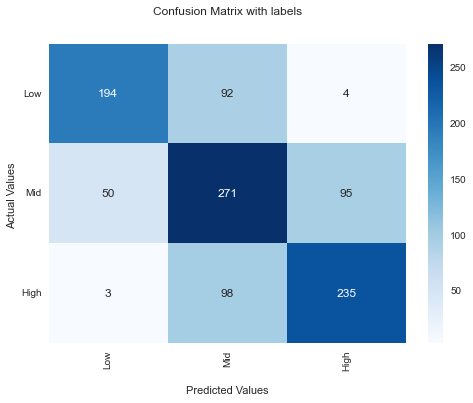

In [304]:
#confusion_matrix
conf_lgbm_reg_3= confusion_matrix(target_test_3, y_pred_lgbm_reg_3_round)

ax = sns.heatmap(conf_lgbm_reg_3, annot=True, cmap='Blues',fmt='g')
ax.set_title('Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
ax.set_xticklabels(['Low','Mid','High'])
ax.set_yticklabels(['Low','Mid','High'])
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

# Conclusions

1. The best prediction for 7 classes recieved with regression methodology, using SVR model, f1 weigted score of 40% (compared to 37% with classifiaction).<br><br>

2. The best prediction for 3 classes recieved using classification methodology, using SVC model, 69% (compared to 68% with regression - SVR).<br><br>

3. We can best explain our results using SHAP of 7 classes using XGBoost model, which recived f1 weighted score of 36.1%.<br><br>